In [1]:
# library(dplyr)

In [2]:
#### feature variant filter for all interaction QTL analyses
# all gene-SNP pairs that are eQTL in at least one cell type, at any day

In [3]:
fvf_filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/feature_variant_filter.tsv"

In [4]:
data_folder = "/nfs/leia/research/stegle/dseaton/hipsci/singlecell_neuroseq/data/analysis_results/20200103_data_freeze/"
leads_filename = paste0(data_folder,"eqtl/pool1_17.eqtl_discovery_all_leads.fdr0.1.tsv")
leads = read.csv(leads_filename, header = T, sep = "\t")
head(leads,2)

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,beta_param,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p,feature_id,global_corr_p_value,label
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<dbl>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<fct>
21_30373541_T_C,2.920966e-25,-0.8525780,0.08210206,1.632719e-14,21,30376705,30391699,173,173,⋯,192.39730,21,30373541,C,1,0.2398844,0.09609073,ENSG00000156253,1.400559e-12,FPP_D11
21_30432557_G_A,1.495486e-48,0.5058675,0.03454695,1.169470e-31,21,30428126,30446118,173,173,⋯,34.96152,21,30432557,A,1,0.1358382,1.00000000,ENSG00000156261,1.059433e-28,FPP_D11


In [5]:
leads[leads$snp_id == "13_21085751_A_T",]

,snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,beta_param,snp_chromosome,snp_position,assessed_allele,call_rate,maf,hwe_p,feature_id,global_corr_p_value,label
,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<dbl>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>,<fct>,<dbl>,<fct>
4037,13_21085751_A_T,5.487963e-11,-0.4436382,0.06765812,7.317054e-06,13,20977806,21099996,172,172,⋯,131.8162,13,21085751,T,1,0.2267442,0.2793206,ENSG00000165475,0.0001125661,P_FPP_D11


In [6]:
fvf_df = leads[,c('snp_id','feature_id')]
colnames(fvf_df)[2] = 'feature'
head(fvf_df)
write.table(fvf_df, fvf_filename, sep = "\t", col.names = T, row.names = F, quote = F)

snp_id,feature
<fct>,<fct>
21_30373541_T_C,ENSG00000156253
21_30432557_G_A,ENSG00000156261
19_46203083_G_A,ENSG00000011478
19_47288150_C_A,ENSG00000105281
19_47174893_A_C,ENSG00000105287
19_46319415_G_C,ENSG00000125755


In [140]:
### get genotypes

In [141]:
snps = matrix(unique(leads$snp_id), nrow = length(unique(leads$snp_id)), ncol = 1)
write.table(snps, "/hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_selection_2020/27Jan_snps.txt", quote = F, row.names = F,col.names = F)

In [142]:
# then, from command line
' java -jar /hps/nobackup/stegle/users/mjbonder/tools/GenotypeHarmonizer-1.4.20-SNAPSHOT/GenotypeHarmonizer.jar -I VCF_Folder -O Table -i /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Full_Filtered/ -o /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/selectionAnna_{date} -sf /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_{date}_samples.txt  -vf /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_{date}_snps.txt'

[1] " java -jar /hps/nobackup/stegle/users/mjbonder/tools/GenotypeHarmonizer-1.4.20-SNAPSHOT/GenotypeHarmonizer.jar -I VCF_Folder -O Table -i /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Full_Filtered/ -o /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/selectionAnna_{date} -sf /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_{date}_samples.txt  -vf /hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_{date}_snps.txt"

In [143]:
##### interaction QTL results

In [144]:
### treatment (D52 only)

In [7]:
## DA
ROT_inter_DA = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/treatment_D52/celltype_DA/treatment_interaction_test_100cellfilter_top_qtl_results_all/top_qtl_results_all.txt"
int_DA = read.csv(ROT_inter_DA,sep="\t")
# head(int_DA,2)
nrow(int_DA)
# length(unique(int_DA$feature_id))
int_DA$q_value = p.adjust(int_DA$p_value, "BH")
nrow(int_DA[int_DA$q_value < 0.05,])
# head(int_DA[order(int_DA$q_value),])

[1] 3354

[1] 92

In [17]:
library(dplyr)


Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



In [42]:
sign_DA_ROT = int_DA[int_DA$q_value < 0.05,]
sign_DA_ROT = sign_DA_ROT[order(abs(sign_DA_ROT$beta),decreasing = T),]
sign_DA_ROT = add_gene_name(sign_DA_ROT,annos)
head(sign_DA_ROT[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/ROT_treatment_interactions/DA_FDR0.05.tsv"
write.table(sign_DA_ROT[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
9_108454343_A_G,ENSG00000095209_TMEM38B
17_27182944_G_A,ENSG00000160602_NEK8


In [19]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/DA_treatment_FDR0.05_egenes.tsv"
write.table(sign_DA_ROT[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

In [247]:
# sign_DA_ROT[order(sign_DA_ROT$q_value),]

In [20]:
# res = sign_DA_ROT[order(sign_DA_ROT$q_value),]
res = sign_DA_ROT[order(abs(sign_DA_ROT$beta),decreasing = T),]
e = e_DA
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:50){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_treatment(gene,snp))
    print(res[i,"beta"])
}

ERROR: Error in eval(expr, envir, enclos): object 'e_DA' not found


In [21]:
# Sert
ROT_inter_Sert = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/treatment_D52/celltype_Sert/treatment_interaction_test_100cellfilter_top_qtl_results_all/top_qtl_results_all.txt"
int_Sert = read.csv(ROT_inter_Sert,sep="\t")
# head(int_Sert,2)
nrow(int_Sert)
# length(unique(int_Sert$feature_id))
int_Sert$q_value = p.adjust(int_Sert$p_value, "BH")
nrow(int_Sert[int_Sert$q_value < 0.05,])
# head(int_Sert[order(int_Sert$q_value),])

[1] 3427

[1] 206

In [22]:
sign_Sert_ROT = int_Sert[int_Sert$q_value < 0.05,]
sign_Sert_ROT = sign_Sert_ROT[order(abs(sign_Sert_ROT$beta), decreasing = T),]
sign_Sert_ROT = add_gene_name(sign_Sert_ROT,annos)
head(sign_Sert_ROT[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/ROT_treatment_interactions/Sert_FDR0.05.tsv"
write.table(sign_Sert_ROT[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
13_52714837_C_A,ENSG00000136098_NEK3
2_190541861_G_T,ENSG00000064933_PMS1


In [23]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Sert_treatment_FDR0.05_egenes.tsv"
write.table(sign_Sert_ROT[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] -1.507194


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 1.234709


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

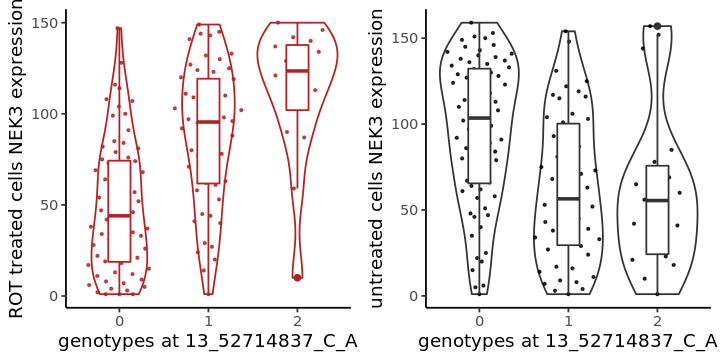

[1] -1.04219


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

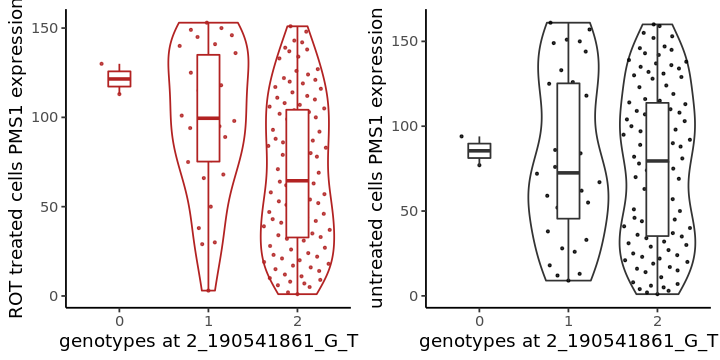

[1] 0.9593585


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

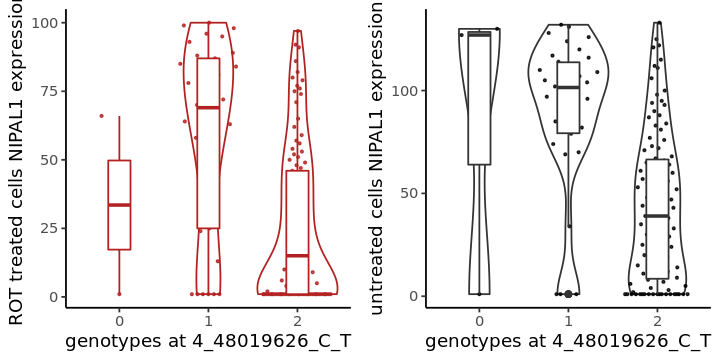

[1] 0.941636


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

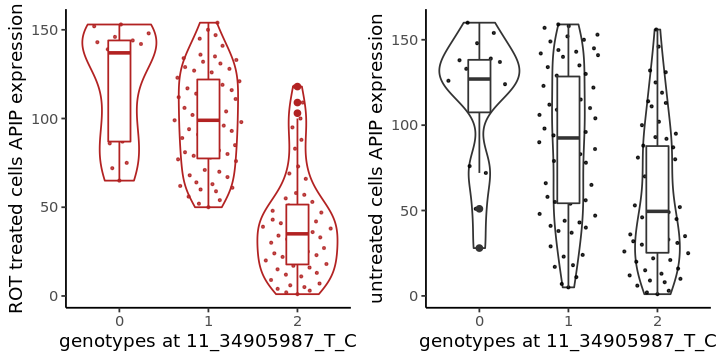

[1] -0.9249171


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

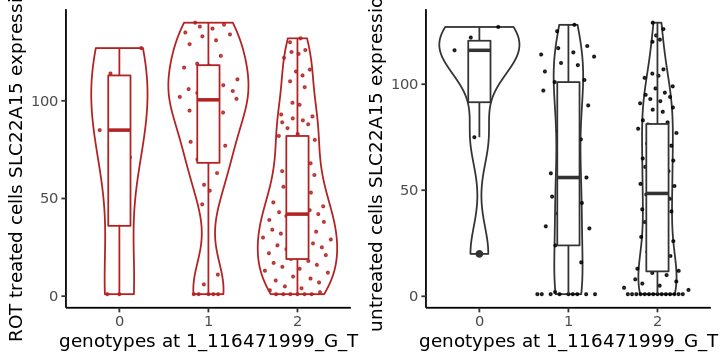

[1] 0.8756337


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

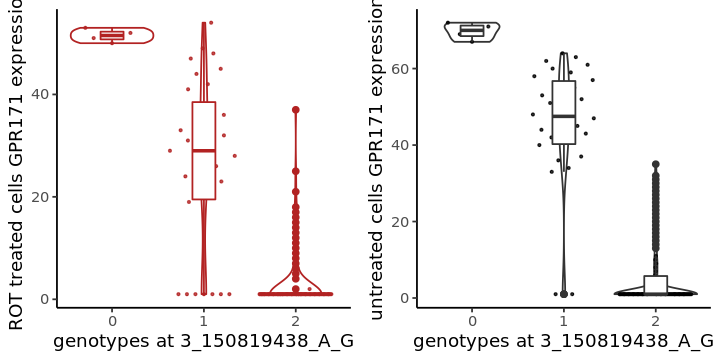

[1] -0.8521862


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

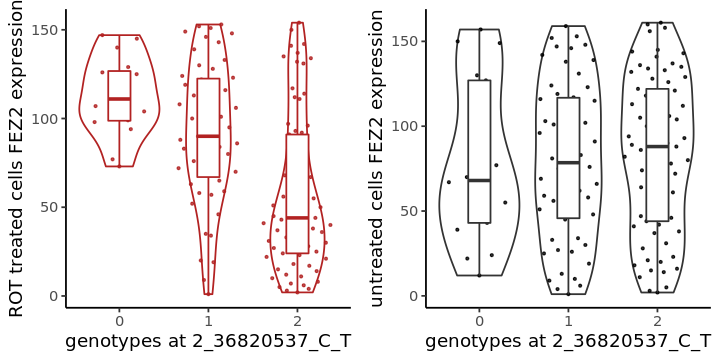

[1] -0.8279607


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

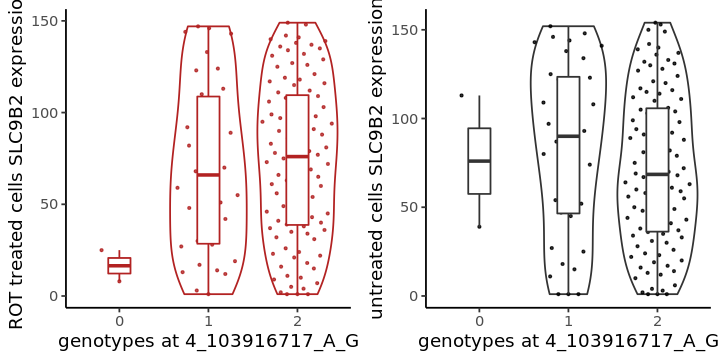

[1] -0.7955654


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

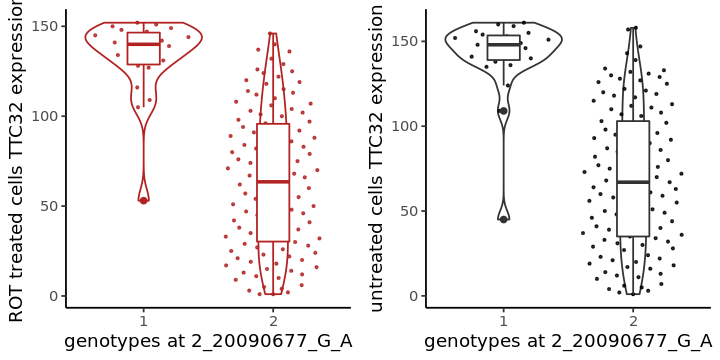

[1] 0.7897268


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

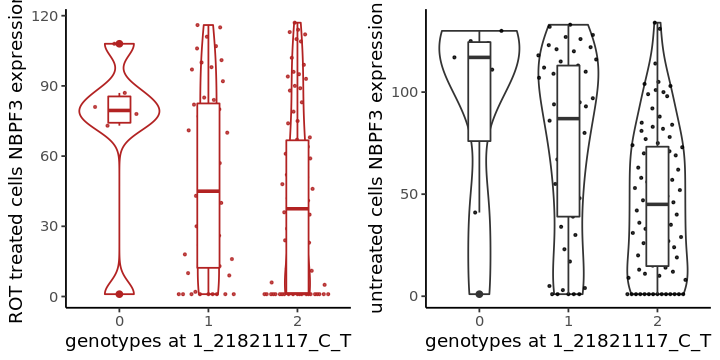

[1] 0.7838307


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

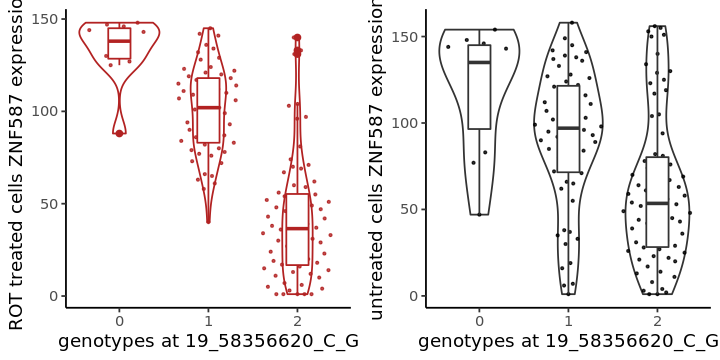

[1] -0.7715304


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

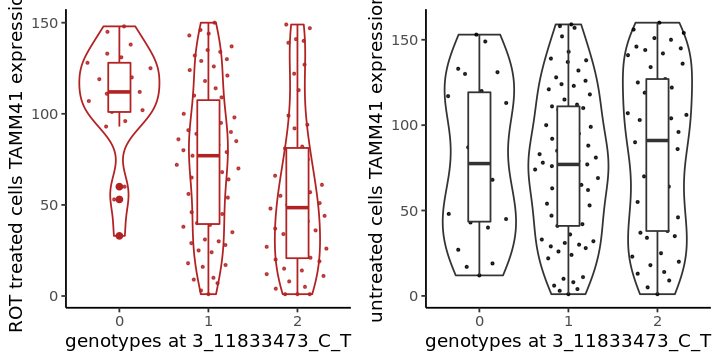

[1] 0.7674315


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

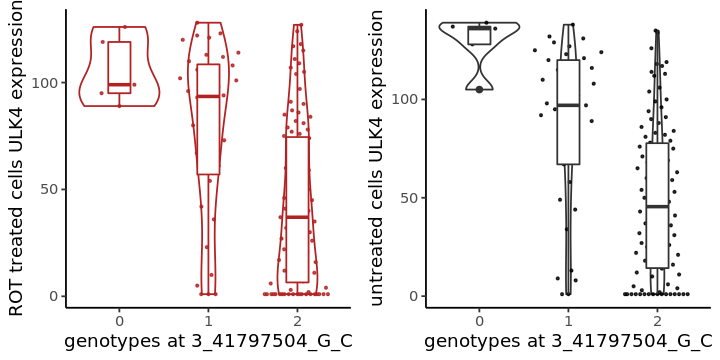

[1] 0.7640466


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

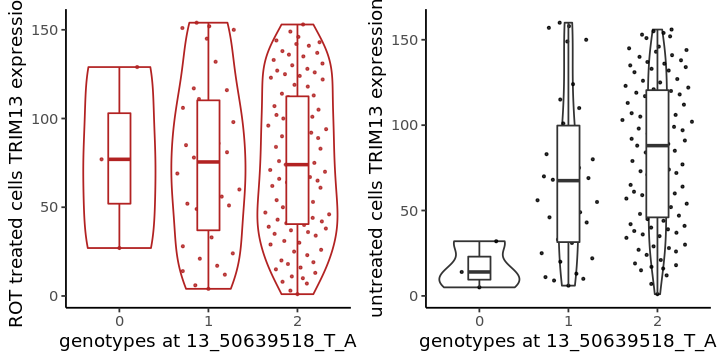

[1] -0.7574975


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

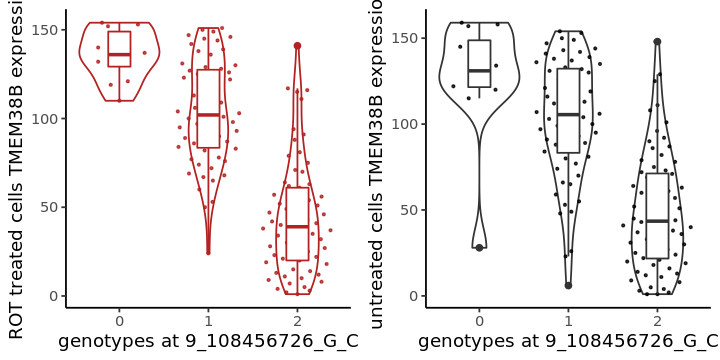

[1] 0.7503062


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

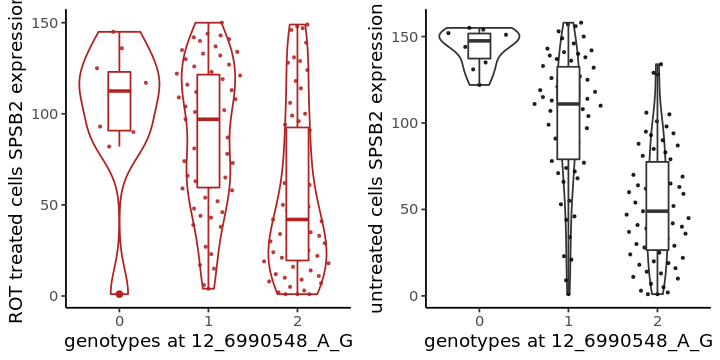

[1] -0.7483472


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

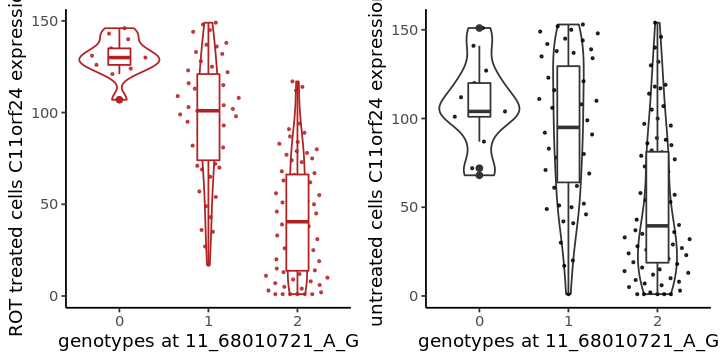

[1] 0.7293712


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

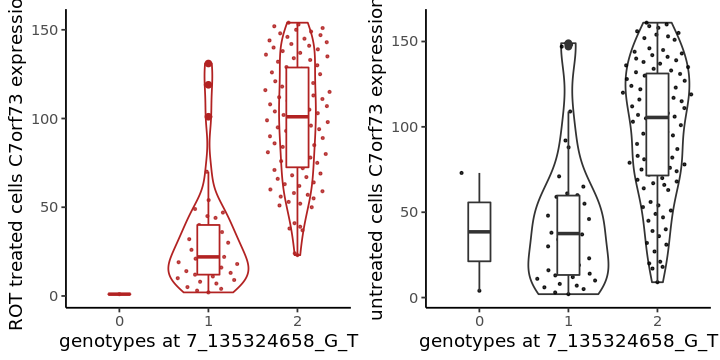

[1] -0.7098725


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

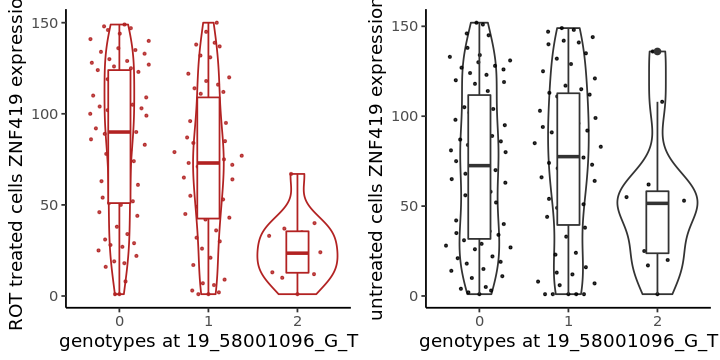

[1] -0.7024758


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

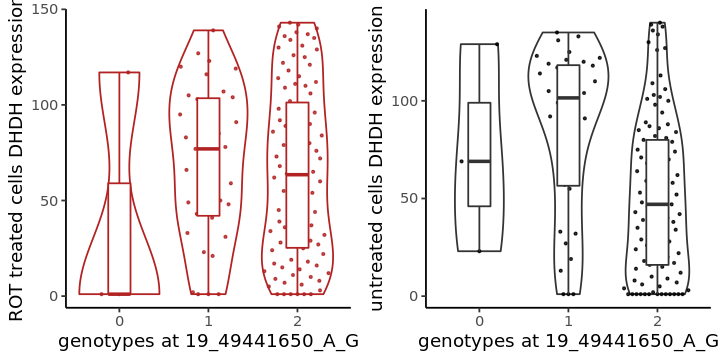

[1] -0.6796382


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

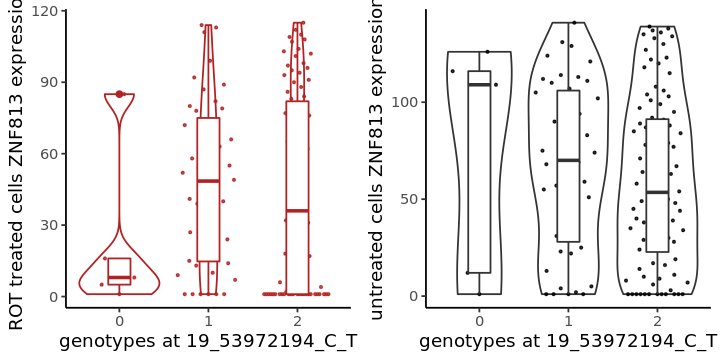

[1] -0.6676994


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

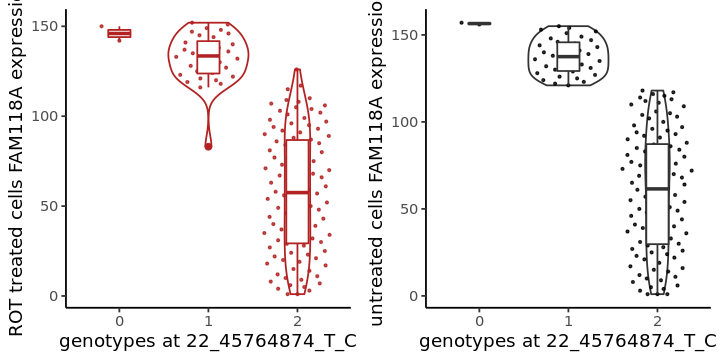

[1] 0.6552051


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

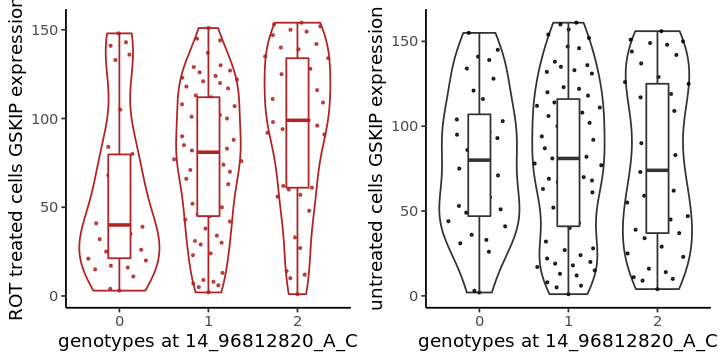

[1] 0.6475779


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

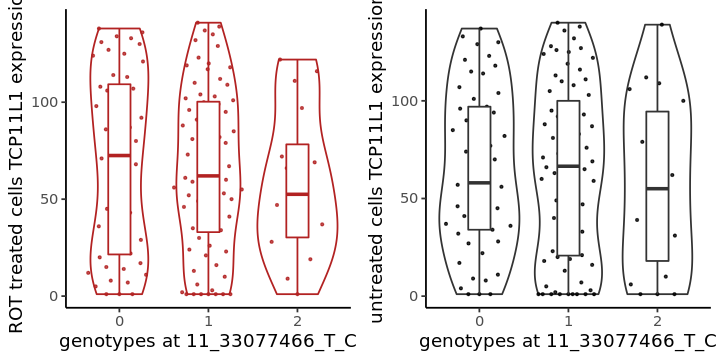

[1] -0.6463052


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

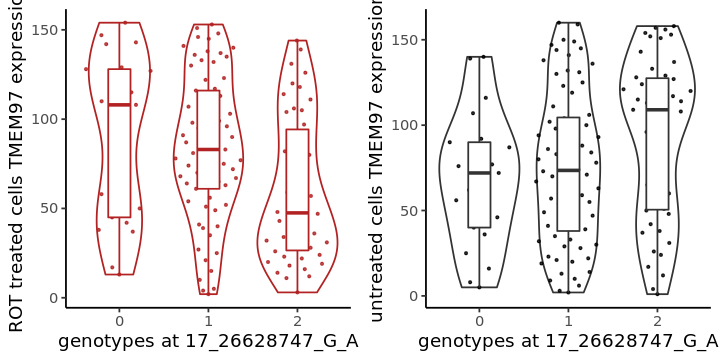

[1] -0.6405713


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

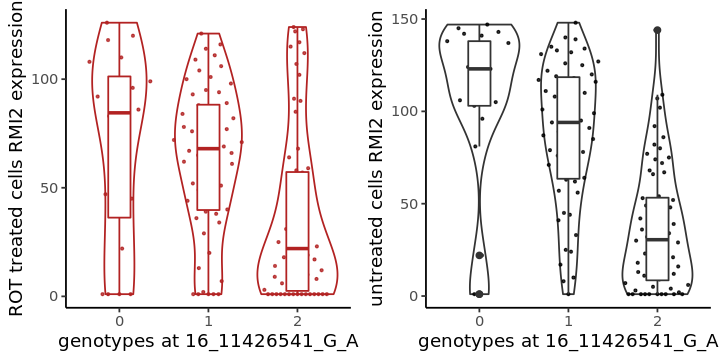

[1] -0.6347903


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

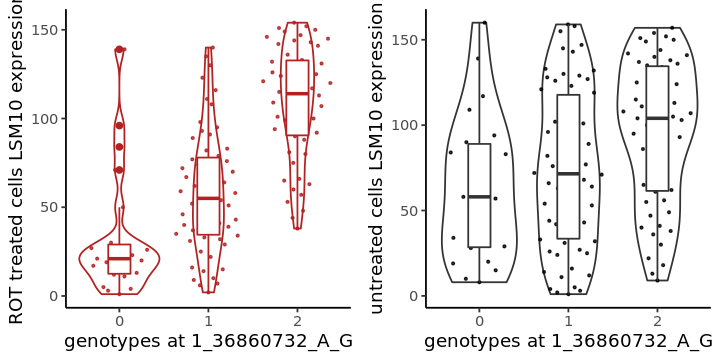

[1] 0.6326715


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

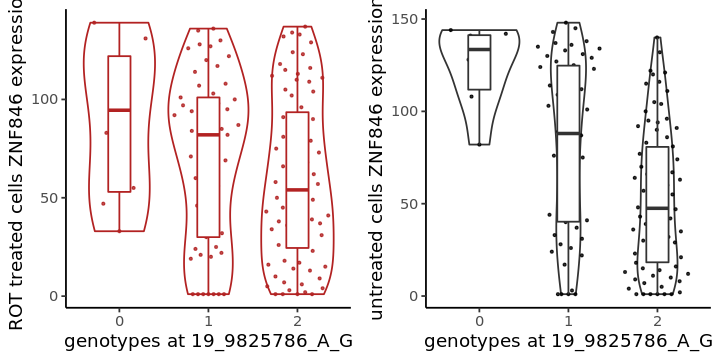

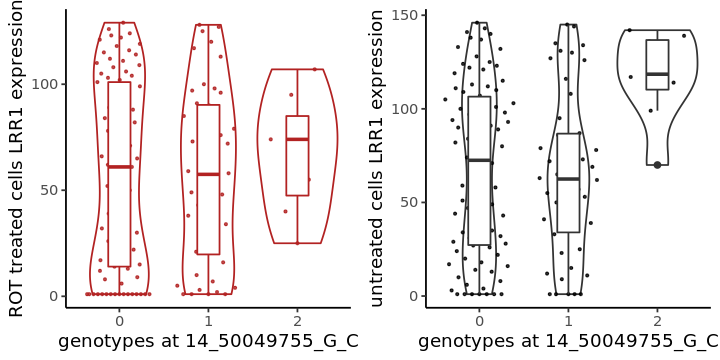

[1] 0.6307016


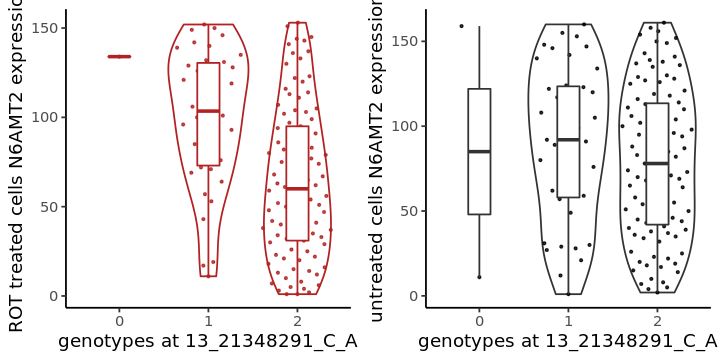

In [248]:
# res = sign_Sert_ROT[order(sign_Sert_ROT$q_value),]
res = sign_Sert_ROT[order(abs(sign_Sert_ROT$beta),decreasing = T),]
e = e_Sert
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:30){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_treatment(gene,snp))
    print(res[i,"beta"])
}

In [24]:
# Epen1
ROT_inter_Epen1 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/treatment_D52/celltype_Epen1/treatment_interaction_test_100cellfilter_top_qtl_results_all/top_qtl_results_all.txt"
int_Epen1 = read.csv(ROT_inter_Epen1,sep="\t")
# head(int_Epen1,2)
nrow(int_Epen1)
# length(unique(int_Epen1$feature_id))
int_Epen1$q_value = p.adjust(int_Epen1$p_value, "BH")
nrow(int_Epen1[int_Epen1$q_value < 0.05,])
# head(int_Epen1[order(int_Epen1$q_value),])

[1] 3442

[1] 132

In [25]:
sign_Epen1_ROT = int_Epen1[int_Epen1$q_value < 0.05,]
sign_Epen1_ROT = sign_Epen1_ROT[order(abs(sign_Epen1_ROT$beta), decreasing = T),]
sign_Epen1_ROT = add_gene_name(sign_Epen1_ROT,annos)
head(sign_Epen1_ROT[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/ROT_treatment_interactions/Epen1_FDR0.05.tsv"
write.table(sign_Epen1_ROT[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
13_52714837_C_A,ENSG00000136098_NEK3
11_34905987_T_C,ENSG00000149089_APIP


In [26]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Epen1_treatment_FDR0.05_egenes.tsv"
write.table(sign_Epen1_ROT[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] -1.468757


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 1.274785


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

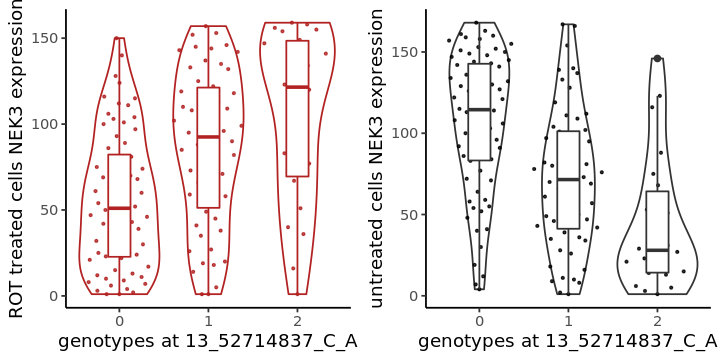

[1] 0.9134266


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

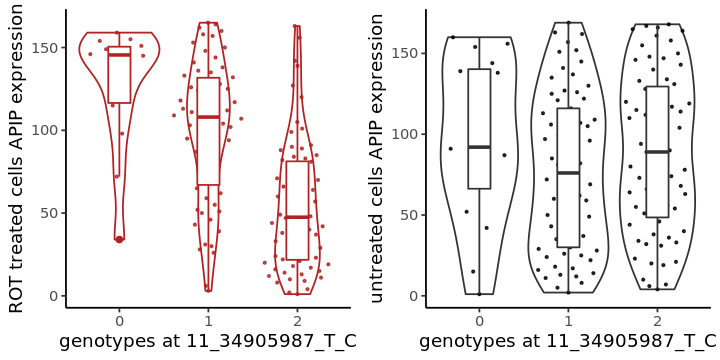

[1] -0.7978317


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

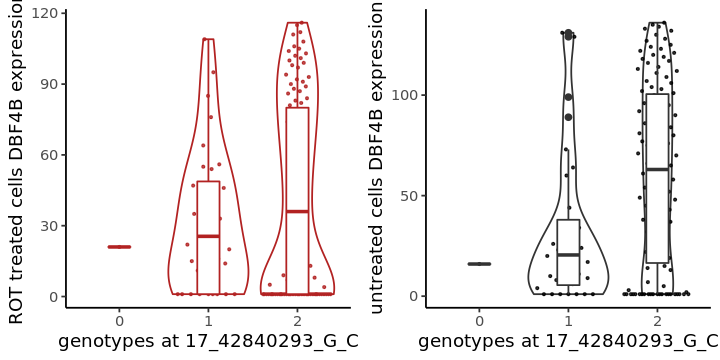

[1] -0.7737577


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

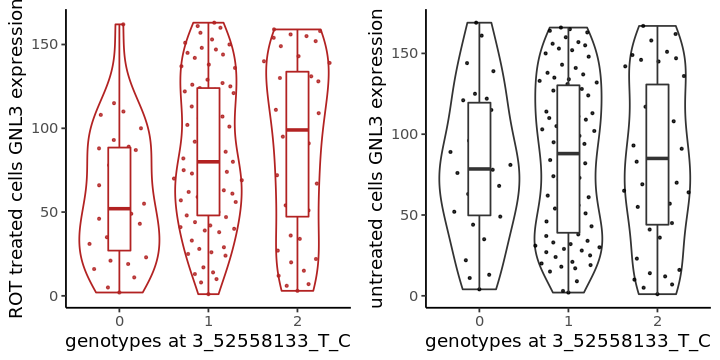

[1] 0.7706865


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

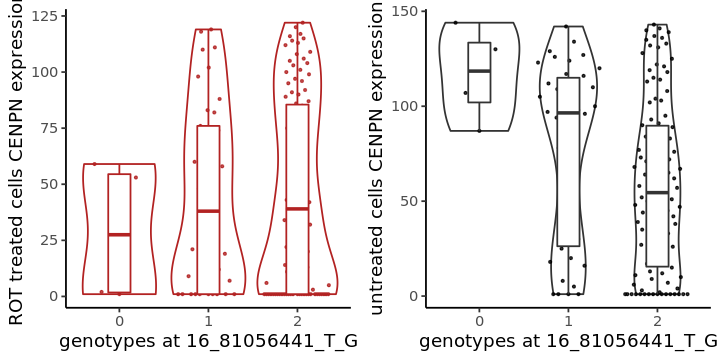

[1] 0.7574084


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

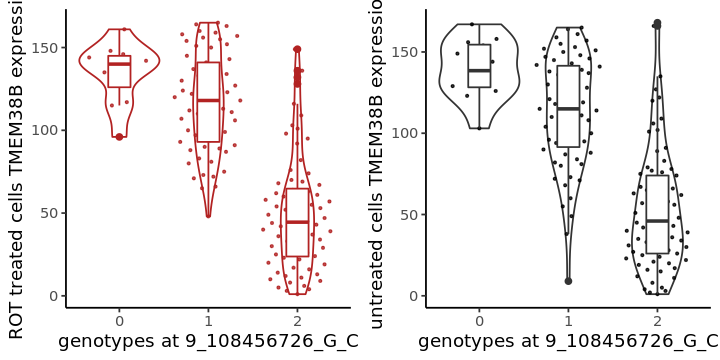

[1] 0.7372932


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

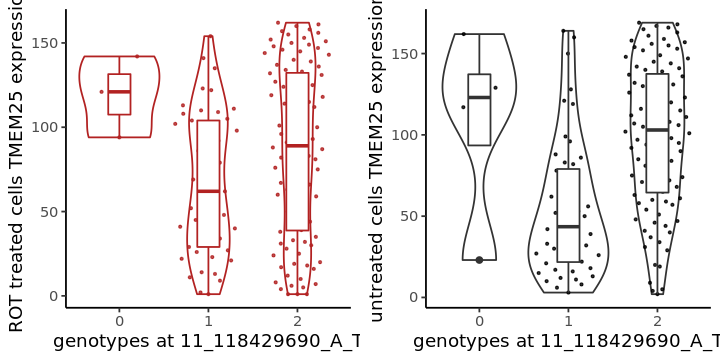

[1] -0.7342579


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

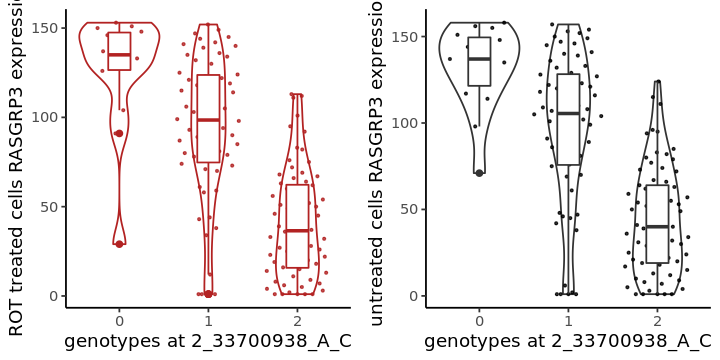

[1] 0.7267537


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

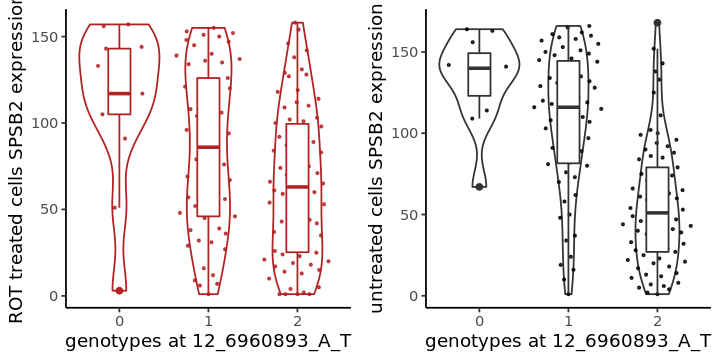

[1] 0.7257173


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

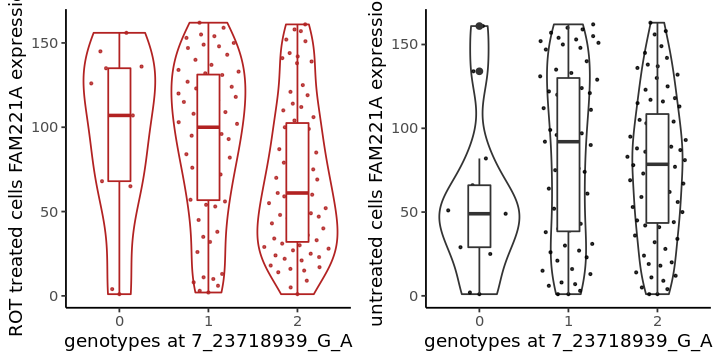

[1] 0.7241029


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

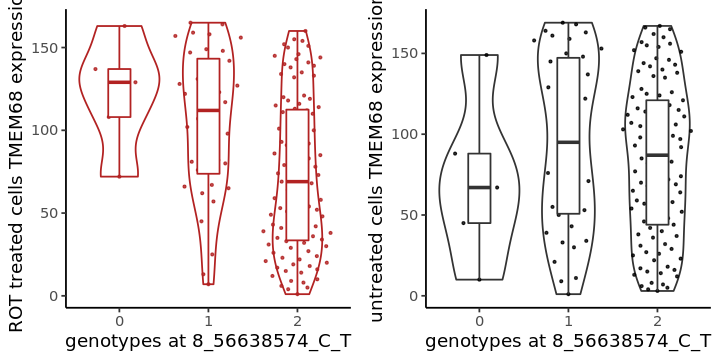

[1] -0.7039821


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

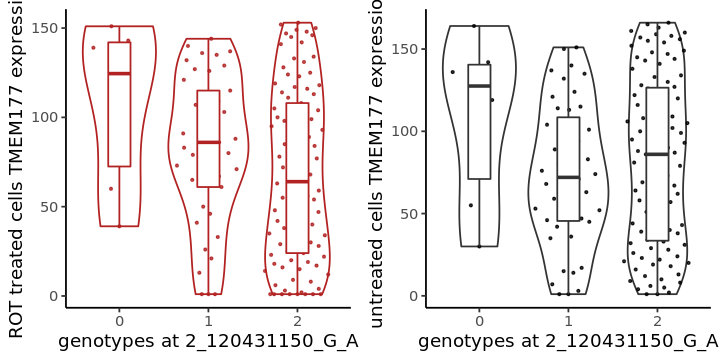

[1] 0.6961807


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

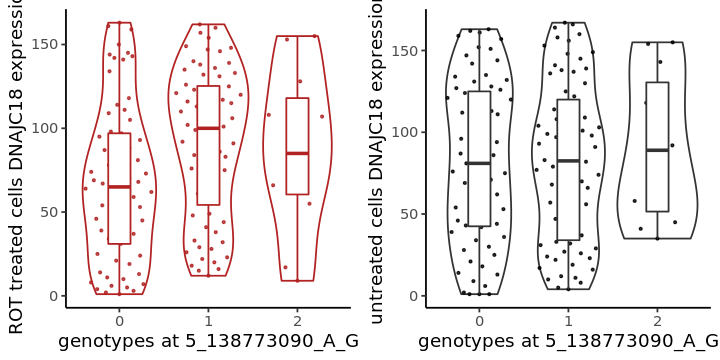

[1] -0.6867021


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

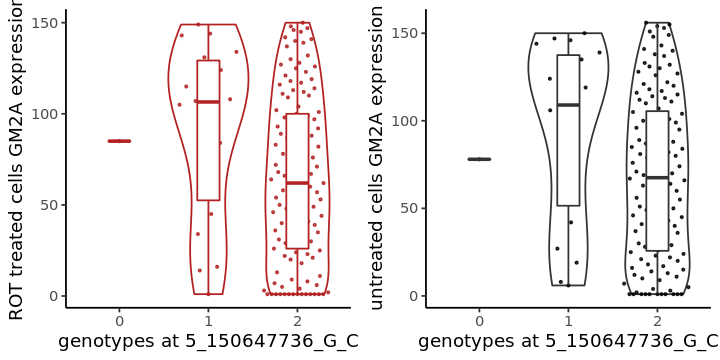

[1] 0.6743811


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

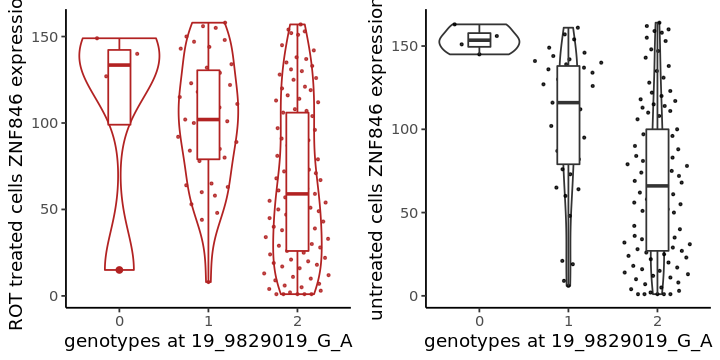

[1] 0.6727488


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

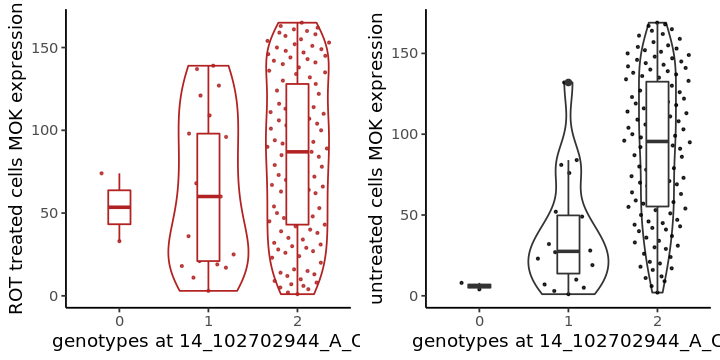

[1] 0.6712848


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

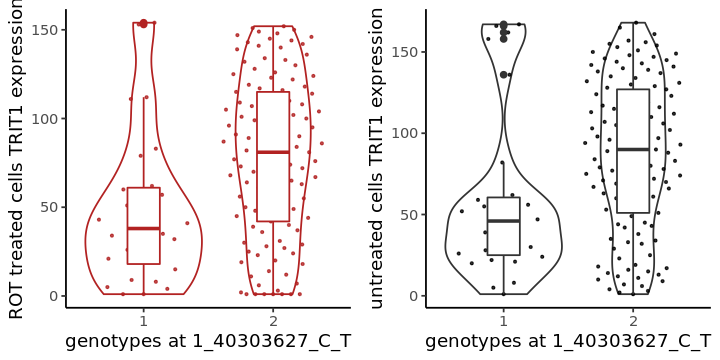

[1] -0.6583019


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

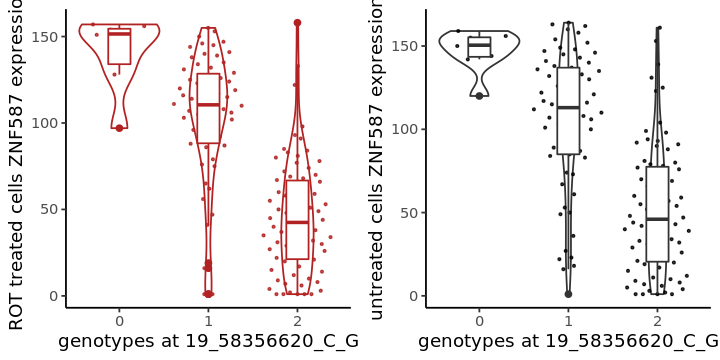

[1] -0.6569565


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

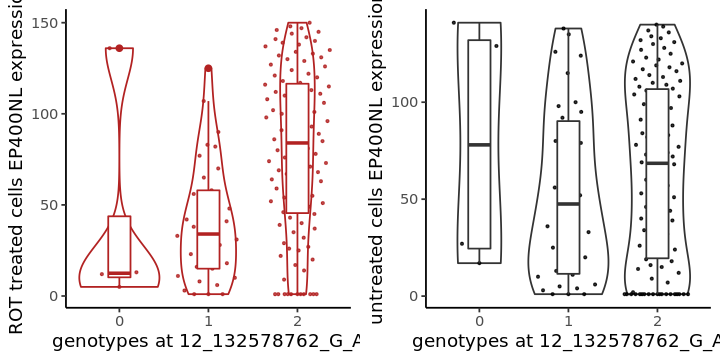

[1] -0.6470624


ERROR: Error in names(x) <- value: 'names' attribute [2] must be the same length as the vector [1]


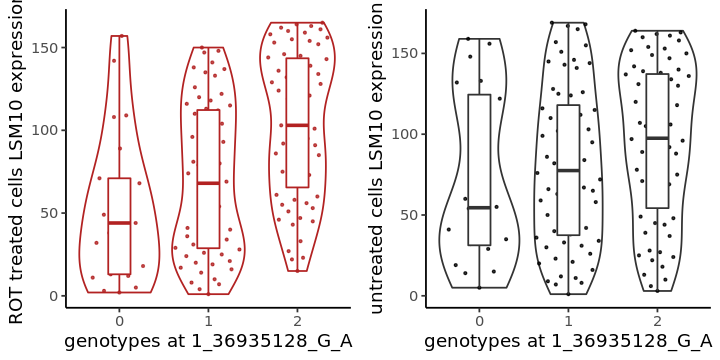

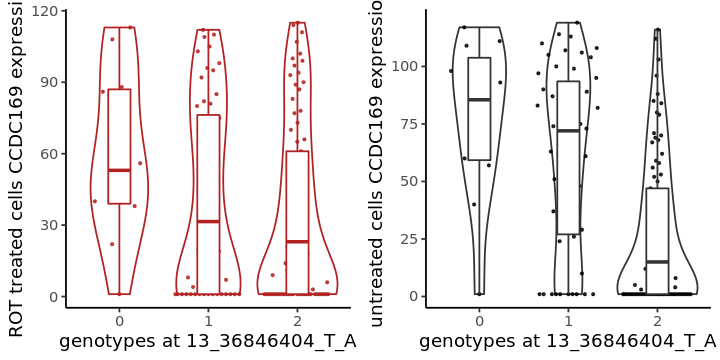

In [285]:
# res = sign_Epen1_ROT[order(sign_Epen1_ROT$q_value),]
res = sign_Epen1_ROT[order(abs(sign_Epen1_ROT$beta),decreasing = T),]
e = e_Epen1
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:30){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_treatment(gene,snp))
    print(res[i,"beta"])
}

In [27]:
# Astro
ROT_inter_Astro = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/treatment_D52/celltype_Astro/treatment_interaction_test_100cellfilter_top_qtl_results_all/top_qtl_results_all.txt"
int_Astro = read.csv(ROT_inter_Astro,sep="\t")
# head(int_Astro,2)
nrow(int_Astro)
# length(unique(int_Astro$feature_id))
int_Astro$q_value = p.adjust(int_Astro$p_value, "BH")
nrow(int_Astro[int_Astro$q_value < 0.05,])
# head(int_Astro[order(int_Astro$q_value),])

[1] 3372

[1] 42

In [28]:
sign_Astro_ROT = int_Astro[int_Astro$q_value < 0.05,]
sign_Astro_ROT = sign_Astro_ROT[order(abs(sign_Astro_ROT$beta), decreasing = T),]
sign_Astro_ROT = add_gene_name(sign_Astro_ROT,annos)
head(sign_Astro_ROT[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/ROT_treatment_interactions/Astro_FDR0.05.tsv"
write.table(sign_Astro_ROT[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
13_52714837_C_A,ENSG00000136098_NEK3
11_34905987_T_C,ENSG00000149089_APIP


In [29]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Astro_treatment_FDR0.05_egenes.tsv"
write.table(sign_Astro_ROT[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

In [149]:
### timepoint or maturation (from D30 to D52, excluding treated D52 cells)

In [30]:
## DA
day_inter_DA = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files/celltype_DA/top_qtl_results_all.txt"
int_DA2 = read.csv(day_inter_DA,sep="\t")
# head(int_DA2,2)
nrow(int_DA2)
# length(unique(int_DA2$feature_id))
int_DA2$q_value = p.adjust(int_DA2$p_value, "BH")
nrow(int_DA2[int_DA2$q_value < 0.05,])
# head(int_DA2[order(int_DA2$q_value),])

[1] 3209

[1] 155

In [31]:
sign_DA_mat = int_DA2[int_DA2$q_value < 0.05,]
sign_DA_mat = add_gene_name(sign_DA_mat,annos)
head(sign_DA_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_excluding_ROT_cells/DA_FDR0.05.tsv"
write.table(sign_DA_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
19_18707973_T_C,ENSG00000006016_CRLF1
17_48615329_G_A,ENSG00000006282_SPATA20


In [32]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/DA_maturation_noROT_FDR0.05_egenes.tsv"
write.table(sign_DA_mat[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 0.8513878


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] -0.8276929


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

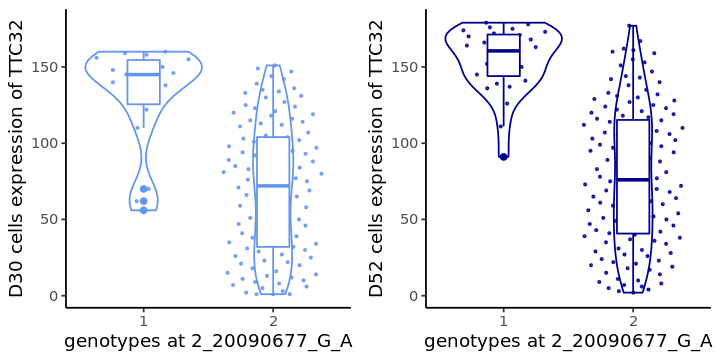

[1] 0.8069969


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

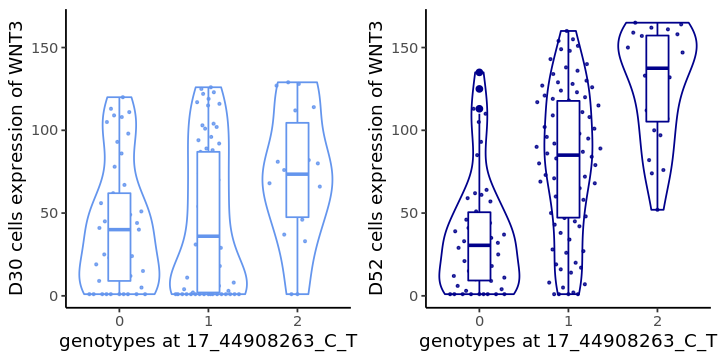

[1] -0.7954481


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

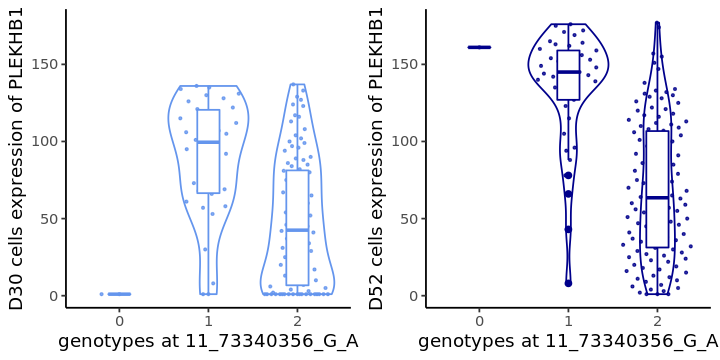

[1] 0.7901992


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

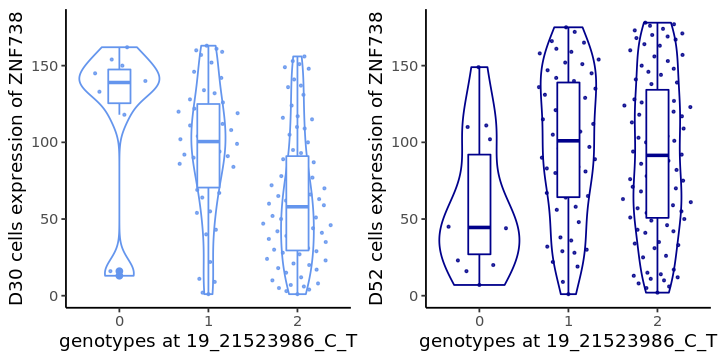

[1] 0.7643863


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

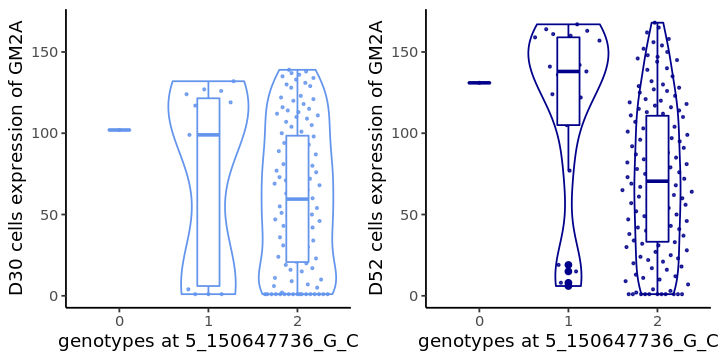

[1] -0.6847377


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

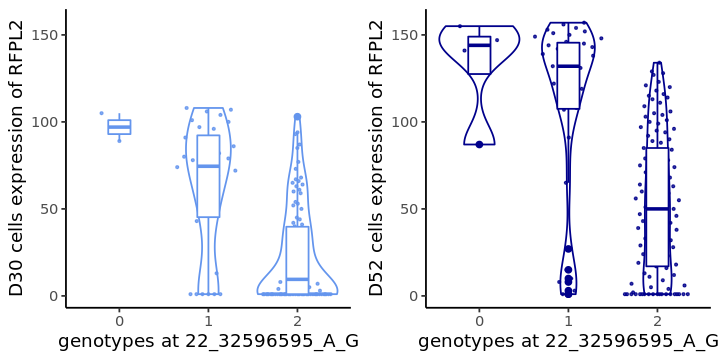

[1] -0.669411


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

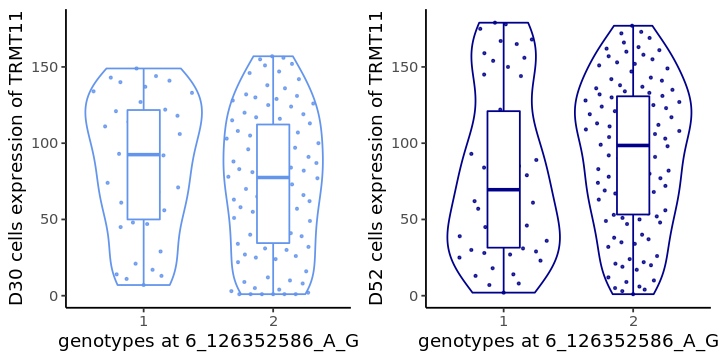

[1] -0.6324961


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

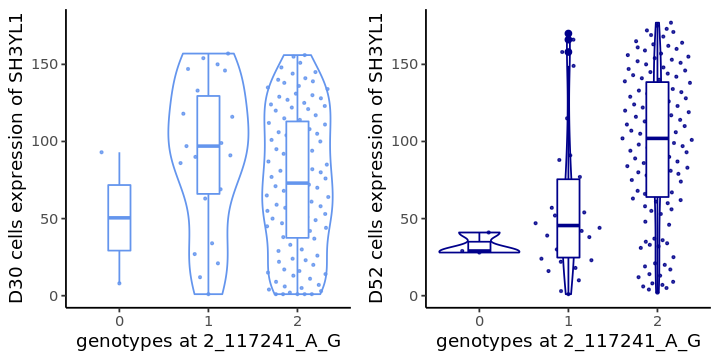

[1] -0.6245652


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

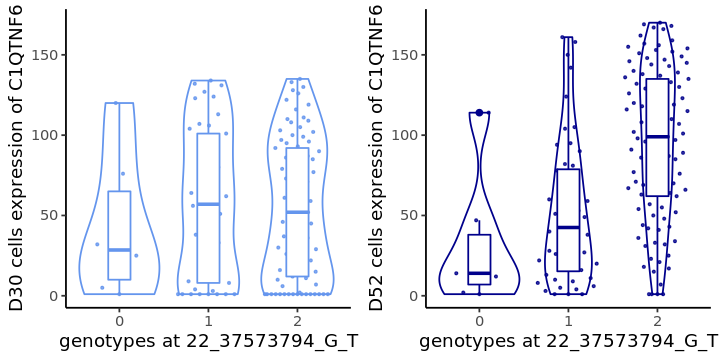

[1] -0.6075591


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

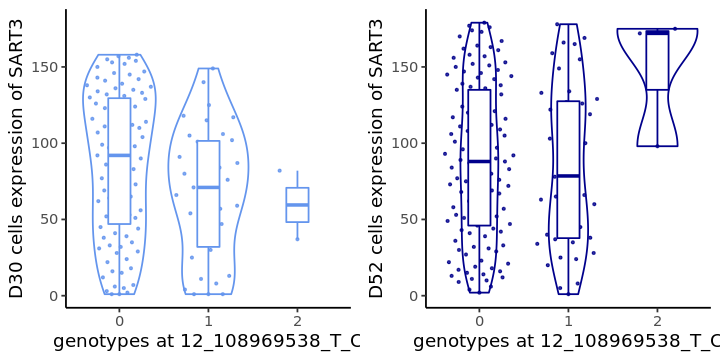

[1] 0.606723


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

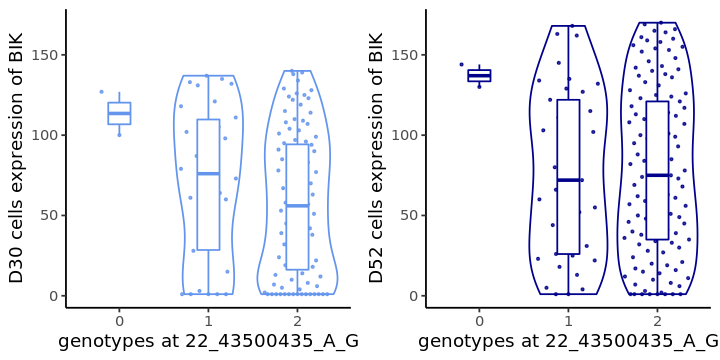

[1] 0.6054492


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

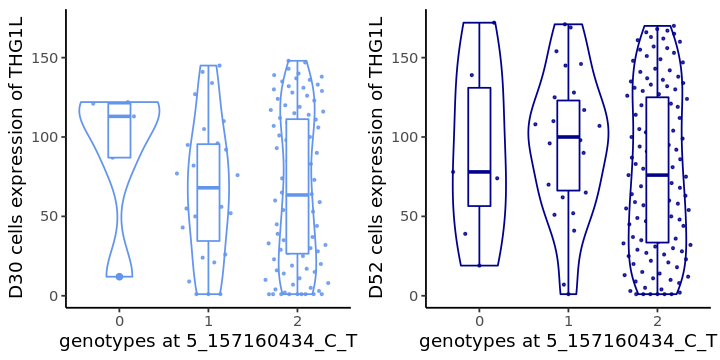

[1] 0.5947761


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

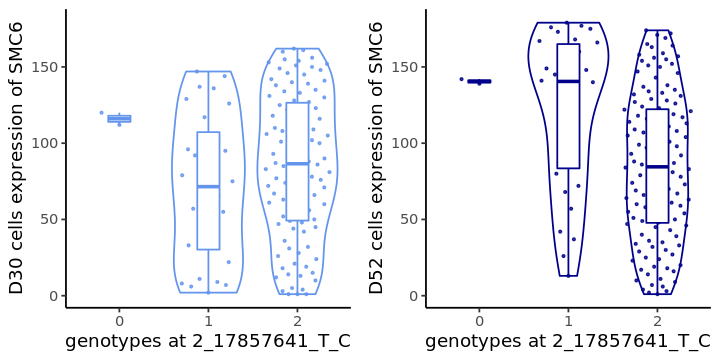

[1] 0.5935179


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

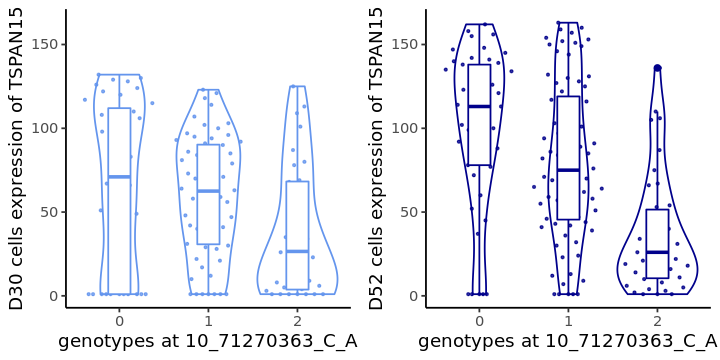

[1] 0.5857069


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

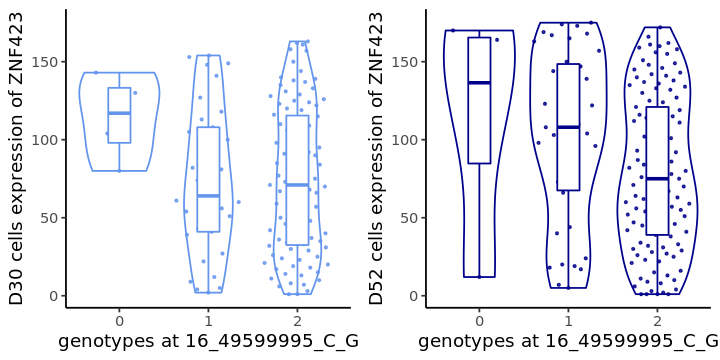

[1] 0.5759835


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

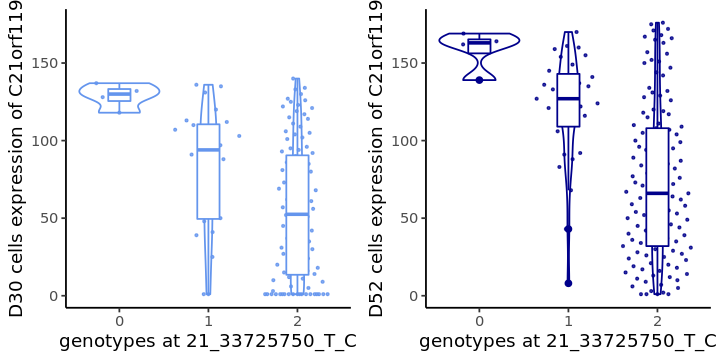

[1] 0.5734954


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

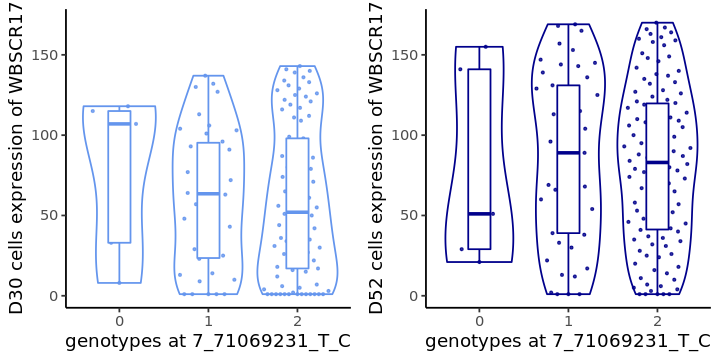

[1] -0.5727896


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

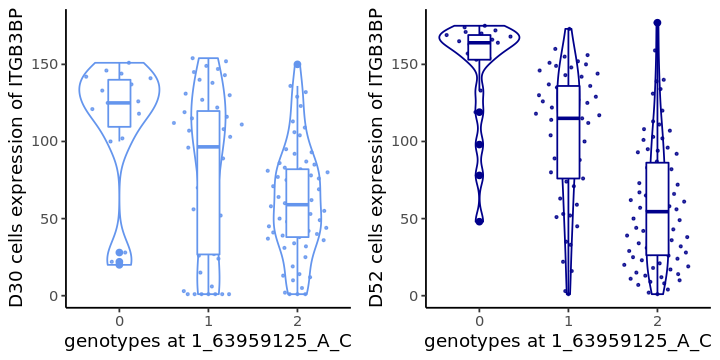

[1] -0.5649361


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

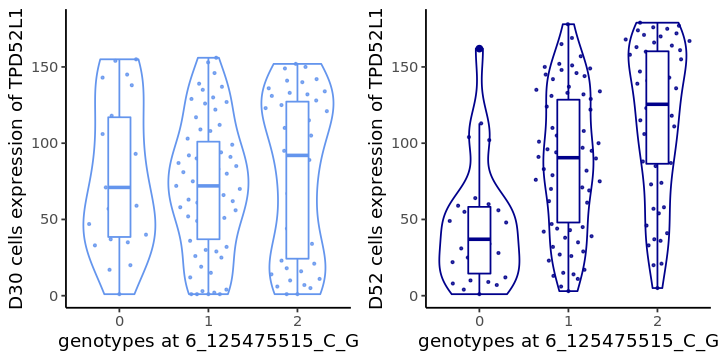

[1] 0.5543081


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

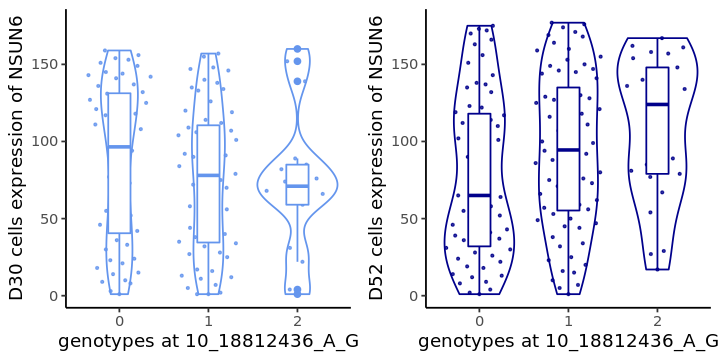

[1] 0.5505849


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

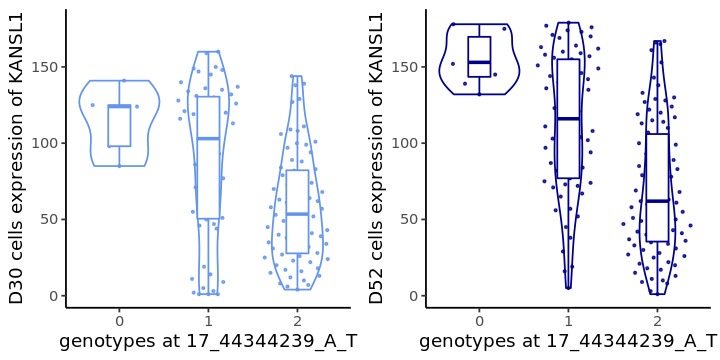

[1] -0.5503318


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

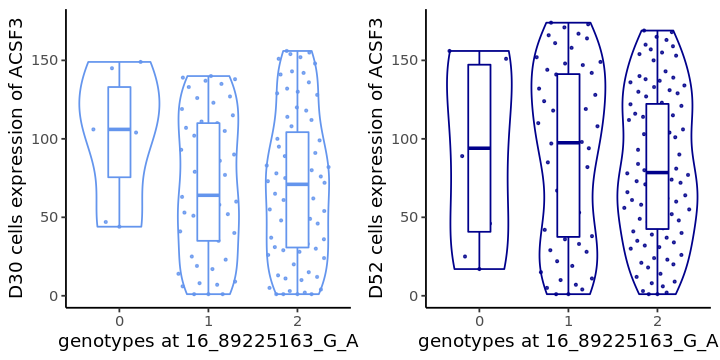

[1] -0.5411336


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

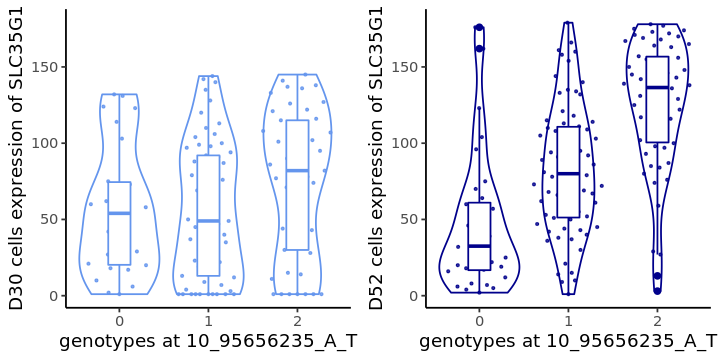

[1] -0.538542


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

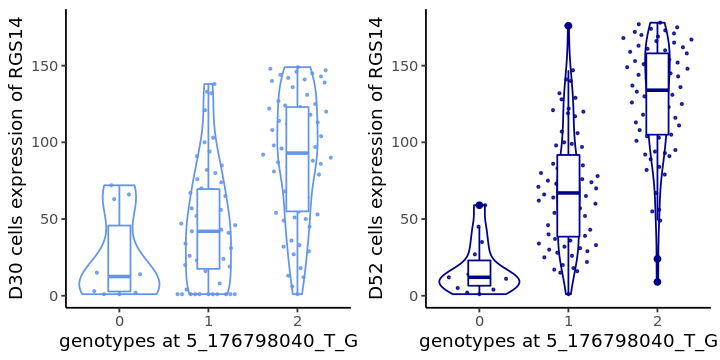

[1] -0.5348771


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

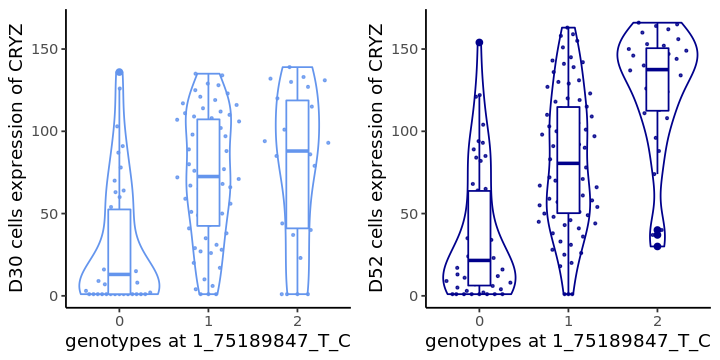

[1] 0.5332991


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

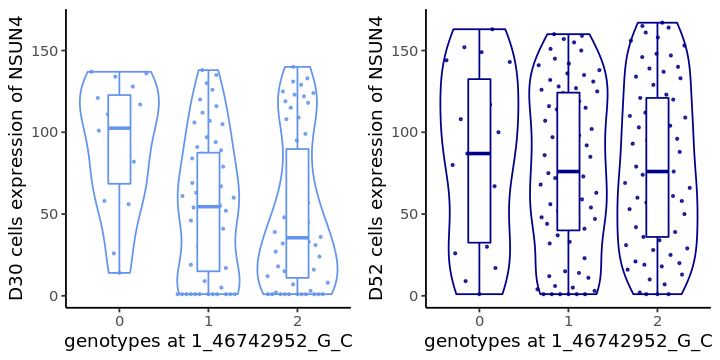

[1] -0.5316527


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

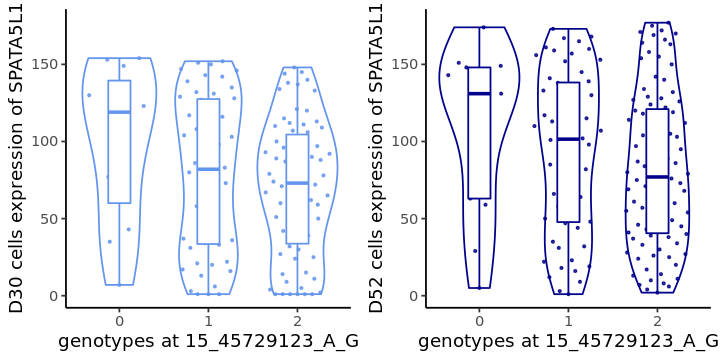

[1] 0.5293633


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

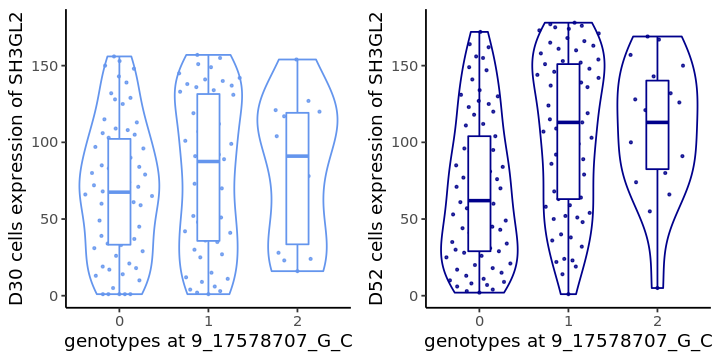

[1] -0.5249048


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

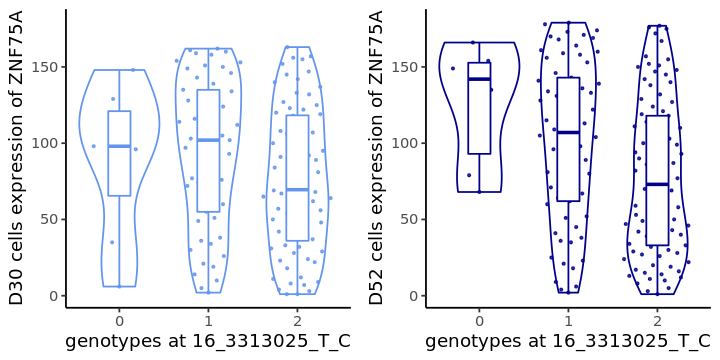

[1] 0.5220966


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

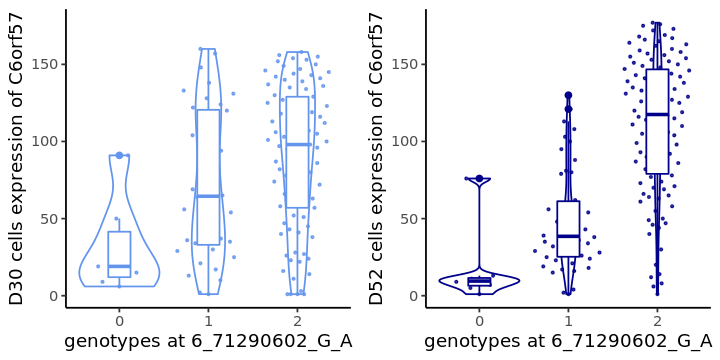

[1] -0.5138923


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

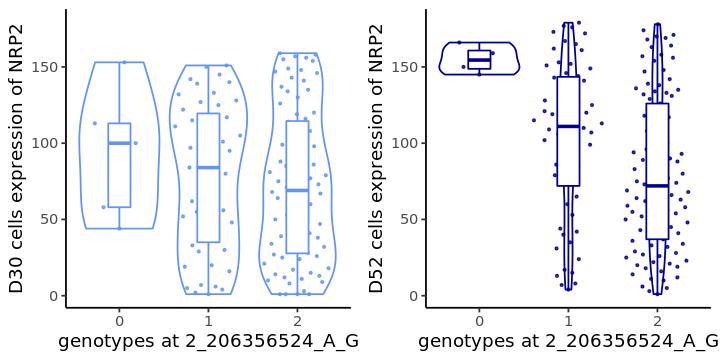

[1] 0.5118621


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

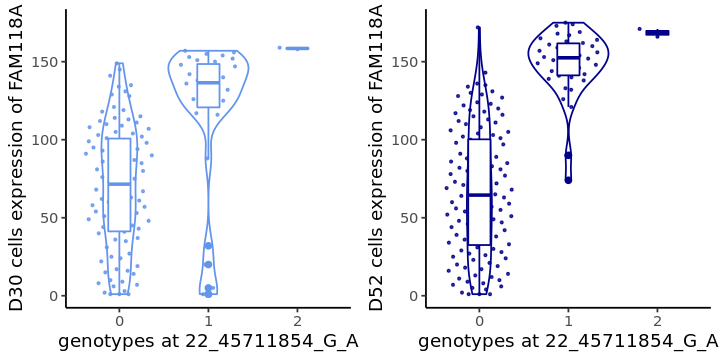

[1] 0.510024


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

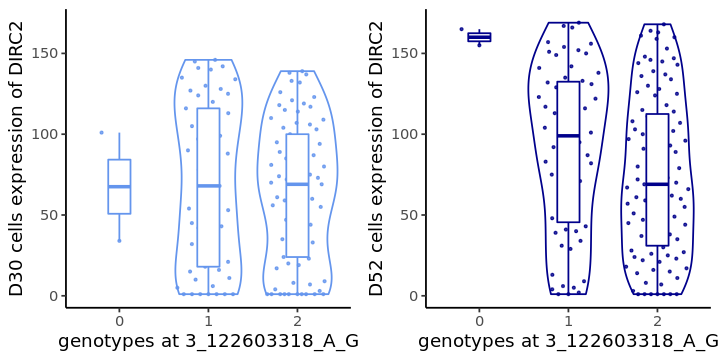

[1] -0.5061394


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

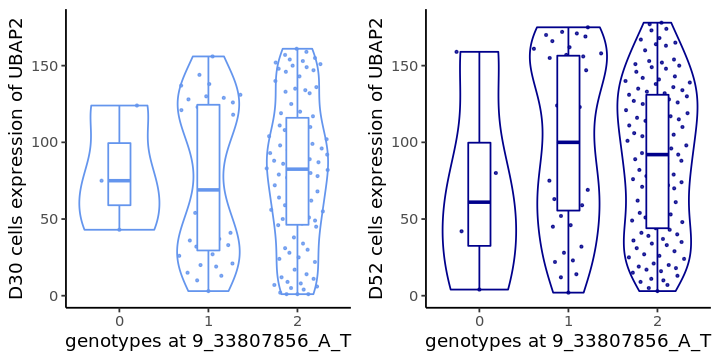

[1] 0.5051025


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

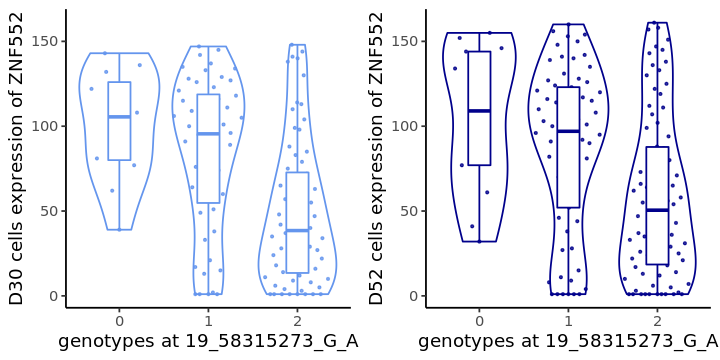

[1] 0.502794


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

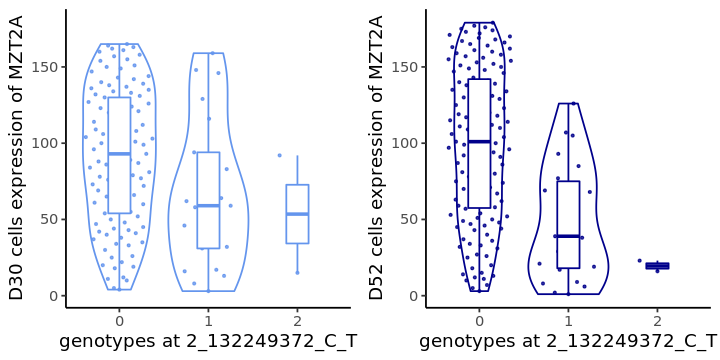

[1] -0.5004459


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

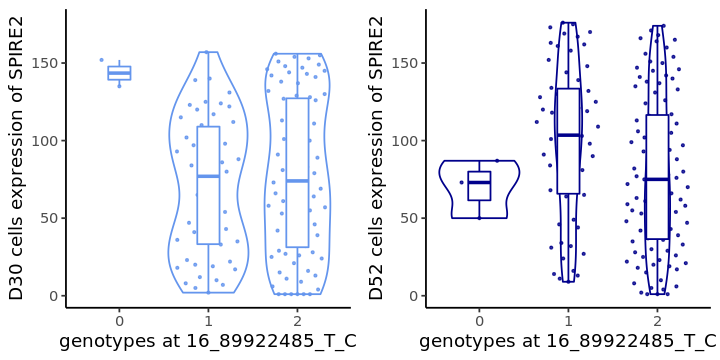

[1] -0.4977674


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

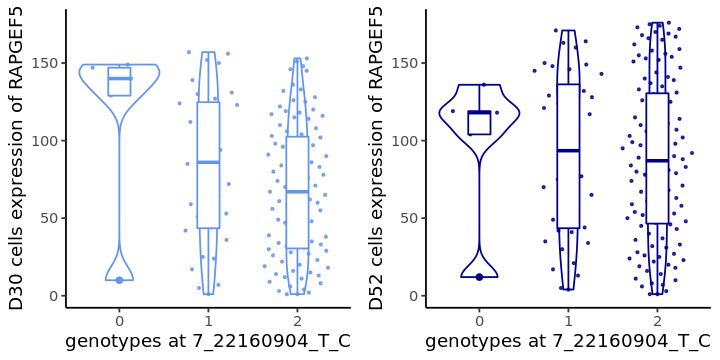

[1] -0.4969535


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

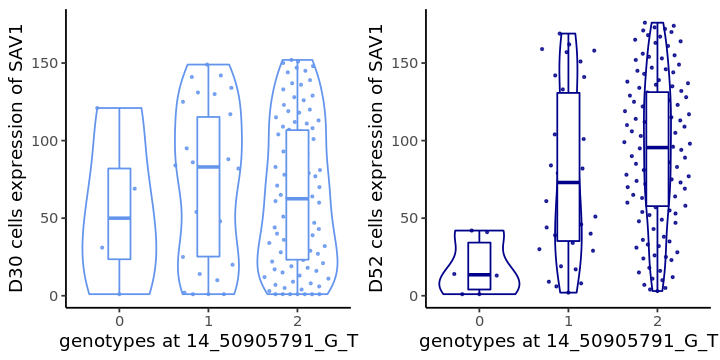

[1] -0.4951441


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

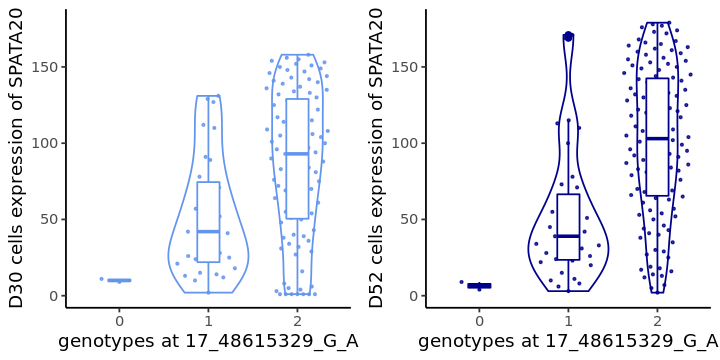

[1] 0.4943646


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

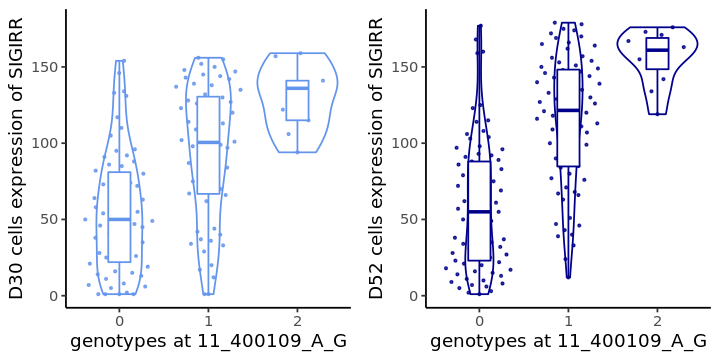

[1] -0.4783942


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

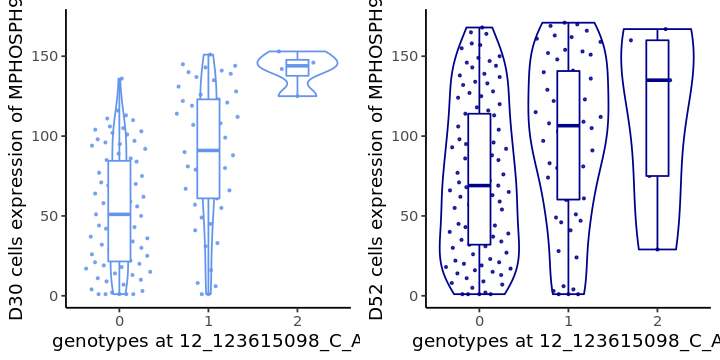

[1] 0.4744822


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

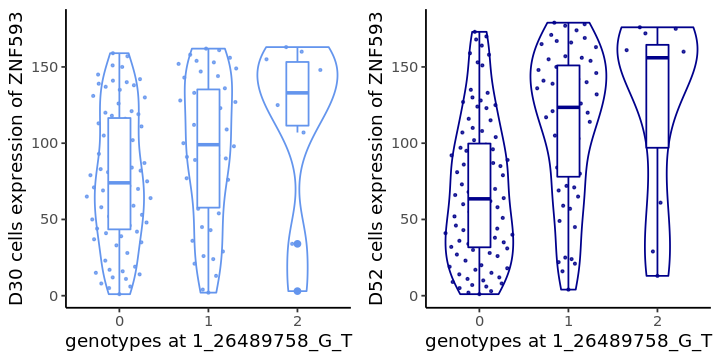

[1] -0.4691149


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

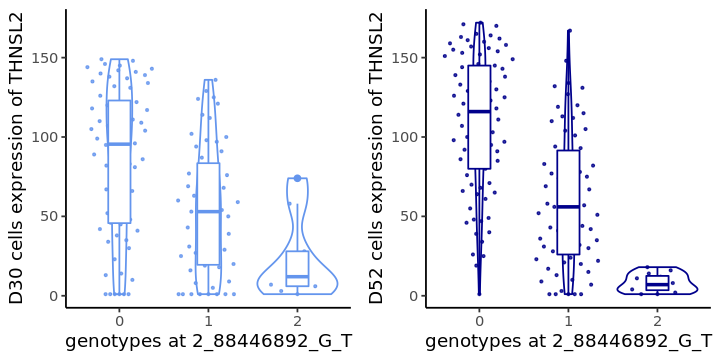

[1] -0.4603757


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

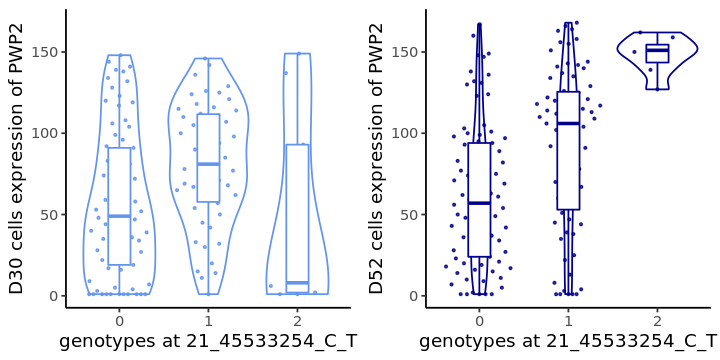

[1] 0.4599327


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

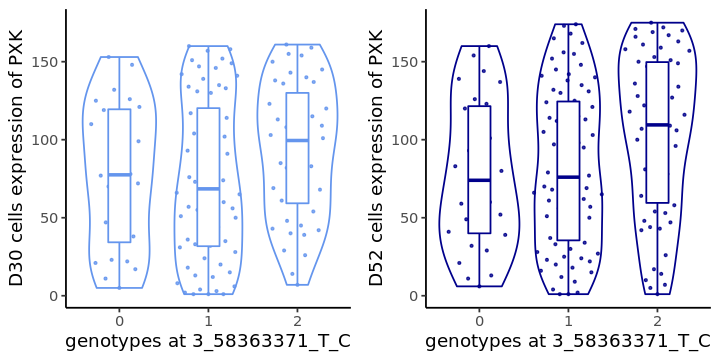

[1] -0.4565543


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

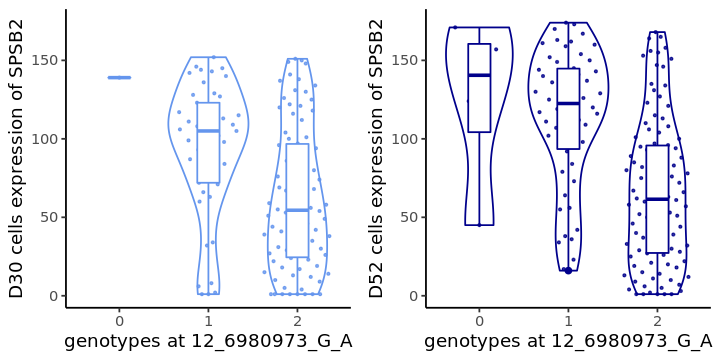

[1] 0.4522937


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

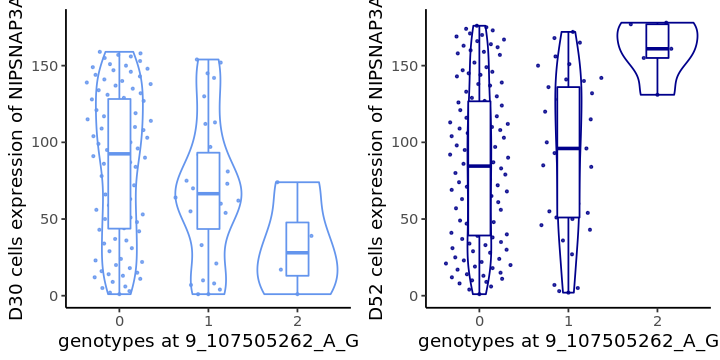

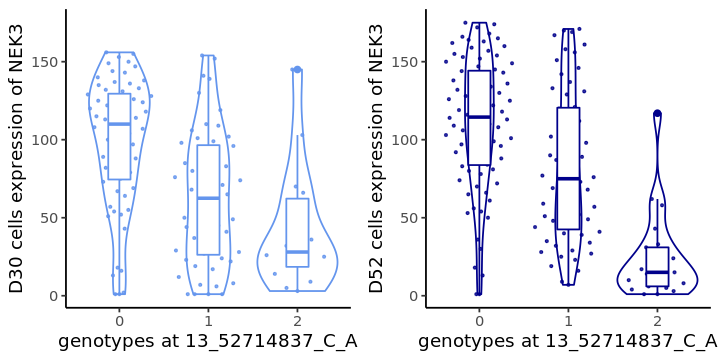

[1] -0.4506136


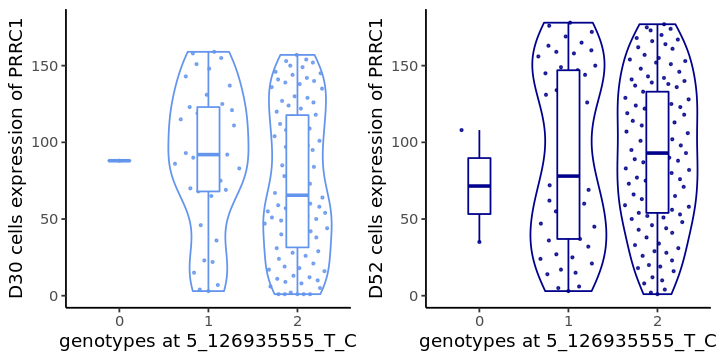

In [334]:
# res = sign_DA_mat[order(sign_DA_mat$q_value),]
res = sign_DA_mat[order(abs(sign_DA_mat$beta),decreasing = T),]
e_D30 = read.csv(paste0(mydir,DA_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,DA_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id

for (i in 1:50){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_timepoint(gene,snp,genos,e_D30,e_D52))
    print(res[i,"beta"])
}

In [33]:
# Sert
day_inter_Sert = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files/celltype_Sert/top_qtl_results_all.txt"
int_Sert2 = read.csv(day_inter_Sert,sep="\t")
# head(int_Sert2,2)
nrow(int_Sert2)
# length(unique(int_Sert2$feature_id))
int_Sert2$q_value = p.adjust(int_Sert2$p_value, "BH")
nrow(int_Sert2[int_Sert2$q_value < 0.05,])
# head(int_Sert2[order(int_Sert2$q_value),])

[1] 3400

[1] 248

In [34]:
sign_Sert_mat = int_Sert2[int_Sert2$q_value < 0.05,]
sign_Sert_mat = add_gene_name(sign_Sert_mat,annos)
head(sign_Sert_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_excluding_ROT_cells/Sert_FDR0.05.tsv"
write.table(sign_Sert_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
7_102111183_C_T,ENSG00000005075_POLR2J
8_134571842_G_A,ENSG00000008513_ST3GAL1


In [35]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Sert_maturation_noROT_FDR0.05_egenes.tsv"
write.table(sign_Sert_mat[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

In [321]:
snp = "20_47450063_C_T"
res = sign_Sert_mat[order(abs(sign_Sert_mat$beta),decreasing = T),]
gene = as.character(res[res$snp_id == snp,"hgnc_symbol"])
snp
gene

[1] "20_47450063_C_T"

[1] "PREX1"

In [322]:
e_D30 = read.csv(paste0(mydir,Sert_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Sert_D52),sep="\t")

In [328]:
# head(e_D30)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

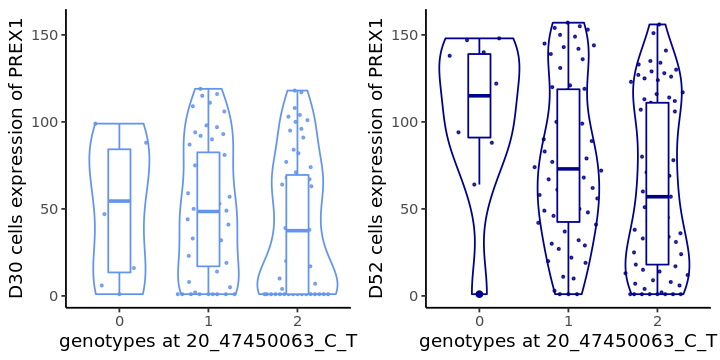

In [327]:
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id 
Boxplot_timepoint(gene,snp, genos, e_D30, e_D52)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] -1.159153


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 1.122517


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

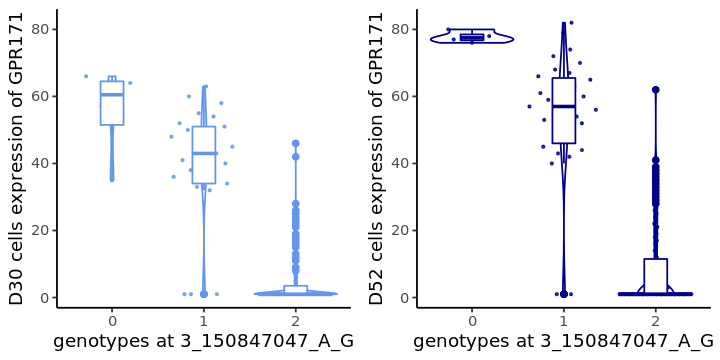

[1] 1.11532


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

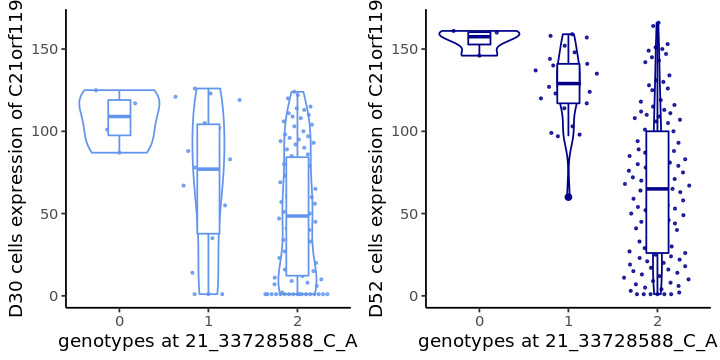

[1] 1.016843


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

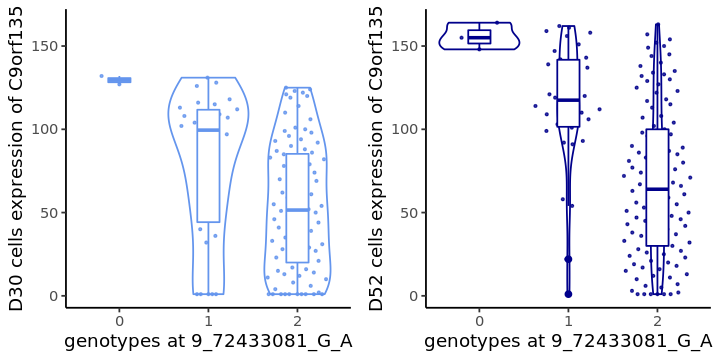

[1] 0.9690756


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

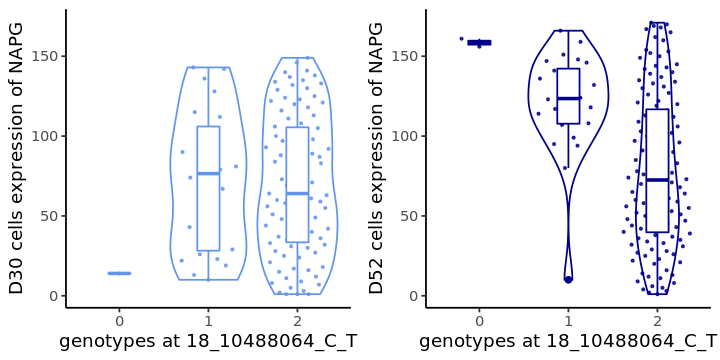

[1] 0.9600675


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

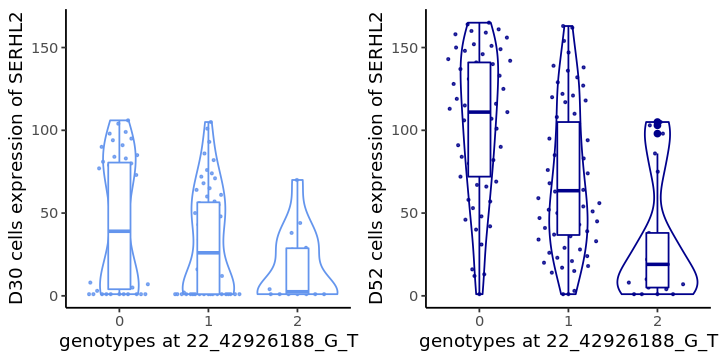

[1] 0.9011178


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

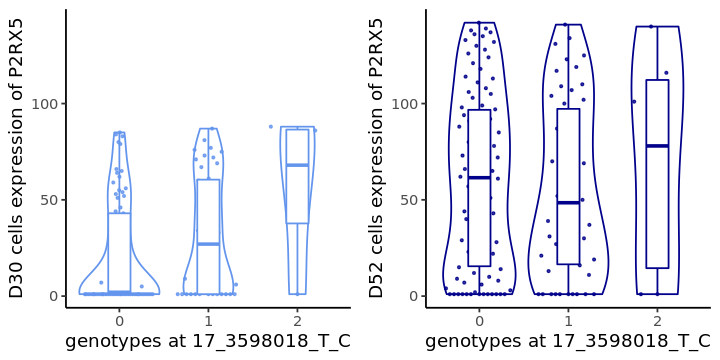

[1] 0.8824446


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

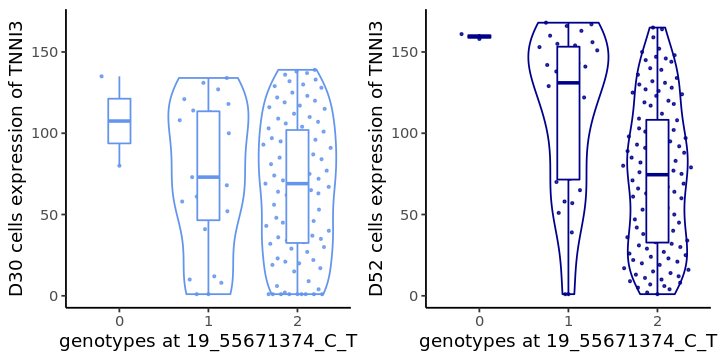

[1] -0.8187129


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

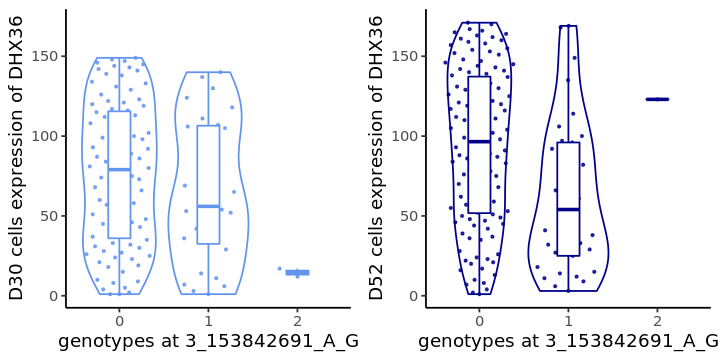

[1] -0.8159139


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

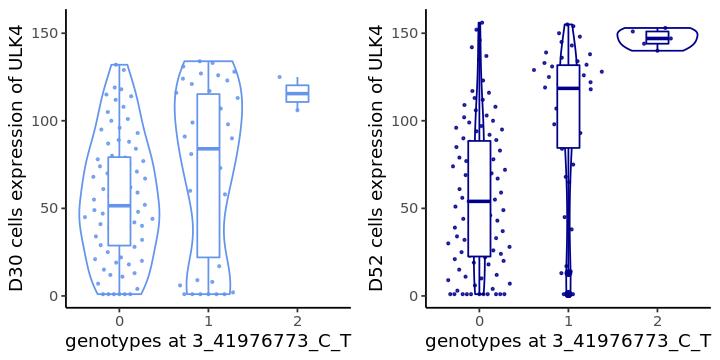

[1] -0.7957495


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

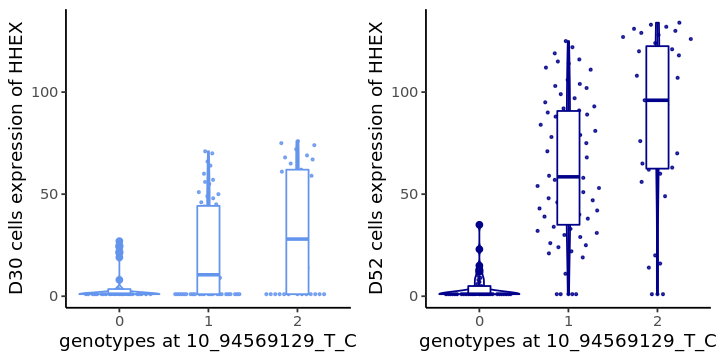

[1] -0.7897439


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

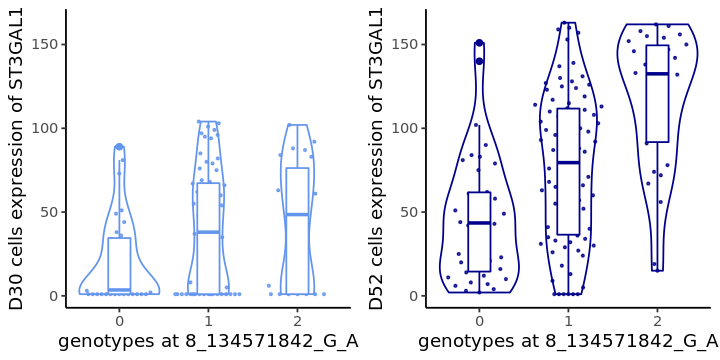

[1] 0.7716317


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

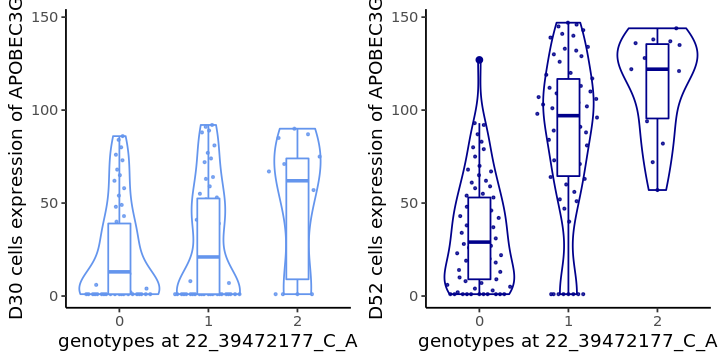

[1] -0.7257337


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

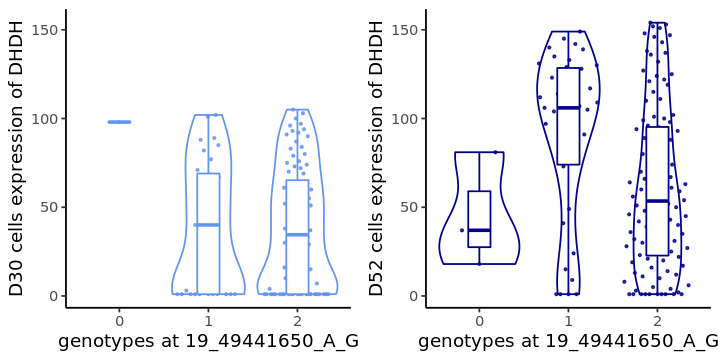

[1] 0.7226796


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

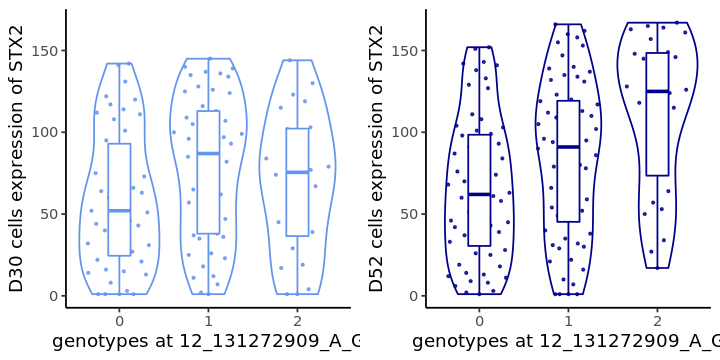

[1] -0.7220761


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

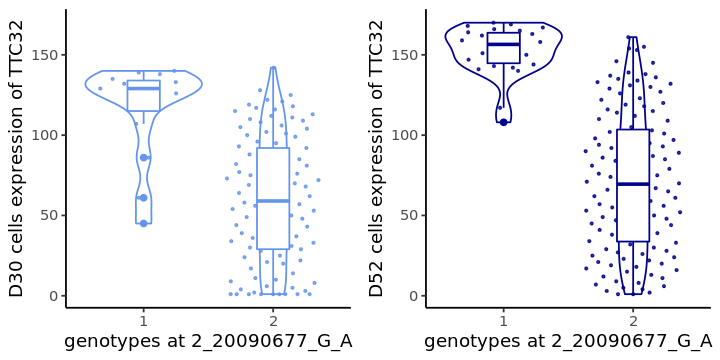

[1] -0.7158217


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

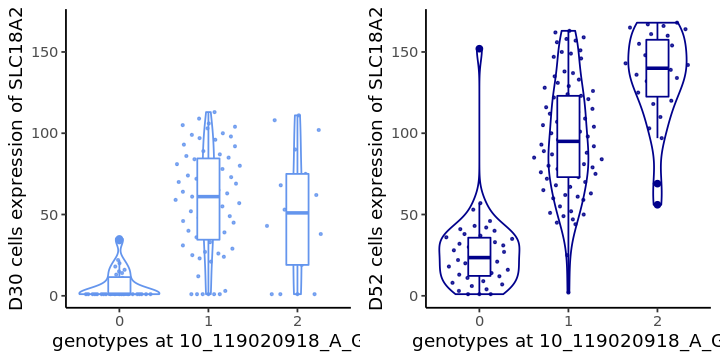

[1] -0.6976951


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

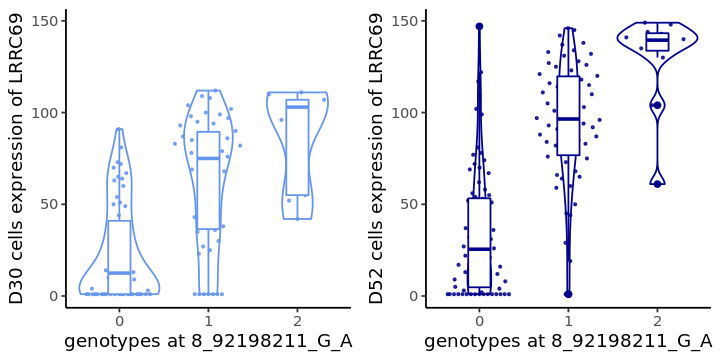

[1] -0.67306


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

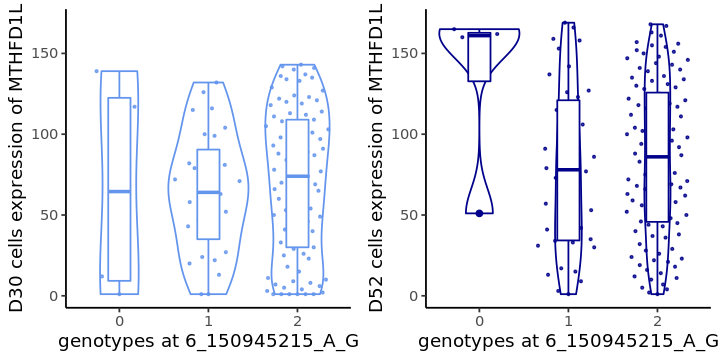

[1] -0.6537651


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

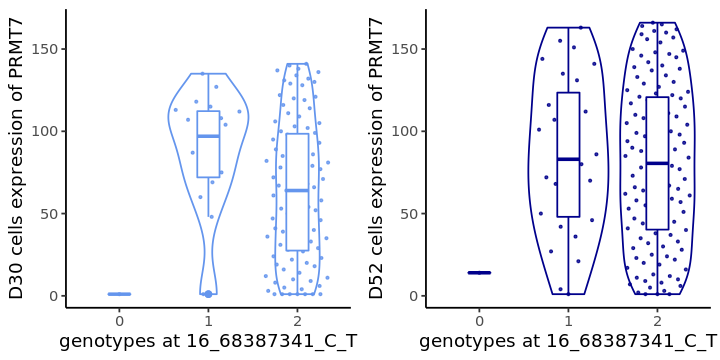

[1] -0.6534214


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

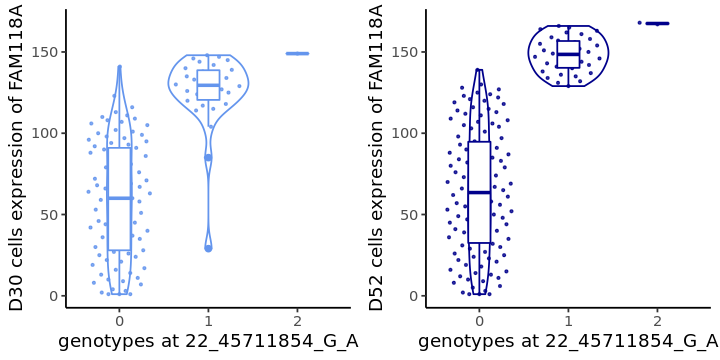

[1] 0.6524124


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

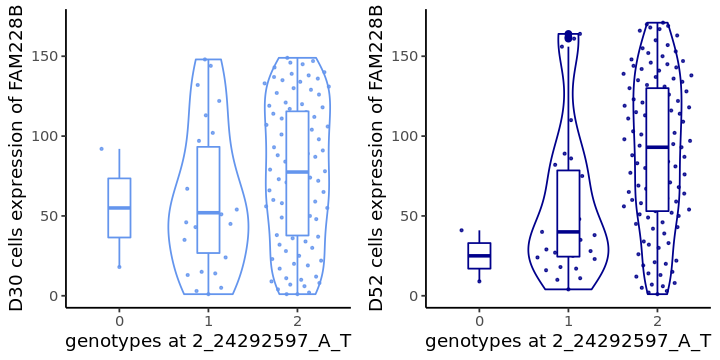

[1] -0.6512823


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

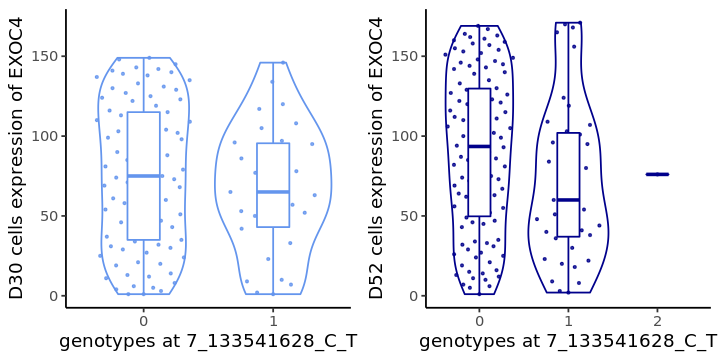

[1] 0.6500013


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

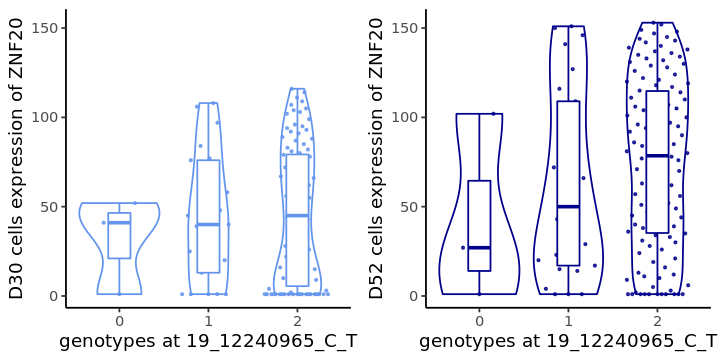

[1] -0.6440754


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

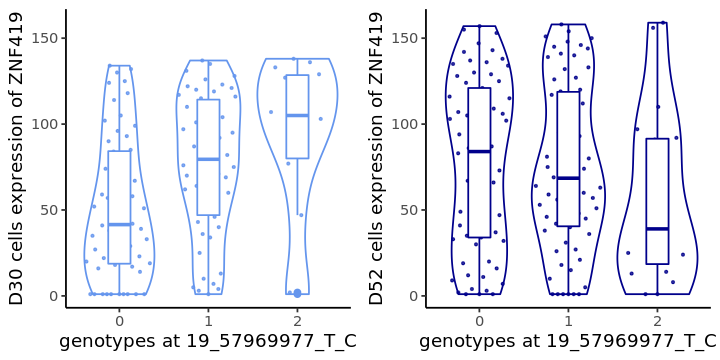

[1] 0.6375844


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

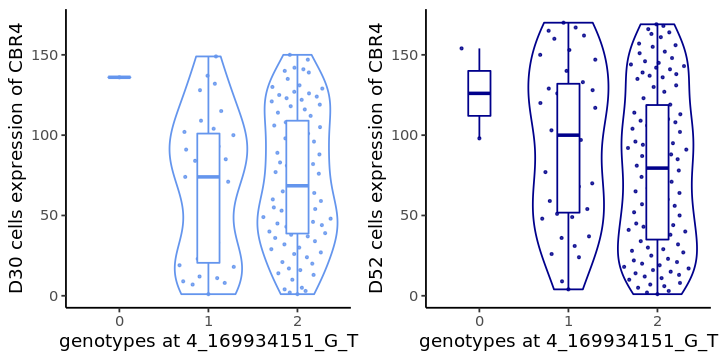

[1] -0.6348065


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

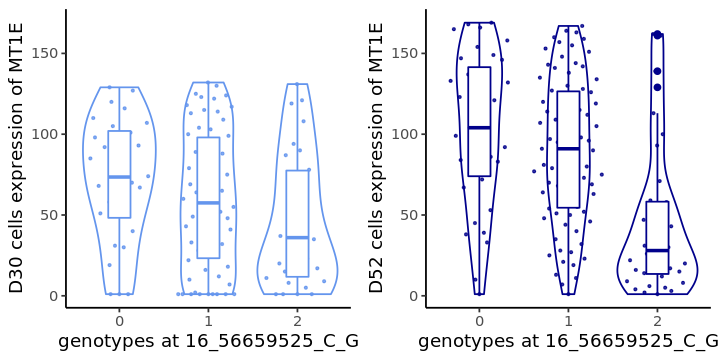

[1] -0.632356


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

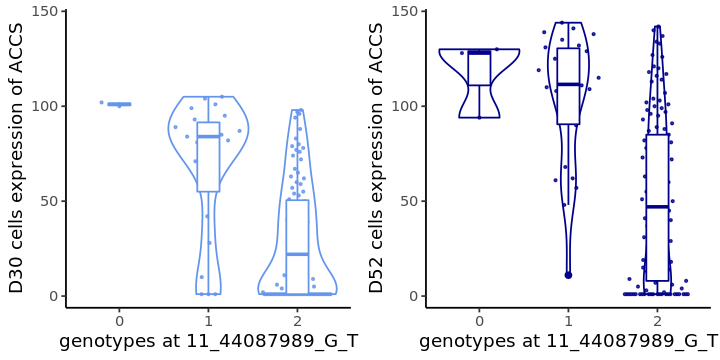

[1] -0.6298412


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

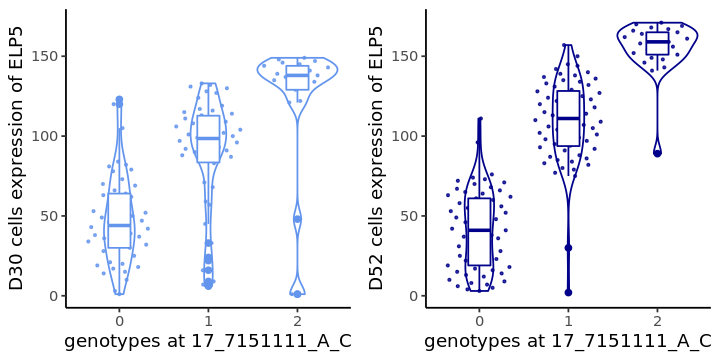

[1] 0.6268324


ERROR: Error in names(x) <- value: 'names' attribute [2] must be the same length as the vector [1]


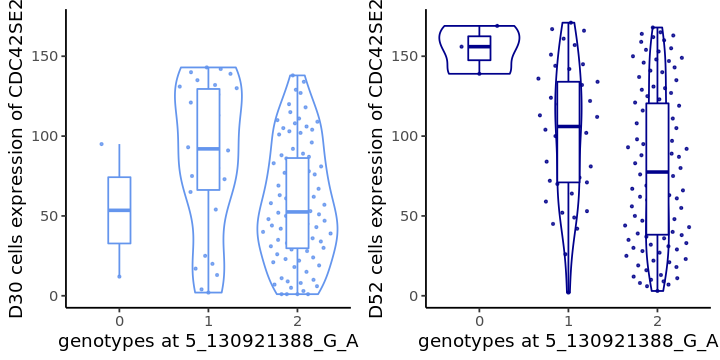

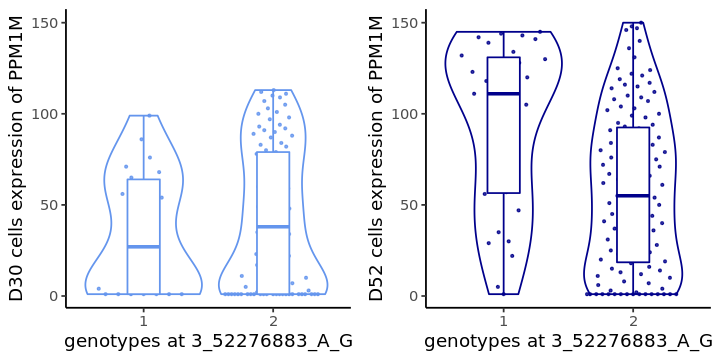

In [335]:
# res = sign_Sert_mat[order(sign_Sert_mat$q_value),]
res = sign_Sert_mat[order(abs(sign_Sert_mat$beta),decreasing = T),]
e_D30 = read.csv(paste0(mydir,Sert_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Sert_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id

for (i in 1:50){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_timepoint(gene,snp,genos,e_D30,e_D52))
    print(res[i,"beta"])
}

In [36]:
# Epen1
day_inter_Epen1 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files/celltype_Epen1/top_qtl_results_all.txt"
int_Epen1.2 = read.csv(day_inter_Epen1,sep="\t")
# head(int_Epen1.2,2)
nrow(int_Epen1.2)
# length(unique(int_Epen1.2$feature_id))
int_Epen1.2$q_value = p.adjust(int_Epen1.2$p_value, "BH")
nrow(int_Epen1.2[int_Epen1.2$q_value < 0.05,])
# head(int_Epen1.2[order(int_Epen1.2$q_value),])

[1] 3432

[1] 123

In [37]:
sign_Epen1_mat = int_Epen1.2[int_Epen1.2$q_value < 0.05,]
sign_Epen1_mat = add_gene_name(sign_Epen1_mat,annos)
head(sign_Epen1_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_excluding_ROT_cells/Epen1_FDR0.05.tsv"
write.table(sign_Epen1_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
16_89687377_G_A,ENSG00000015413_DPEP1
3_53847408_A_G,ENSG00000016391_CHDH


In [38]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Epen1_maturation_noROT_FDR0.05_egenes.tsv"
write.table(sign_Epen1_mat[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] -0.9781507


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 0.9262696


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

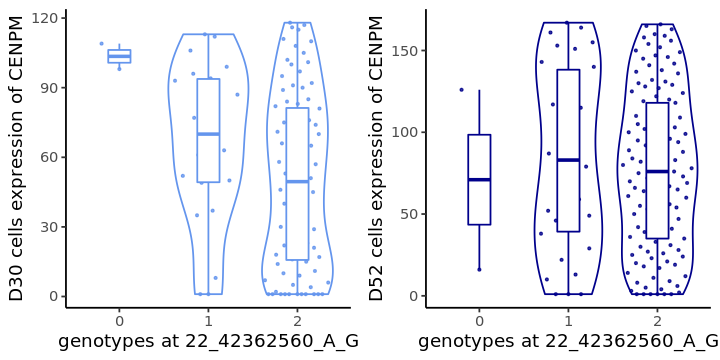

[1] -0.9155321


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

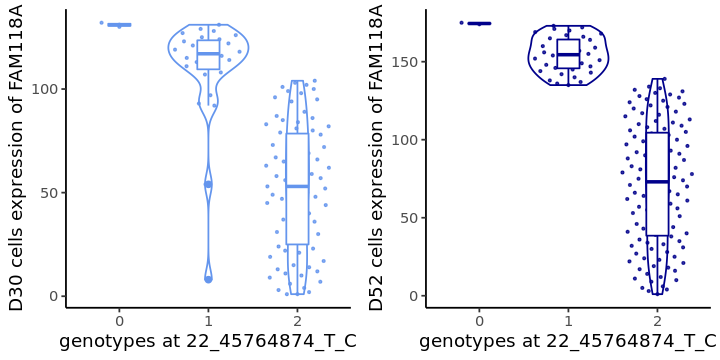

[1] -0.8588379


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

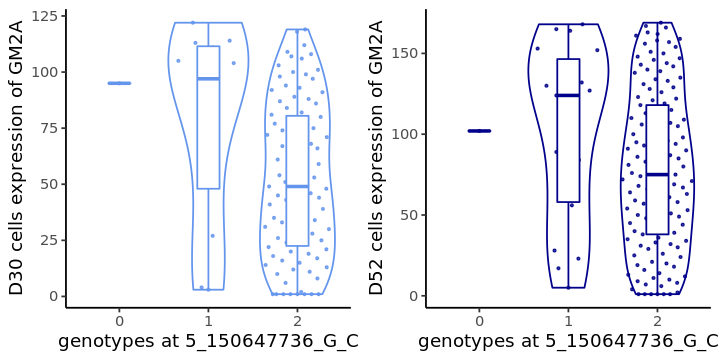

[1] 0.7851375


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

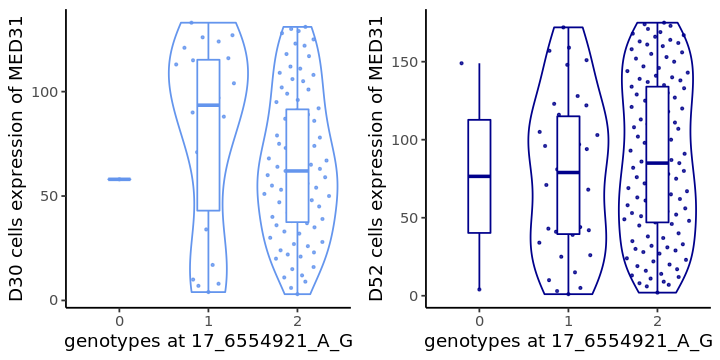

[1] -0.7585971


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

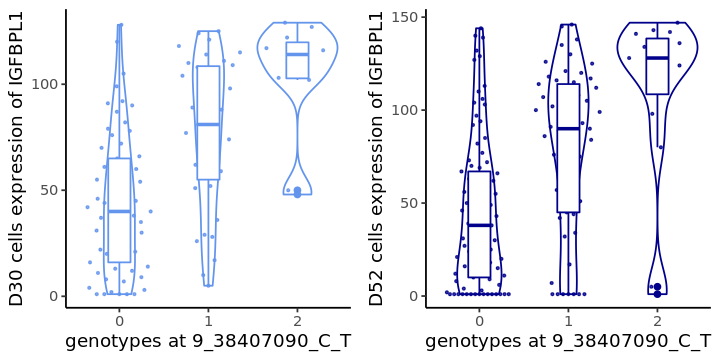

[1] 0.7563411


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

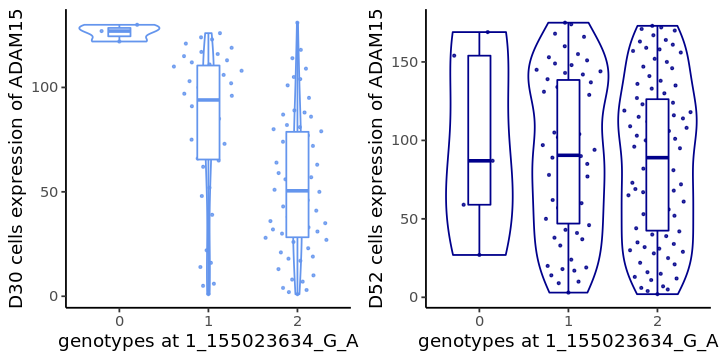

[1] -0.7524676


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

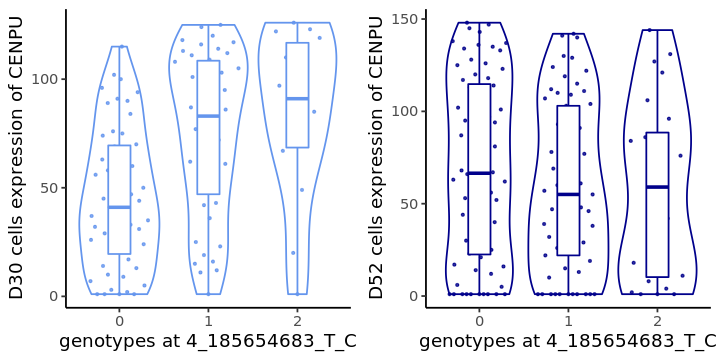

[1] 0.7299613


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

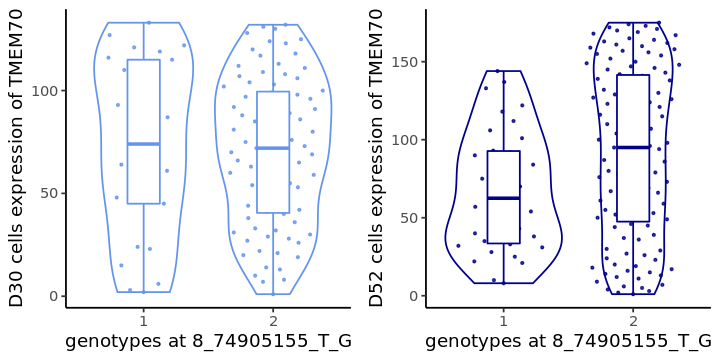

[1] 0.7217859


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

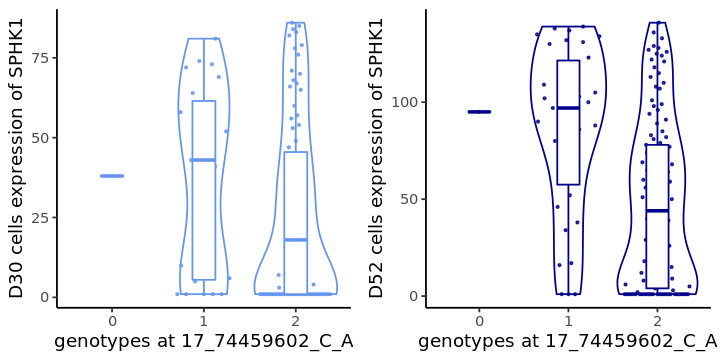

[1] -0.7132566


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

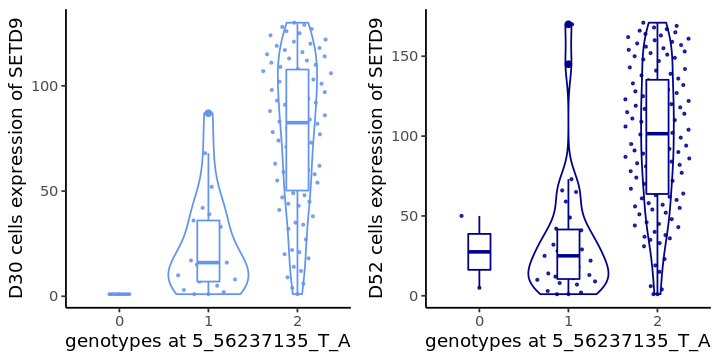

[1] 0.7128847


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

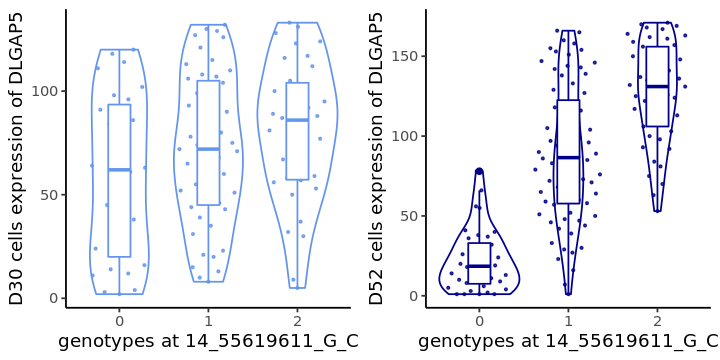

[1] -0.7055906


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

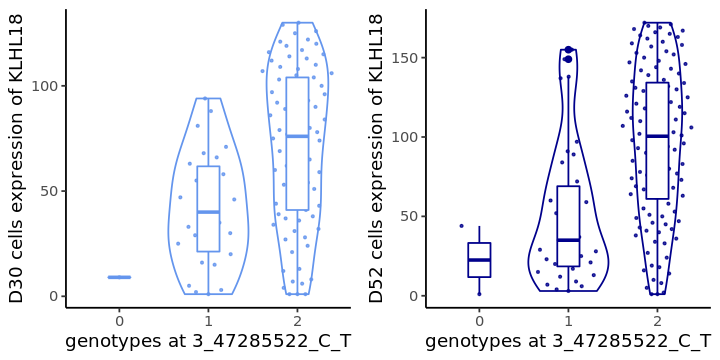

[1] -0.7036173


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

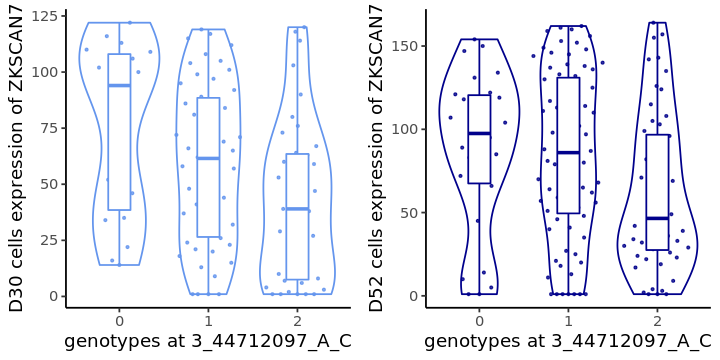

[1] -0.6942268


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

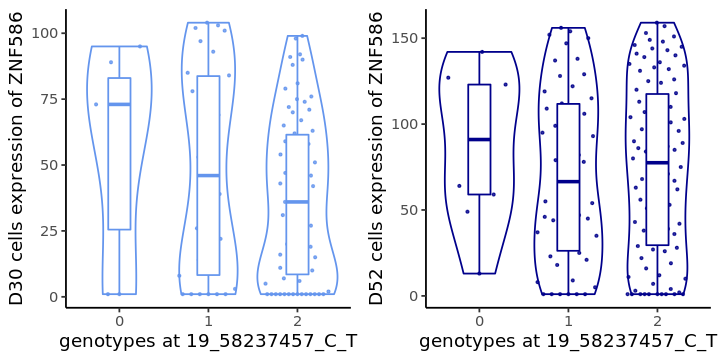

[1] 0.6829774


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

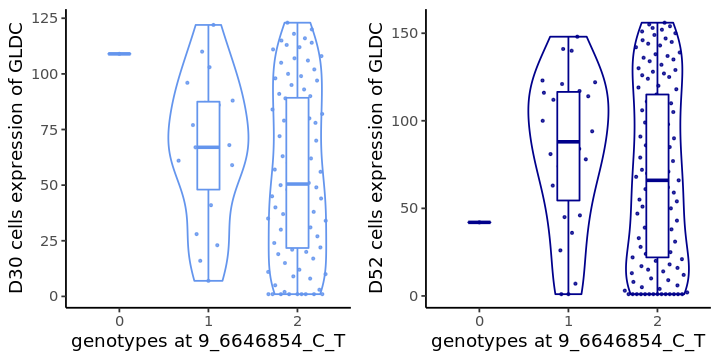

[1] 0.6820547


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

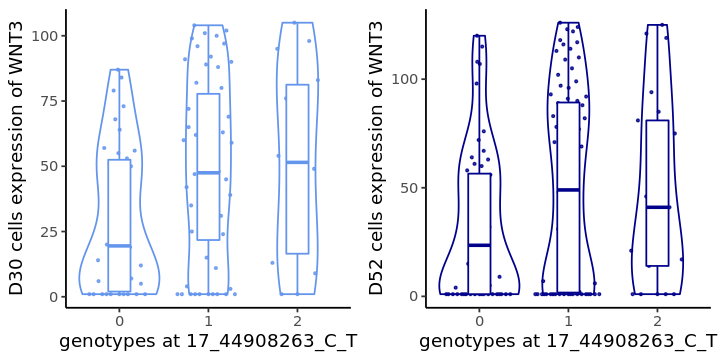

[1] -0.6728967


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

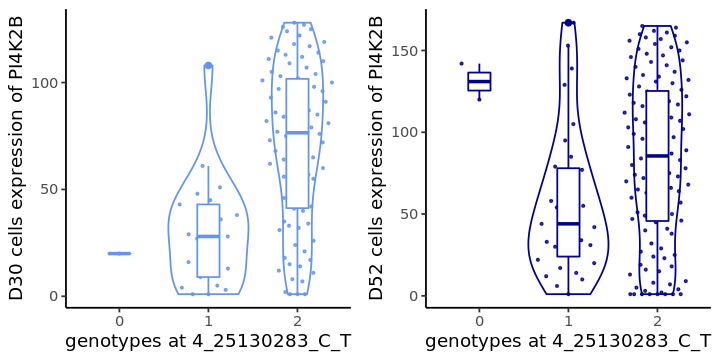

[1] 0.661944


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

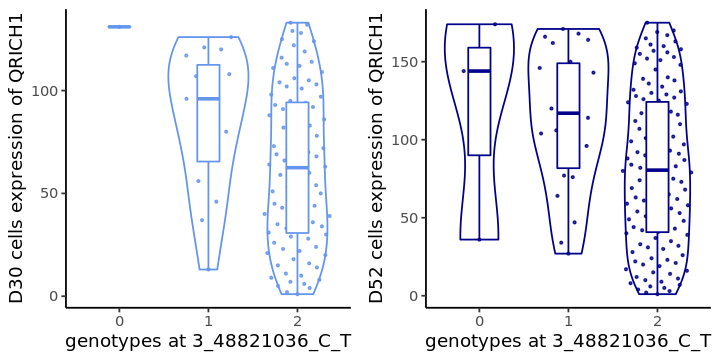

[1] 0.6549597


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

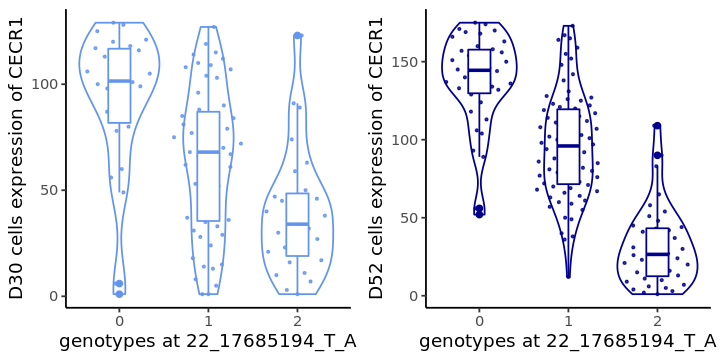

[1] 0.6386501


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

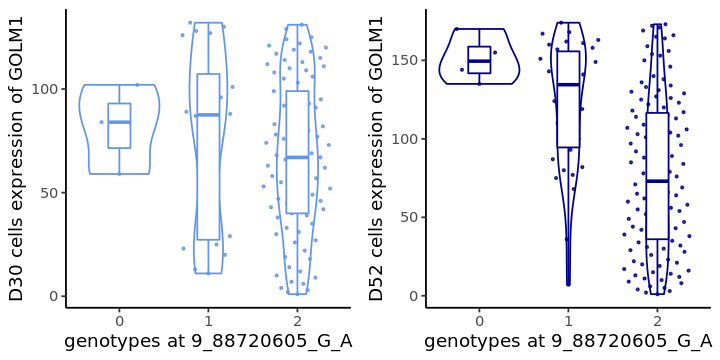

[1] -0.6281482


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

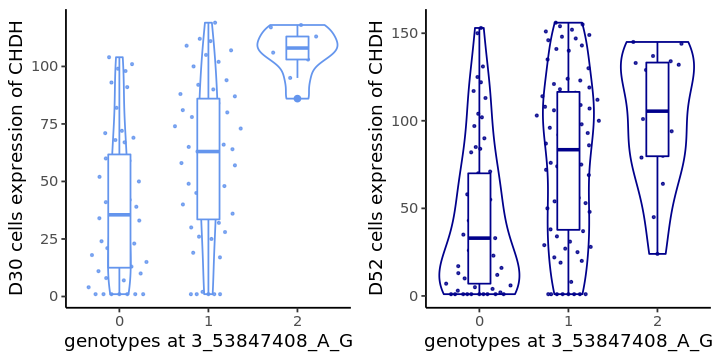

[1] -0.6276149


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

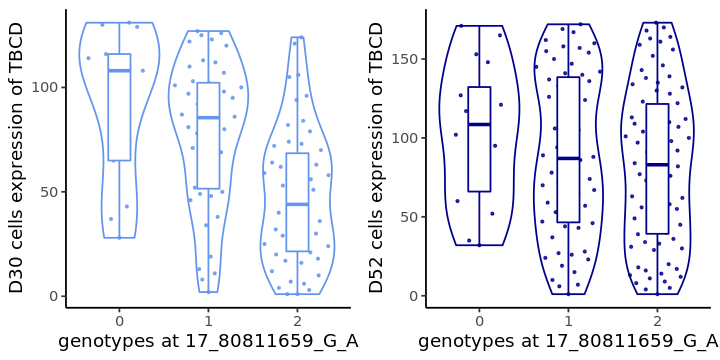

[1] -0.6103165


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

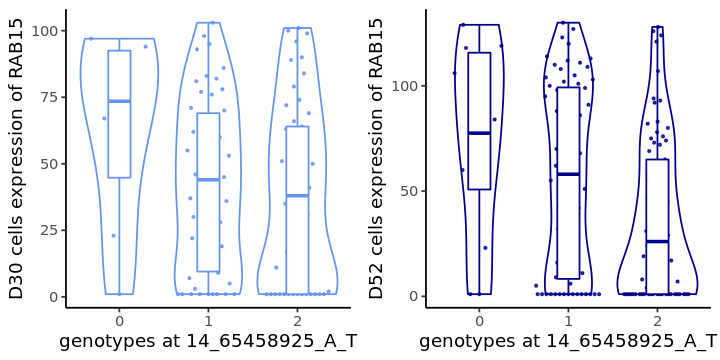

[1] -0.6074626


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

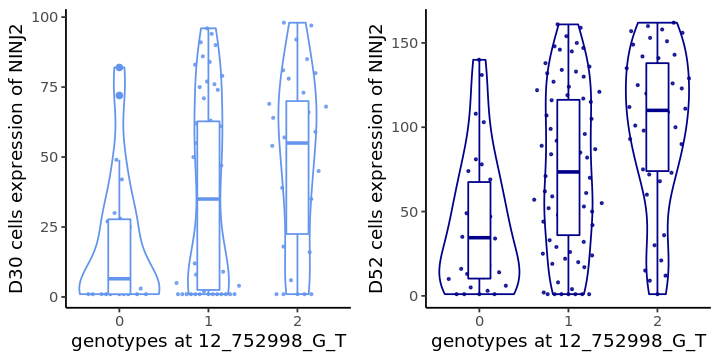

[1] -0.6065671


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

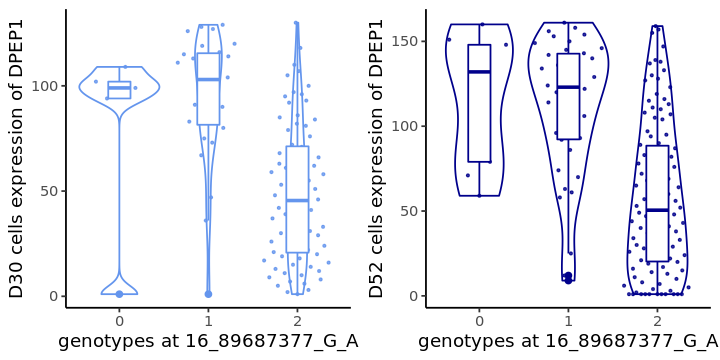

[1] 0.6063348


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

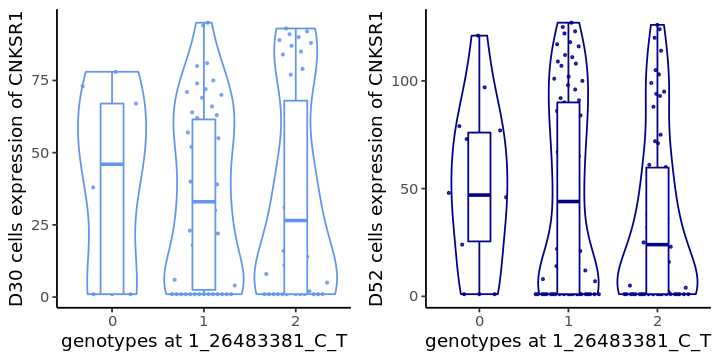

[1] -0.6045094


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

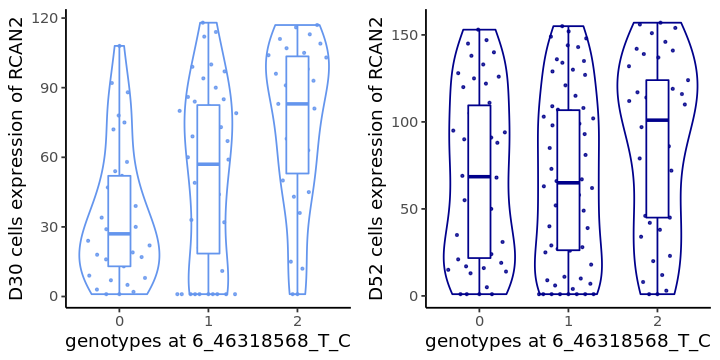

[1] 0.6037834


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

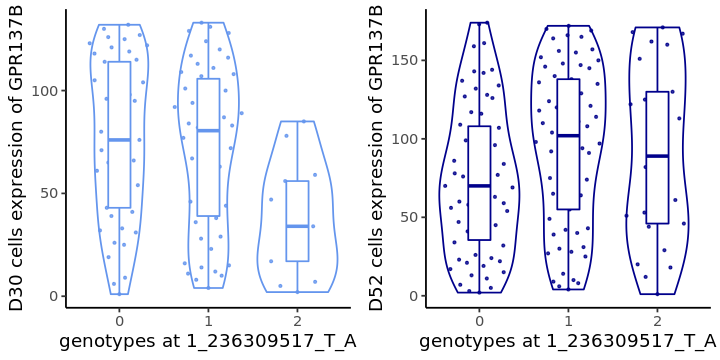

[1] -0.6033803


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

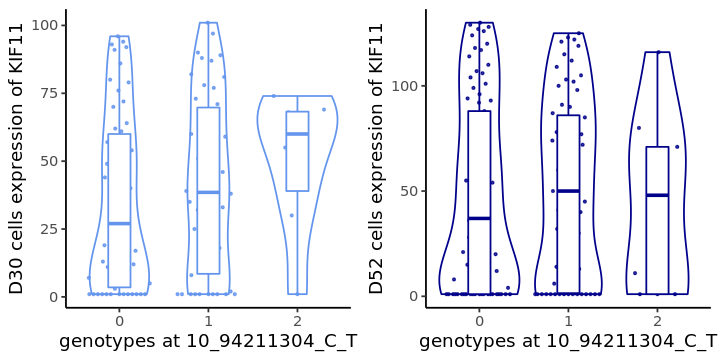

[1] 0.6027131


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

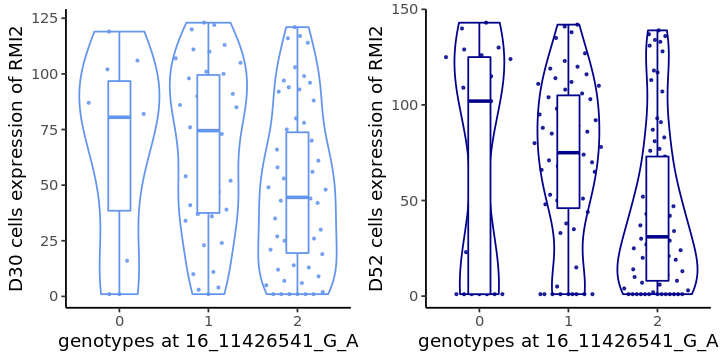

[1] -0.60177


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

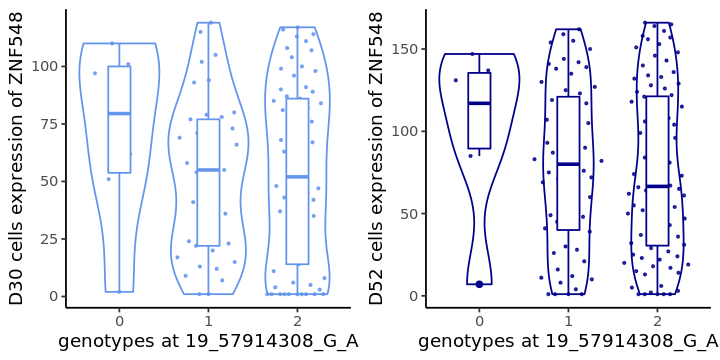

[1] -0.6010539


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

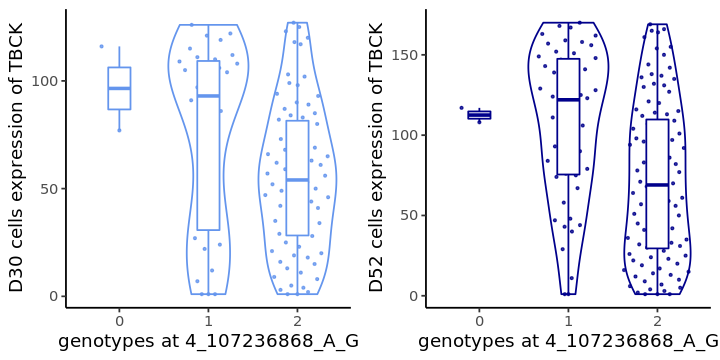

[1] -0.5998275


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

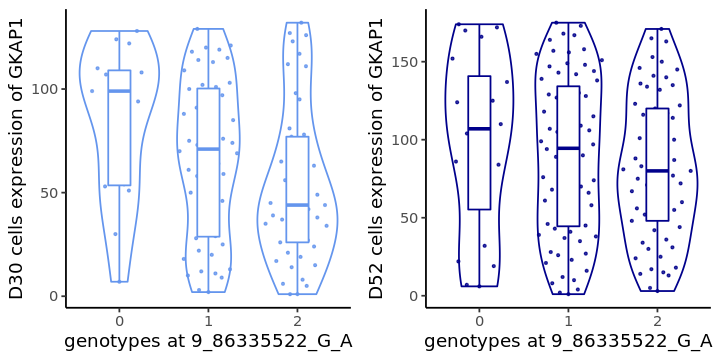

[1] 0.5971216


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

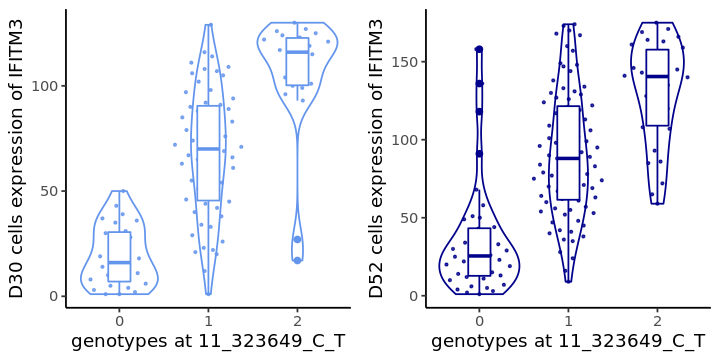

[1] -0.5934451


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

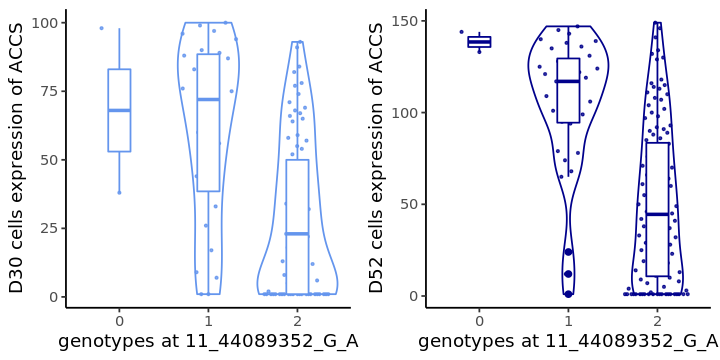

[1] 0.5931517


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

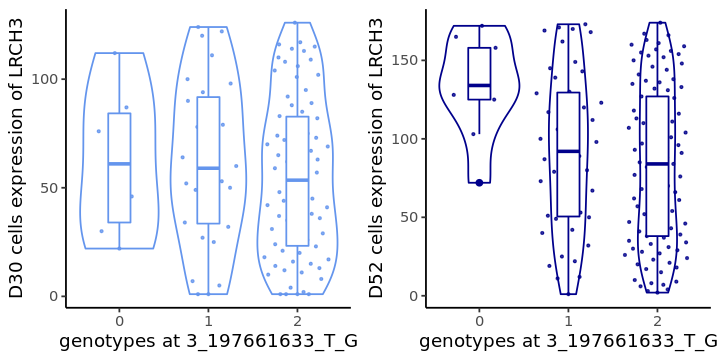

[1] -0.5891911


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

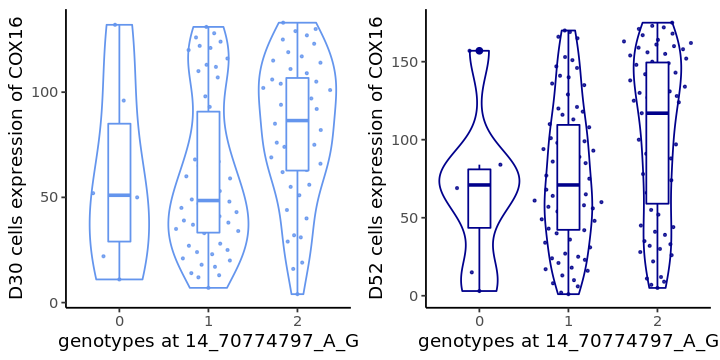

[1] 0.5872493


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

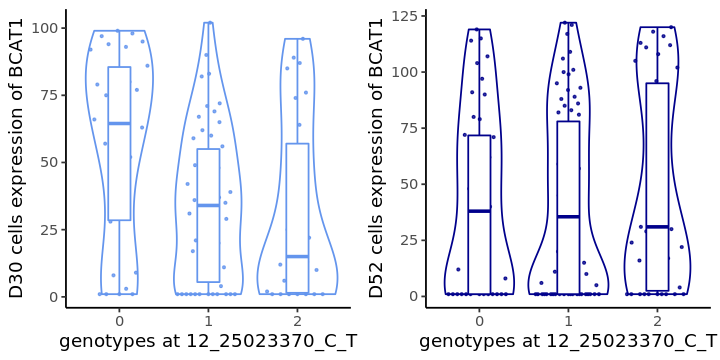

[1] -0.5865852


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

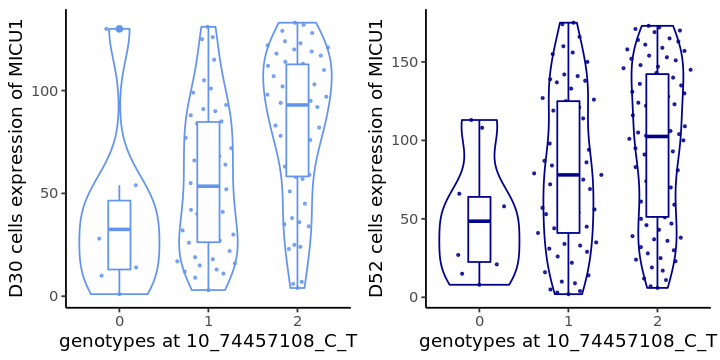

[1] -0.5838253


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

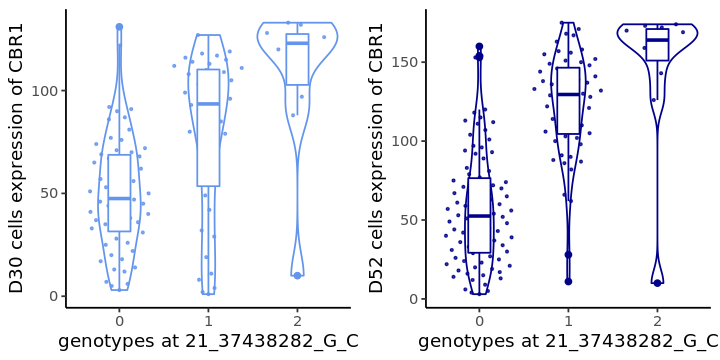

[1] 0.5834587


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

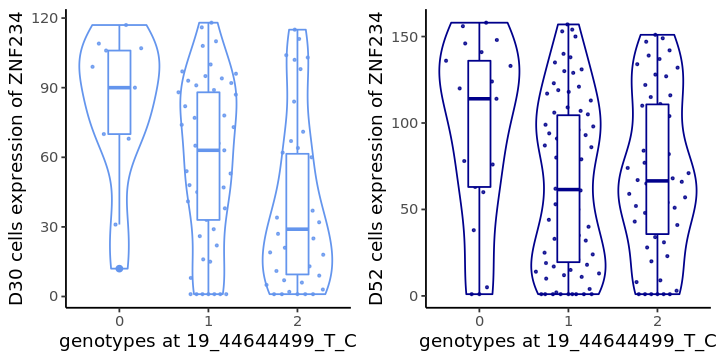

[1] -0.5829206


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

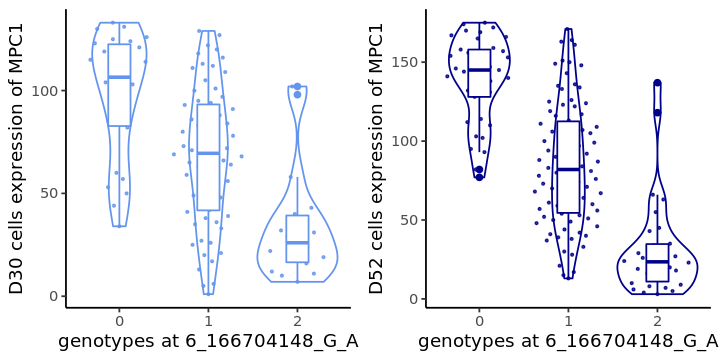

[1] 0.5828657


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

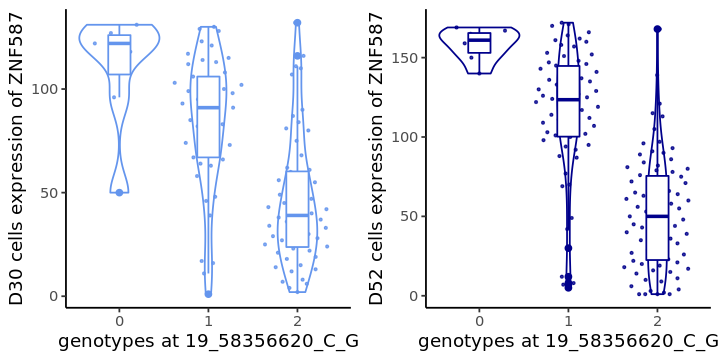

[1] 0.5795284


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

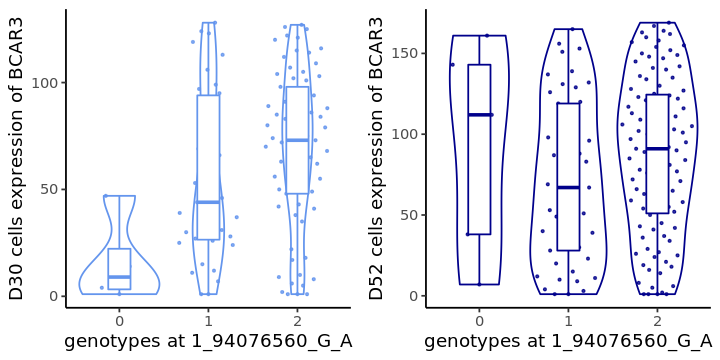

[1] -0.5732511


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

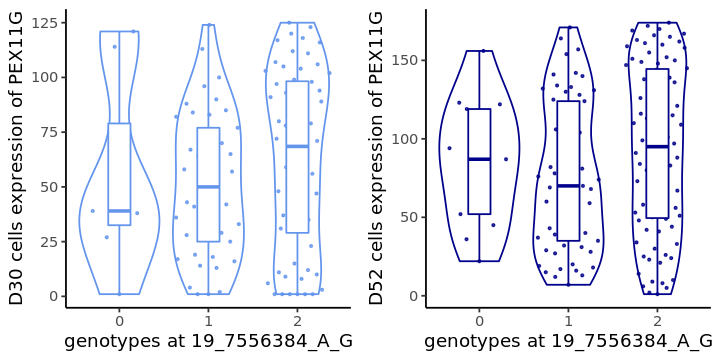

[1] -0.5680449


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

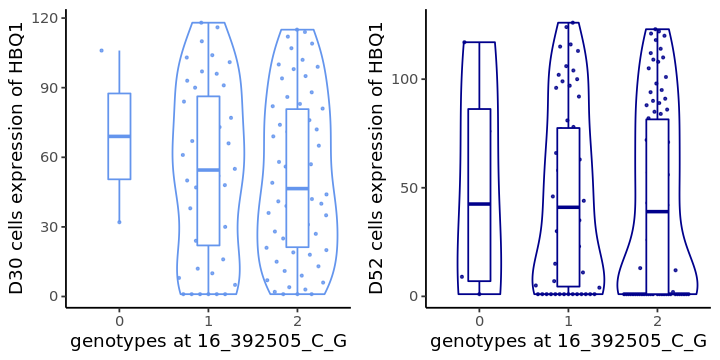

[1] -0.5589123


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

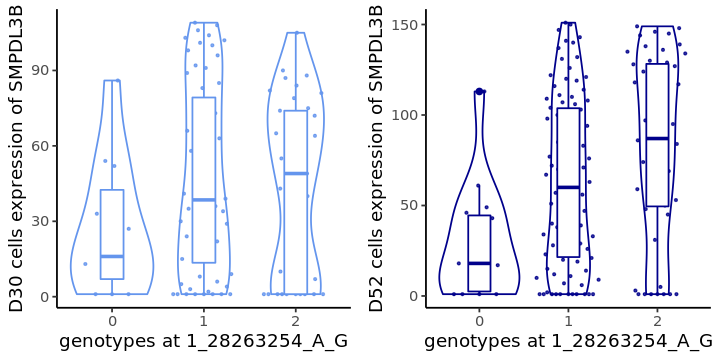

[1] 0.5560009


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

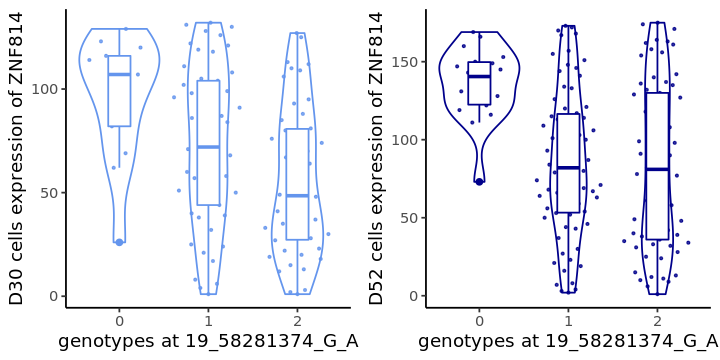

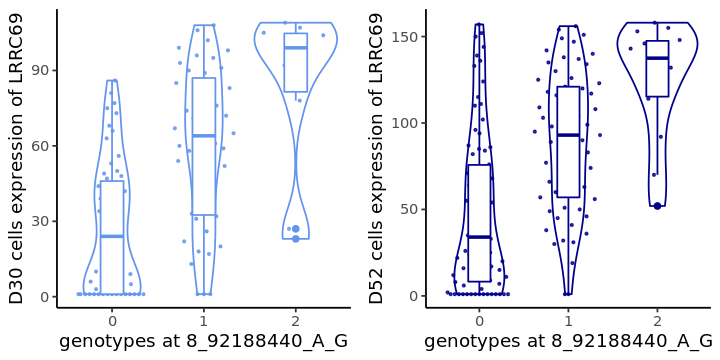

[1] -0.5468858


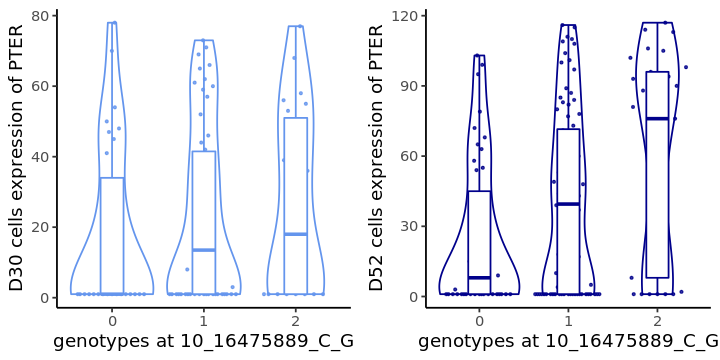

In [281]:
# res = sign_Epen1_mat[order(sign_Epen1_mat$q_value),]
res = sign_Epen1_mat[order(abs(sign_Epen1_mat$beta),decreasing = T),]
e_D30 = read.csv(paste0(mydir,Epen1_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Epen1_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id

for (i in 1:50){
    snp = res[i,"snp_id"]
    gene = res[i,"hgnc_symbol"]
    print(Boxplot_timepoint(gene,snp))
    print(res[i,"beta"])
}

In [39]:
# Astro
day_inter_Astro = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files/celltype_Astro/top_qtl_results_all.txt"
int_Astro2 = read.csv(day_inter_Astro,sep="\t")
# head(int_Astro2,2)
nrow(int_Astro2)
# length(unique(int_Astro2$feature_id))
int_Astro2$q_value = p.adjust(int_Astro2$p_value, "BH")
nrow(int_Astro2[int_Astro2$q_value < 0.05,])
# head(int_Astro2[order(int_Astro2$q_value),])

[1] 3372

[1] 129

In [40]:
sign_Astro_mat = int_Astro2[int_Astro2$q_value < 0.05,]
sign_Astro_mat = add_gene_name(sign_Astro_mat,annos)
head(sign_Astro_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_excluding_ROT_cells/Astro_FDR0.05.tsv"
write.table(sign_Astro_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
2_202004710_G_A,ENSG00000003402_CFLAR
16_19431583_C_T,ENSG00000006007_GDE1


In [41]:
out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/Astro_maturation_noROT_FDR0.05_egenes.tsv"
write.table(sign_Astro_mat[,c("hgnc_symbol")],out_file, quote = F, col.names = F, row.names = F)

In [154]:
### timepoint or maturation (from D30 to D52, including treated D52 cells)

In [228]:
## DA
day_inter_DA2 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files_ROT/celltype_DA/top_qtl_results_all.txt"
int_DA3 = read.csv(day_inter_DA2,sep="\t")
# head(int_DA3,2)
nrow(int_DA3)
# length(unique(int_DA3$feature_id))
int_DA3$q_value = p.adjust(int_DA3$p_value, "BH")
nrow(int_DA3[int_DA3$q_value < 0.1,])
# head(int_DA3[order(int_DA3$q_value),])

[1] 3210

[1] 346

In [230]:
sign_DA_mat = int_DA3[int_DA3$q_value < 0.1,]
sign_DA_mat = add_gene_name(sign_DA_mat,annos)
head(sign_DA_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_including_ROT_cells/DA_FDR0.1.tsv"
write.table(sign_DA_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
1_24719691_G_A,ENSG00000001460_STPG1
7_127345936_G_A,ENSG00000004059_ARF5


In [231]:
# Sert
day_inter_Sert2 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files_ROT/celltype_Sert/top_qtl_results_all.txt"
int_Sert3 = read.csv(day_inter_Sert2,sep="\t")
# head(int_Sert3,2)
nrow(int_Sert3)
# length(unique(int_Sert3$feature_id))
int_Sert3$q_value = p.adjust(int_Sert3$p_value, "BH")
nrow(int_Sert3[int_Sert3$q_value < 0.1,])
# head(int_Sert3[order(int_Sert3$q_value),])

[1] 3399

[1] 515

In [232]:
sign_Sert_mat = int_Sert3[int_Sert3$q_value < 0.1,]
sign_Sert_mat = add_gene_name(sign_Sert_mat,annos)
head(sign_Sert_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_including_ROT_cells/Sert_FDR0.1.tsv"
write.table(sign_Sert_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
2_37566376_A_G,ENSG00000003509_NDUFAF7
7_38816635_G_A,ENSG00000006715_VPS41


In [233]:
# Epen1
day_inter_Epen1.2 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files_ROT/celltype_Epen1/top_qtl_results_all.txt"
int_Epen1.3 = read.csv(day_inter_Epen1.2,sep="\t")
# head(int_Epen1.3,2)
nrow(int_Epen1.3)
# length(unique(int_Epen1.3$feature_id))
int_Epen1.3$q_value = p.adjust(int_Epen1.3$p_value, "BH")
nrow(int_Epen1.3[int_Epen1.3$q_value < 0.1,])
# head(int_Epen1.3[order(int_Epen1.3$q_value),])

[1] 3435

[1] 387

In [234]:
sign_Epen1_mat = int_Epen1.3[int_Epen1.3$q_value < 0.1,]
sign_Epen1_mat = add_gene_name(sign_Epen1_mat,annos)
head(sign_Epen1_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_including_ROT_cells/Epen1_FDR0.1.tsv"
write.table(sign_Epen1_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
16_89688617_A_G,ENSG00000015413_DPEP1
3_53847408_A_G,ENSG00000016391_CHDH


In [235]:
# Astro
day_inter_Astro2 = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/timepoint_D30_D52/input_files_ROT/celltype_Astro/top_qtl_results_all.txt"
int_Astro3 = read.csv(day_inter_Astro2,sep="\t")
# head(int_Astro3,2)
nrow(int_Astro3)
# length(unique(int_Astro3$feature_id))
int_Astro3$q_value = p.adjust(int_Astro3$p_value, "BH")
nrow(int_Astro3[int_Astro3$q_value < 0.1,])
# head(int_Astro3[order(int_Astro3$q_value),])

[1] 3371

[1] 219

In [236]:
sign_Astro_mat = int_Astro3[int_Astro3$q_value < 0.1,]
sign_Astro_mat = add_gene_name(sign_Astro_mat,annos)
head(sign_Astro_mat[,c("snp_id","combined_feature_id")],2)

out_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/eqtl/interaction_qtl/egenes/maturation_including_ROT_cells/Astro_FDR0.1.tsv"
write.table(sign_Astro_mat[,c("snp_id","combined_feature_id")],out_file, quote = F, col.names = T, row.names = F)

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”

snp_id,combined_feature_id
<fct>,<fct>
4_17569327_T_G,ENSG00000002549_LAP3
2_201997292_G_A,ENSG00000003402_CFLAR


In [159]:
# plot (bars with how many interactions)
# plot interactions (x axis: interaction term, y axis: expression, colour: genotype)
# plot interactions (2 boxplots for treated/untreated, D30/D52)

In [160]:
# match ensembl gene ids to names and annotate co-localisation results (N's spreadhseet)

In [13]:
annos_file = "/hps/nobackup/hipsci/scratch/singlecell_endodiff/data_processed/scQTLs/annos/combined_feature_id_annos.tsv"

annos = read.csv(annos_file,sep="\t")
head(annos,2)
annos$feature_id = annos$ensembl_gene_id
head(annos,2)

In [15]:
# open coloc genes resulst
coloc_file = "/hps/nobackup/stegle/users/acuomo/all_scripts/sc_neuroseq/coloc/coloc_genes.csv"
coloc = read.csv(coloc_file)
head(coloc)

Category,GWAS,Gene,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
N,SCZ2,WBP1L,pool1_17_D52.DA,Brain_Putamen_basal_ganglia,Colon_Transverse,
N,Alzheimer's disease (late onset),EIF2B2,pool1_17_D52.DA,Brain_Cerebellum,Vagina,
N,Educational attainment,ETFDH,pool1_17_D52.DA,Brain_Substantia_nigra,Whole_Blood,
N,Neuroticism,LRRC37A2,pool1_17_D52.DA,Brain_Cerebellar_Hemisphere,Esophagus_Muscularis,
N,Neuroticism,NIPSNAP1,pool1_17_D52.DA,Brain_Cerebellum,Small_Intestine_Terminal_Ileum,
N,Depressed affect,LRRC37A2,pool1_17_D52.DA,Brain_Hypothalamus,Heart_Atrial_Appendage,


In [9]:
add_gene_name <- function(res,annos){
    annos = annos[,c("feature_id","combined_feature_id","hgnc_symbol")]
    res2 = left_join(res, annos, by = "feature_id")
    res2
}

In [10]:
annotate_int <- function(res, celltype, int_type, T = 0.1){
    res[[paste0("int_",int_type,"_",celltype)]] = 0
    res[res$q_value < T,paste0("int_",int_type,"_",celltype)] = 1
    res = res[order(res$q_value),]
    res
}

In [11]:
add_coloc_results <- function(res,coloc){
    res$Gene = res$hgnc_symbol
#     res = res[,c("snp_id","combined_feature_id","q_value","Gene","int")]
    res2 = inner_join(res, coloc, by = "Gene")
    res2
}

In [167]:
# treatment 

In [237]:
res = int_DA
res = add_gene_name(res,annos)
res = annotate_int(res,"DA","treatment")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 1


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

[1] 2


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

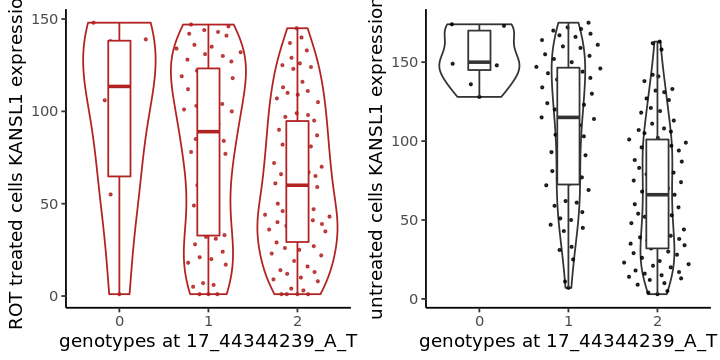

[1] 3


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

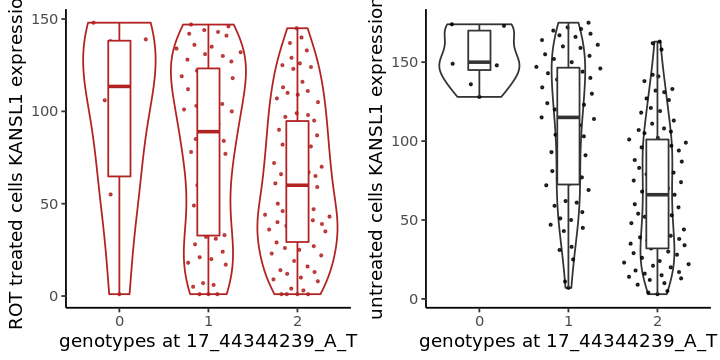

[1] 4


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

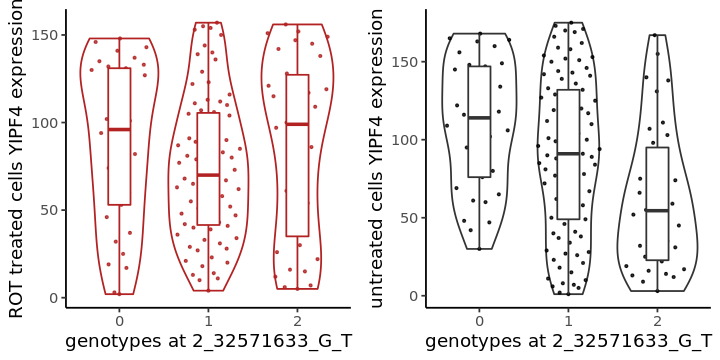

[1] 5


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

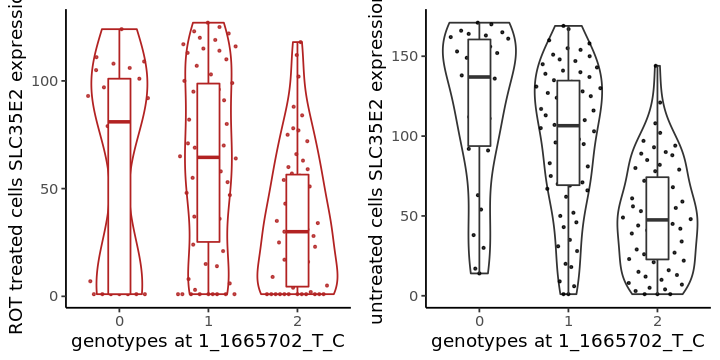

[1] 6


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

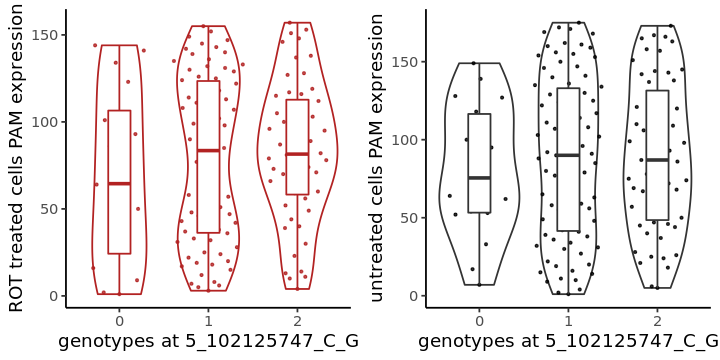

[1] 7


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

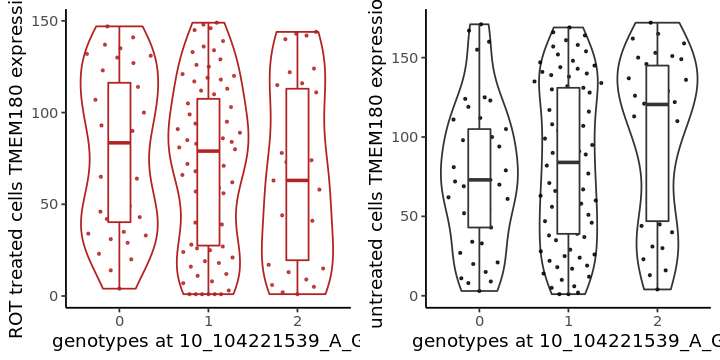

[1] 8


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

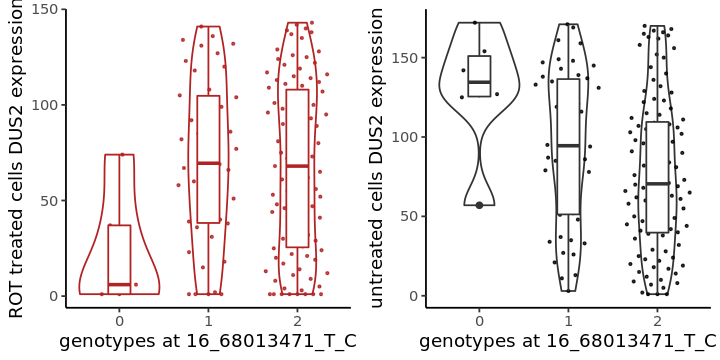

[1] 9


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

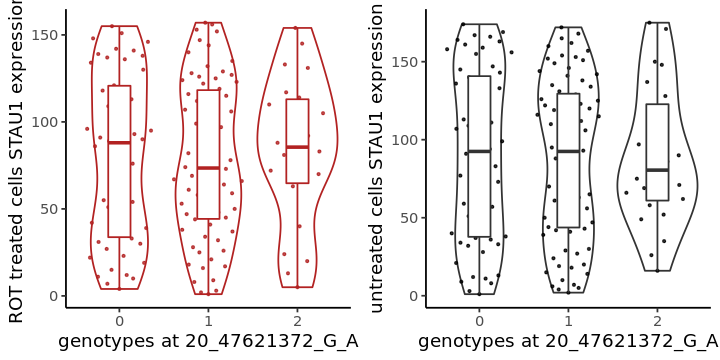

[1] 10


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

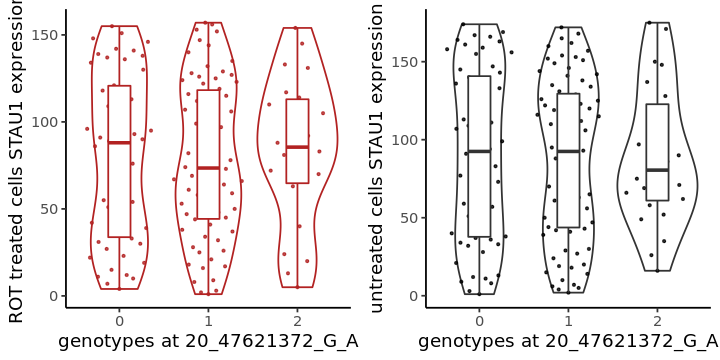

[1] 11


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

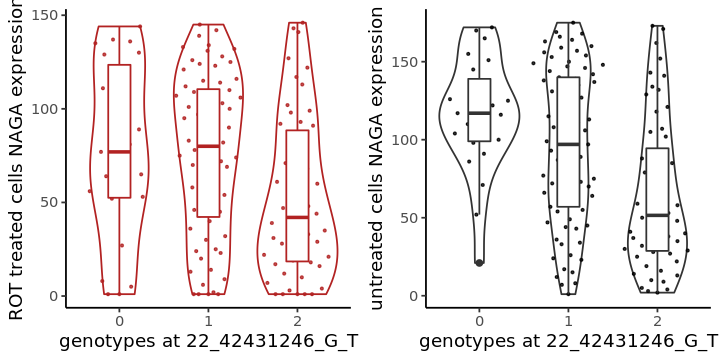

[1] 12


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

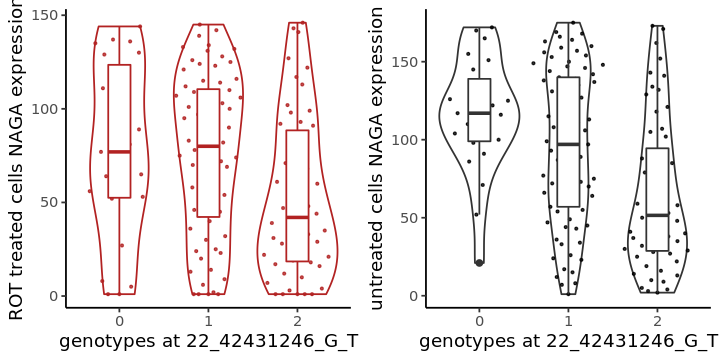

[1] 13


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

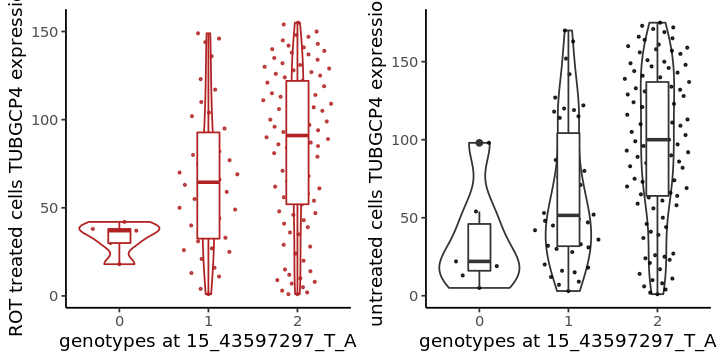

[1] 14


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

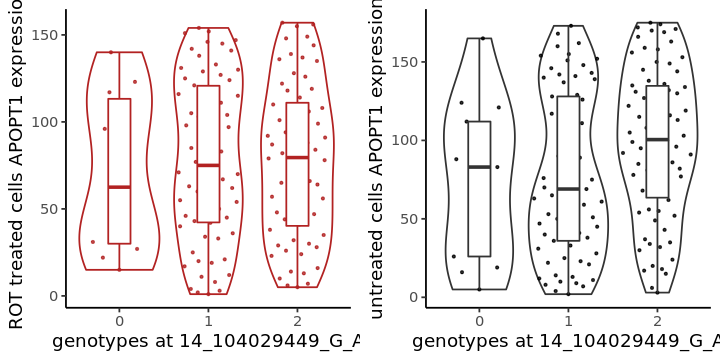

[1] 15


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

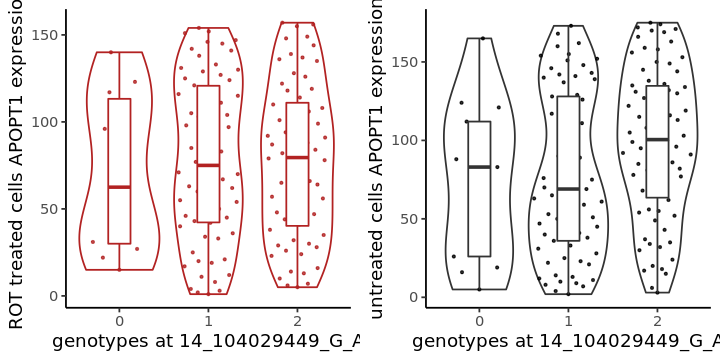

[1] 16


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

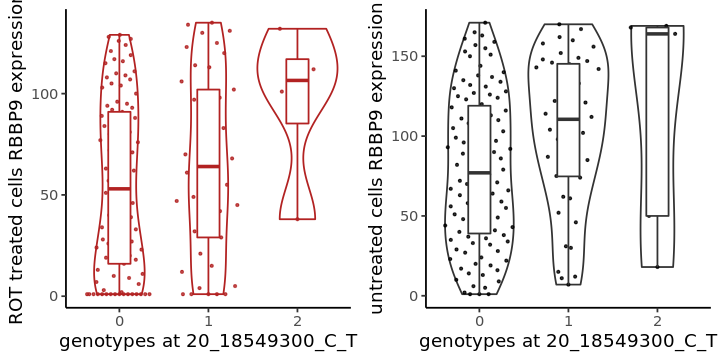

[1] 17


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

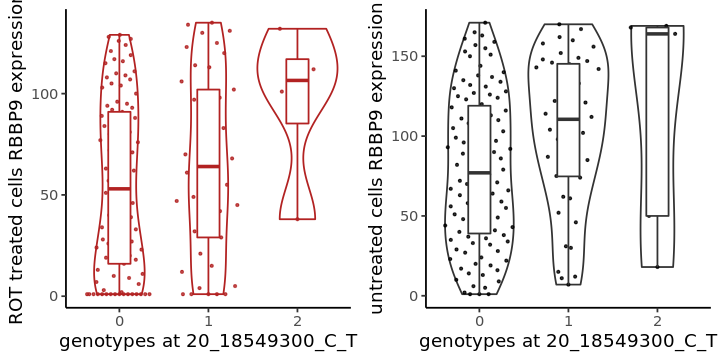

[1] 18


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

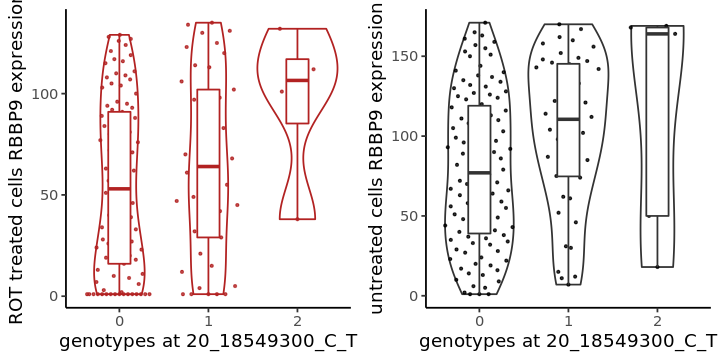

[1] 19


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

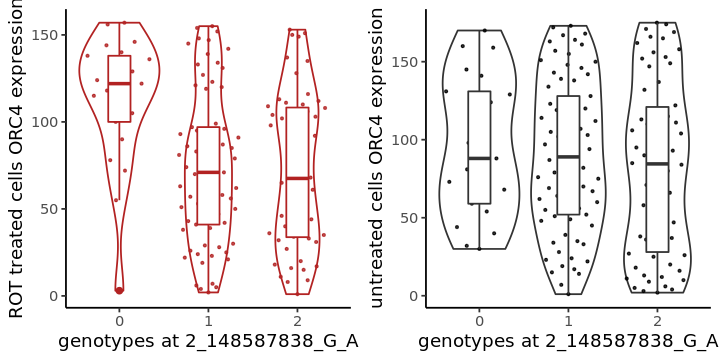

[1] 20


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

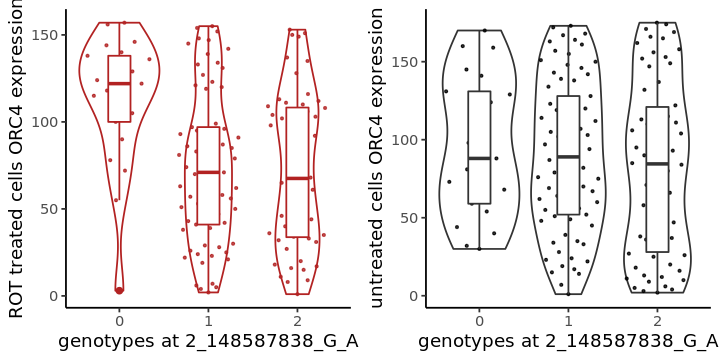

[1] 21


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

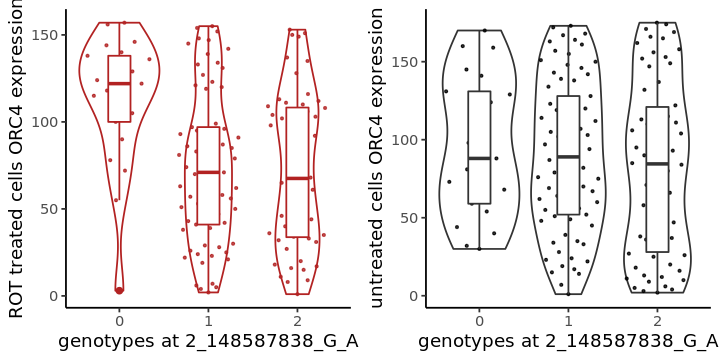

[1] 22


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

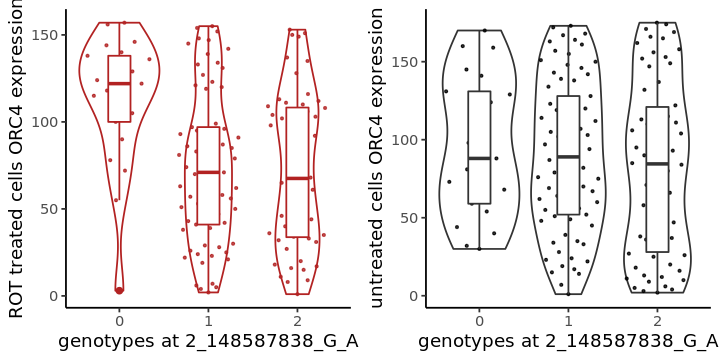

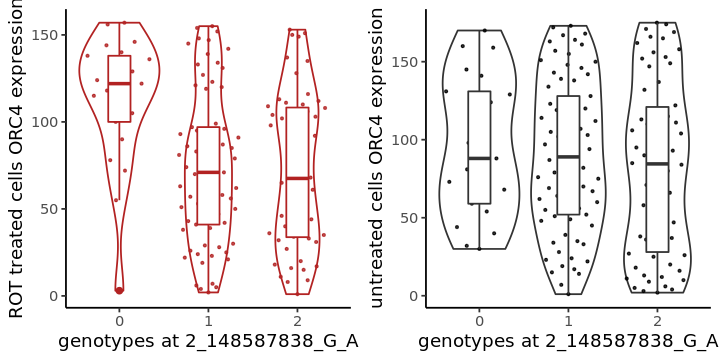

[1] 23


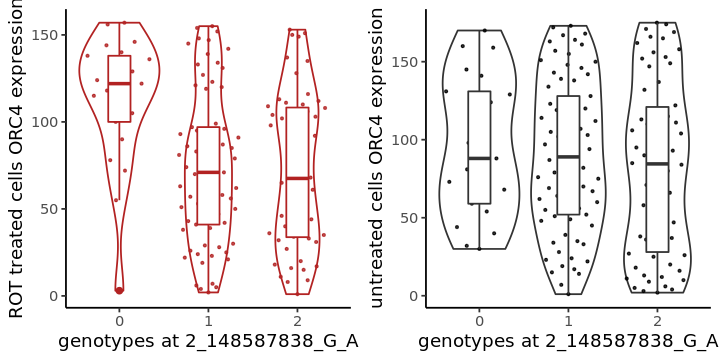

In [238]:
res = res[res[[grep("int",colnames(res))]]==1,]
# nrow(res)
e = e_DA
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_treatment(gene,snp))
#     print(i)
}

In [186]:
res = int_Sert
res = add_gene_name(res,annos)
res = annotate_int(res,"Sert","treatment")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

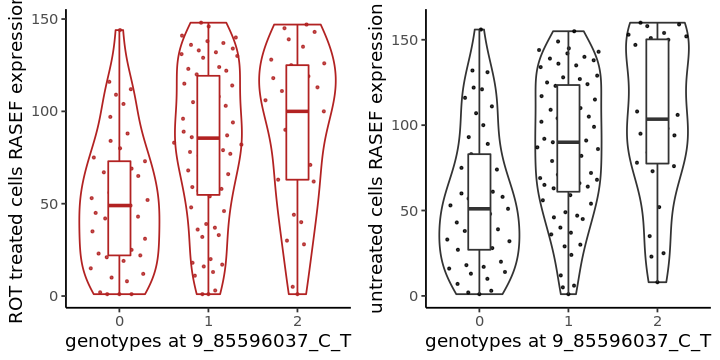

ERROR: Error in names(x) <- value: 'names' attribute [2] must be the same length as the vector [1]


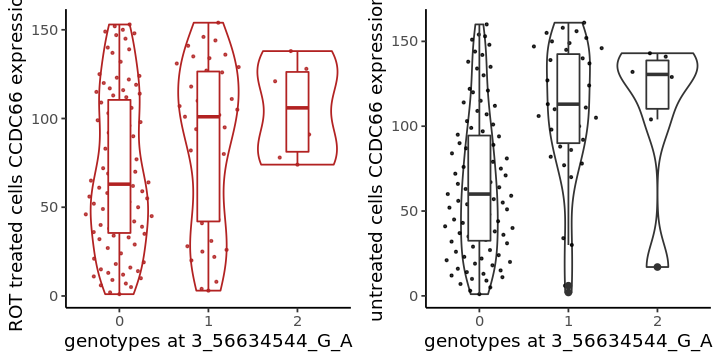

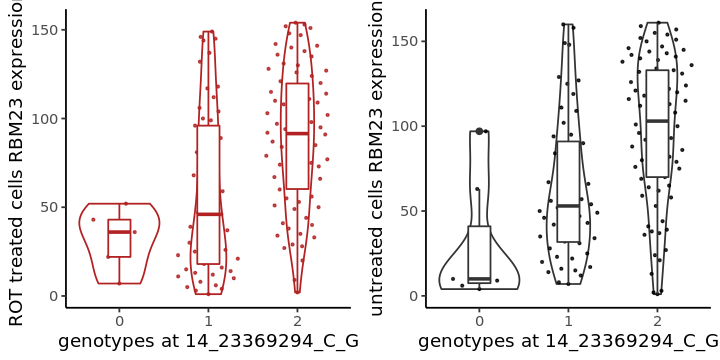

In [187]:
res = res[res[[grep("int",colnames(res))]]==1,]
e = e_Sert
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_treatment(gene,snp))
#     print(i)
}

In [192]:
res = int_Epen1
res = add_gene_name(res,annos)
res = annotate_int(res,"Epen1","treatment")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

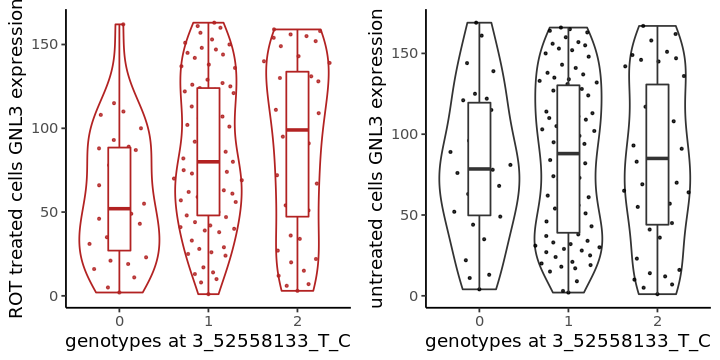

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

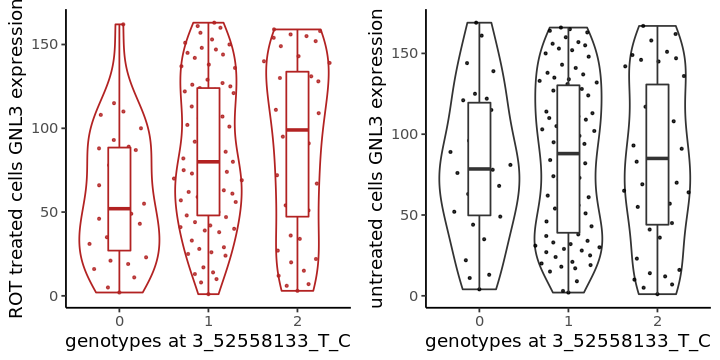

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

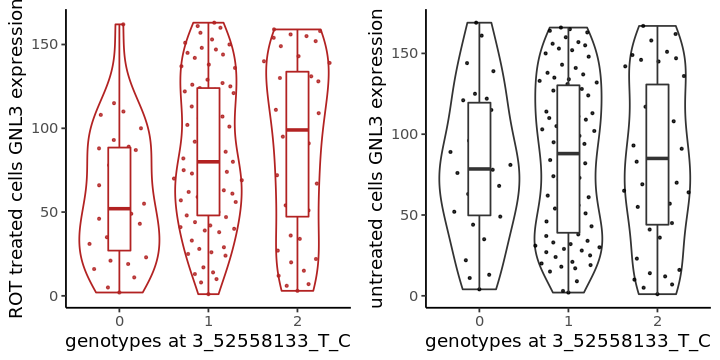

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

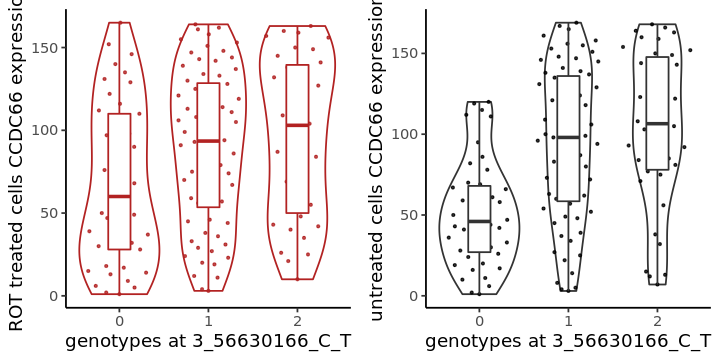

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

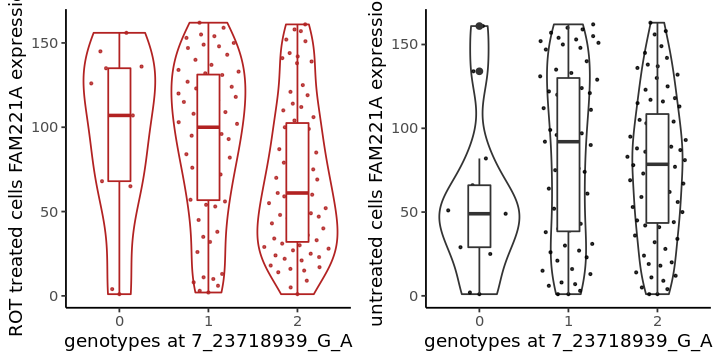

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

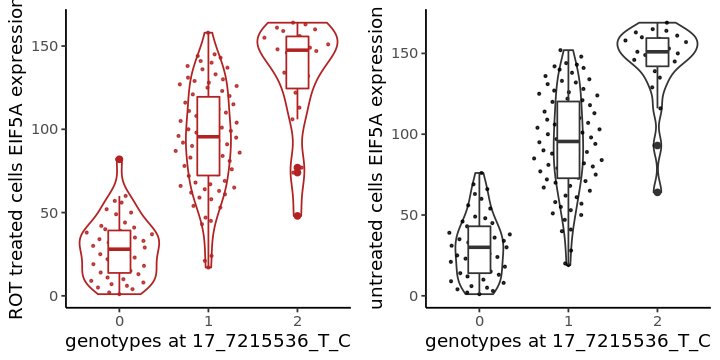

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

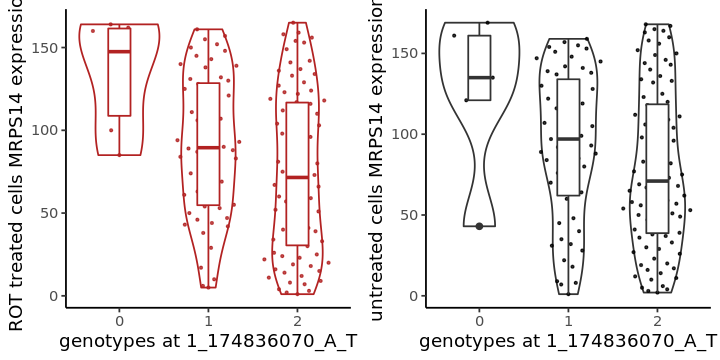

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

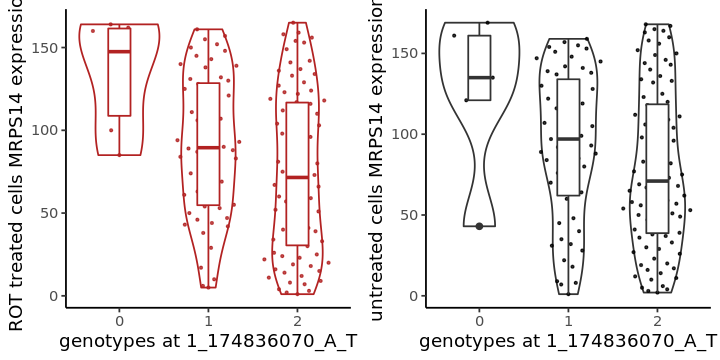

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

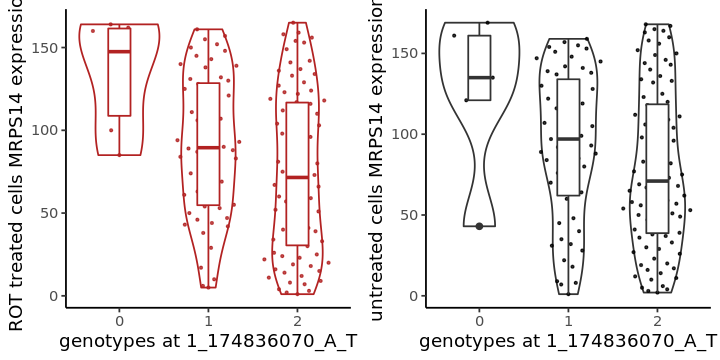

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

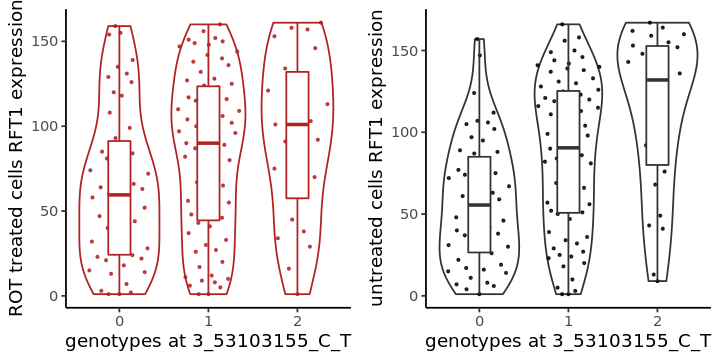

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

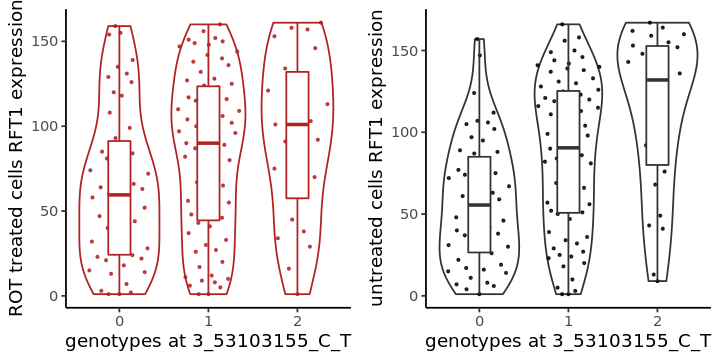

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

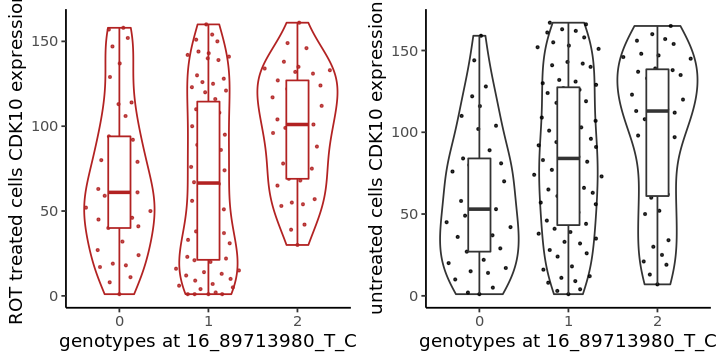

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

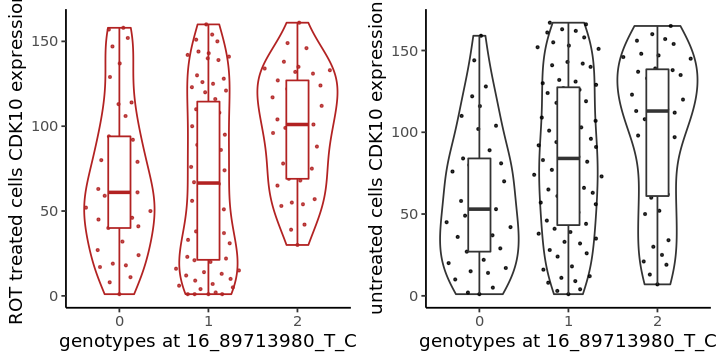

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

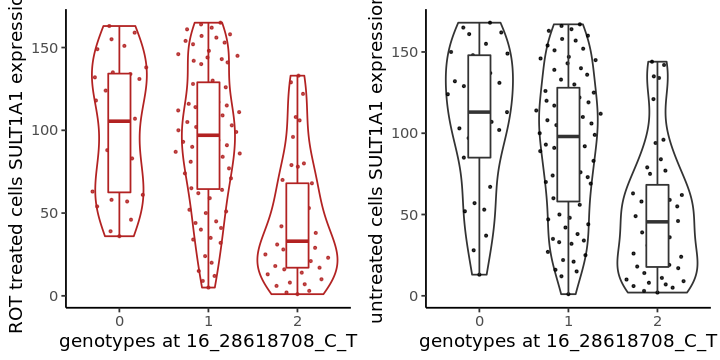

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

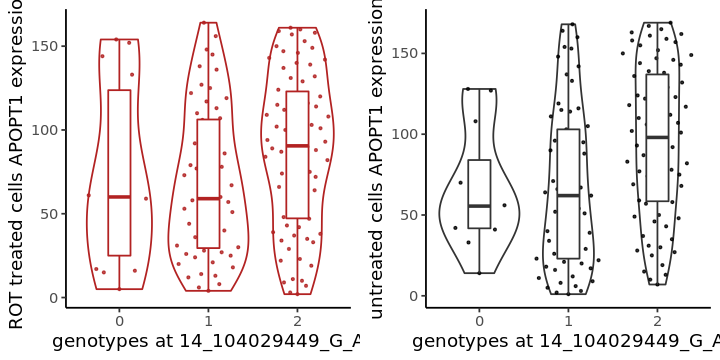

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

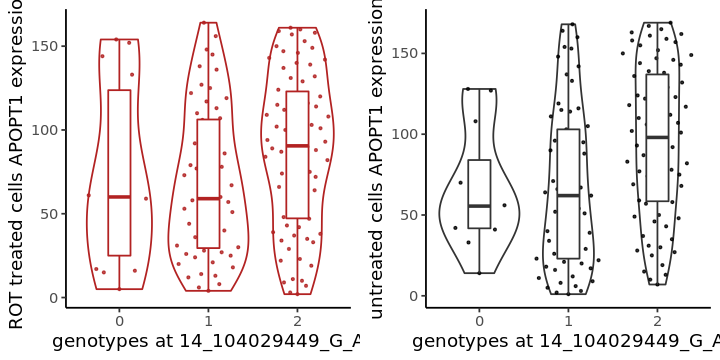

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

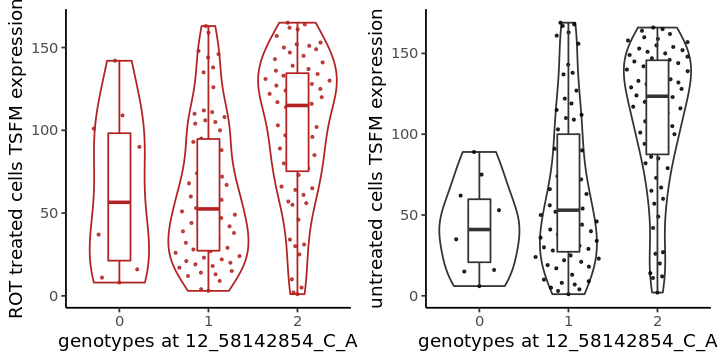

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

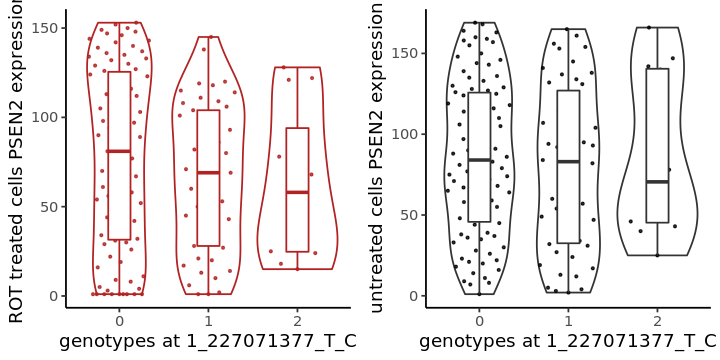

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

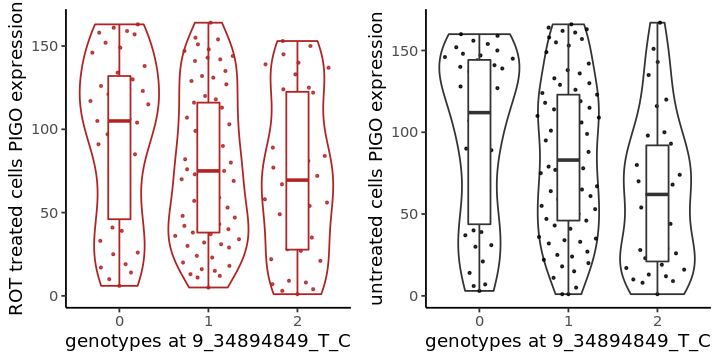

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

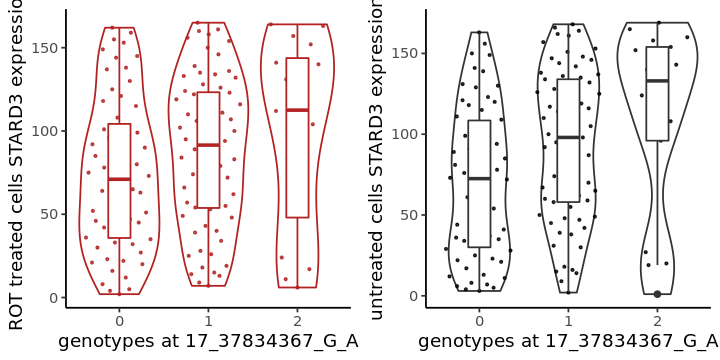

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

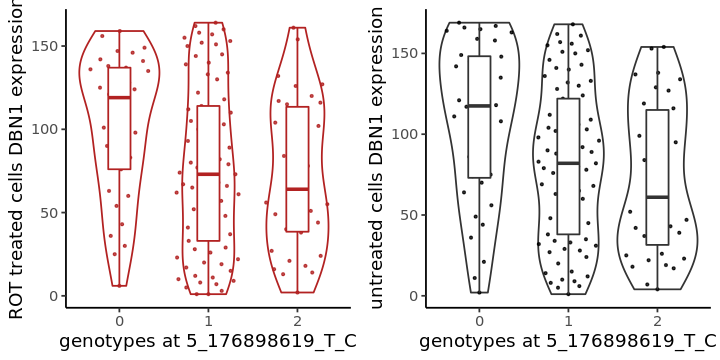

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

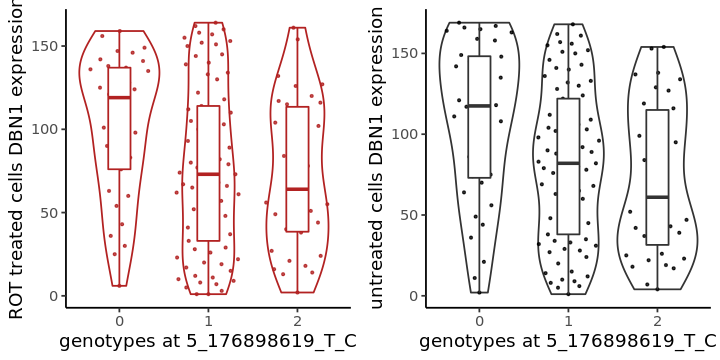

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

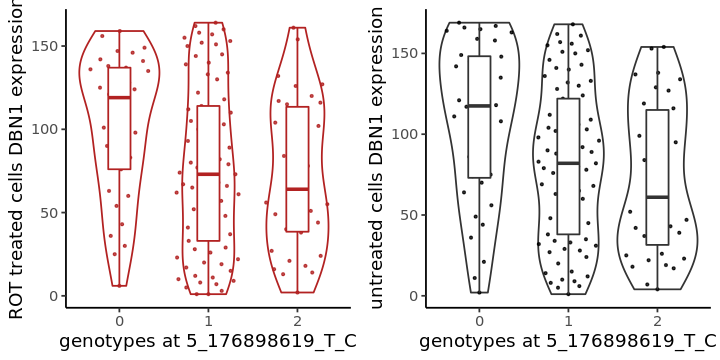

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

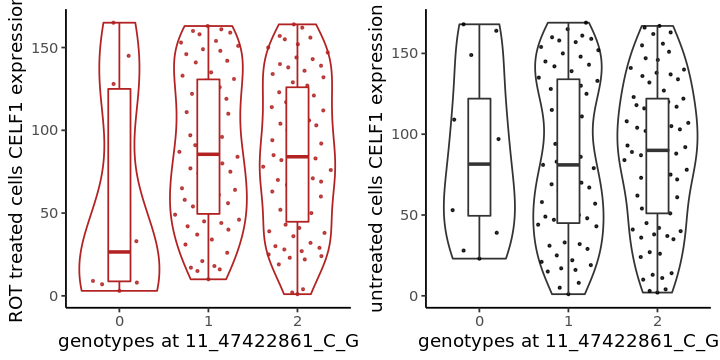

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

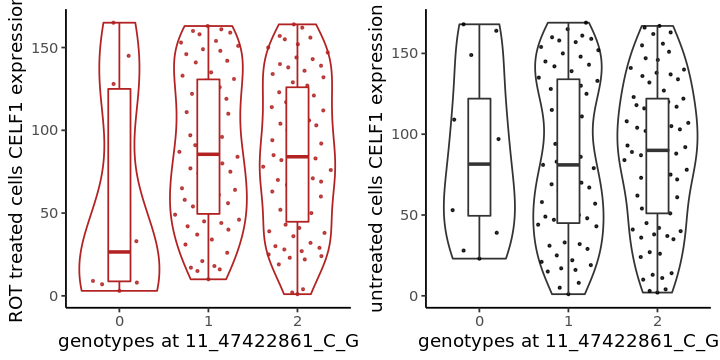

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

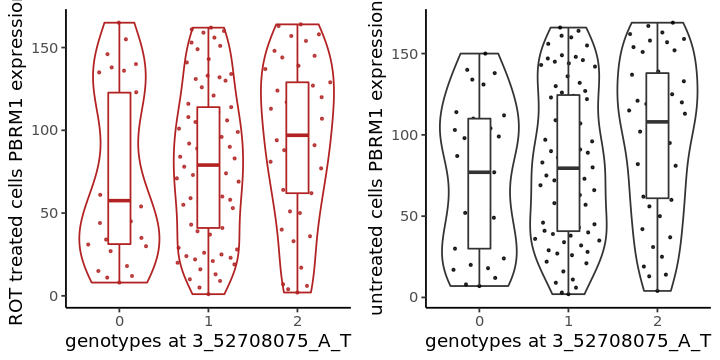

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

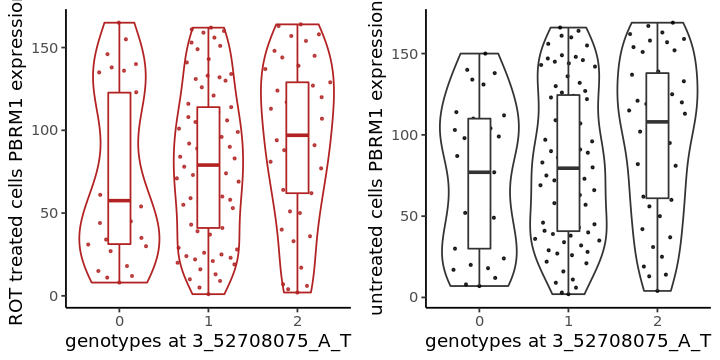

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

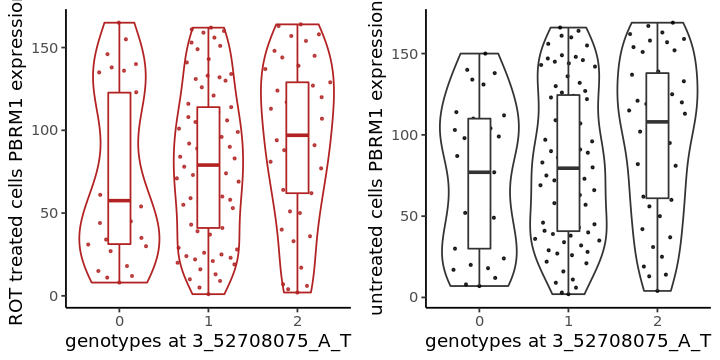

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

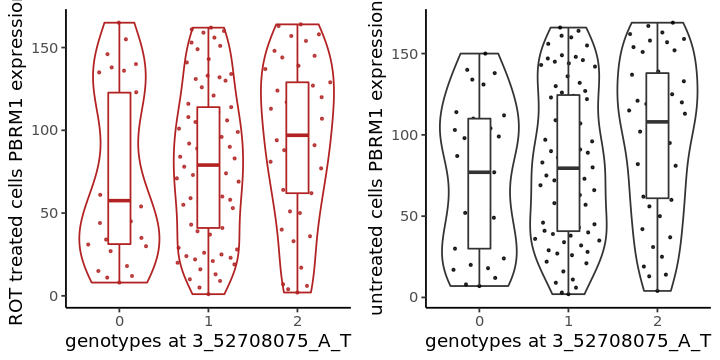

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

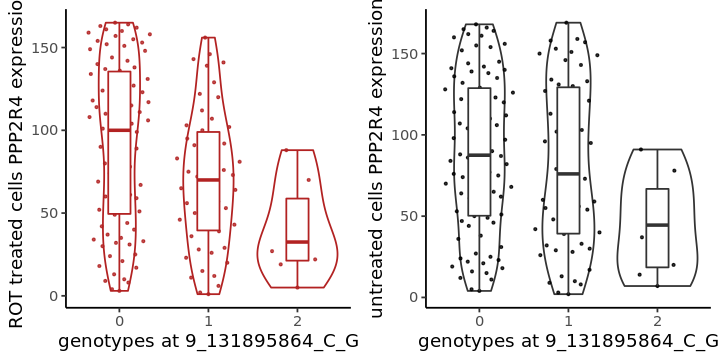

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

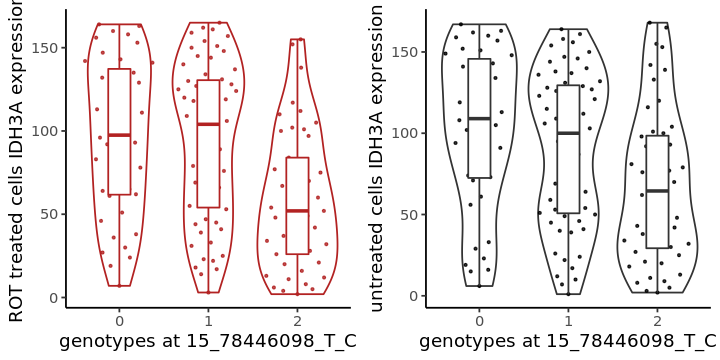

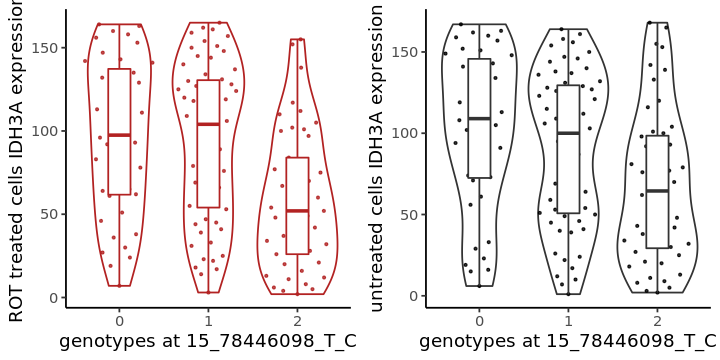

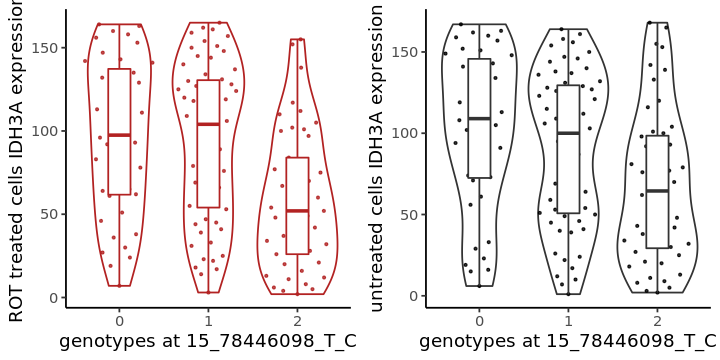

In [193]:
res = res[res[[grep("int",colnames(res))]]==1,]
e = e_Epen1
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_treatment(gene,snp))
#     print(i)
}

In [140]:
res = int_Astro
res = add_gene_name(res,annos)
res = annotate_int(res,"Astro","treatment")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_treatment_Astro,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N,Neuroticism,pool1_17_D52.DA,Brain_Cerebellar_Hemisphere,Esophagus_Muscularis,
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N,Depressed affect,pool1_17_D52.DA,Brain_Hypothalamus,Heart_Atrial_Appendage,
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N-O,PD,pool1_17_D52.DA,Brain_Spinal_cord_cervical_c-1,Cells_Transformed_fibroblasts,
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N-B-O,Nervous feelings,pool1_17_D52.DA,Brain_Cerebellar_Hemisphere,Vagina,
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N-B-O,A levels/AS levels or equivalent | Qualifications,pool1_17_D52.DA,Brain_Cerebellar_Hemisphere,Adipose_Subcutaneous,
17_44848314_G_T,0.0000341528,-0.8358510,0.20170896,-1,17,44588877,44633016,81,81,⋯,ENSG00000238083_LRRC37A2,LRRC37A2,1,LRRC37A2,N-B-O,Educational attainment,pool1_13_noddd_D30.Sert,Brain_Amygdala,Adipose_Subcutaneous,
9_127946320_C_T,0.0001763570,-0.3692889,0.09845924,-1,9,127908852,127952218,81,81,⋯,ENSG00000119414_PPP6C,PPP6C,1,PPP6C,N-B-O,Nervous feelings,pool1_13_noddd_D11.P_FPP,Brain_Caudate_basal_ganglia,Breast_Mammary_Tissue,
9_127946320_C_T,0.0001763570,-0.3692889,0.09845924,-1,9,127908852,127952218,81,81,⋯,ENSG00000119414_PPP6C,PPP6C,1,PPP6C,N-B-O,Neuroticism score,pool1_13_noddd_D11.P_FPP,Brain_Caudate_basal_ganglia,Breast_Mammary_Tissue,
1_38390717_A_C,0.0002188527,0.6023996,0.16297819,-1,1,38422647,38456593,81,81,⋯,ENSG00000183431_SF3A3,SF3A3,1,SF3A3,N,Cognitive performance,pool1_13_noddd_D30.Sert,Brain_Spinal_cord_cervical_c-1,Minor_Salivary_Gland,


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

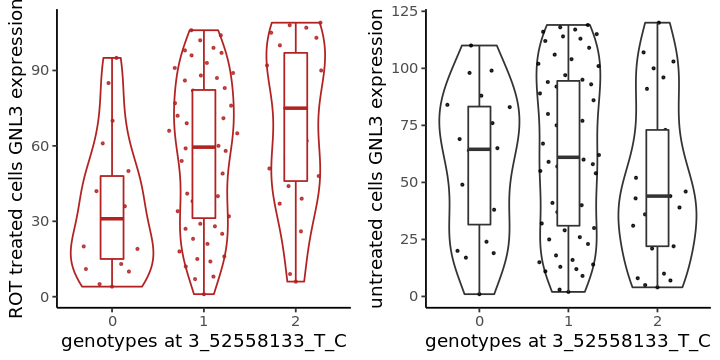

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

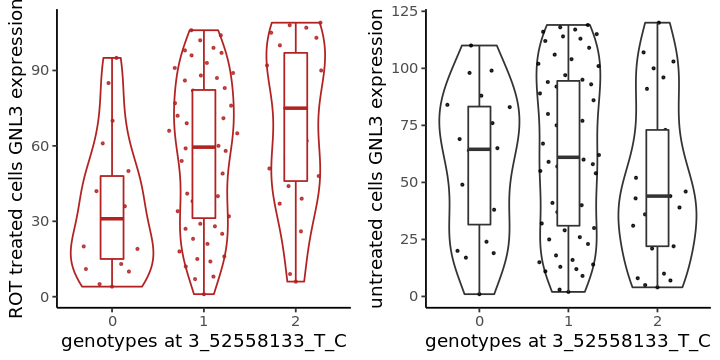

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

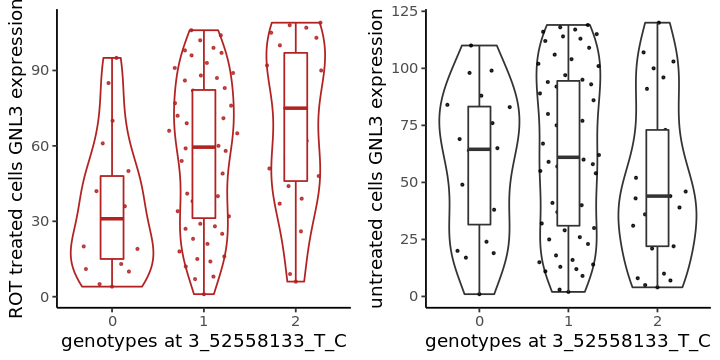

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

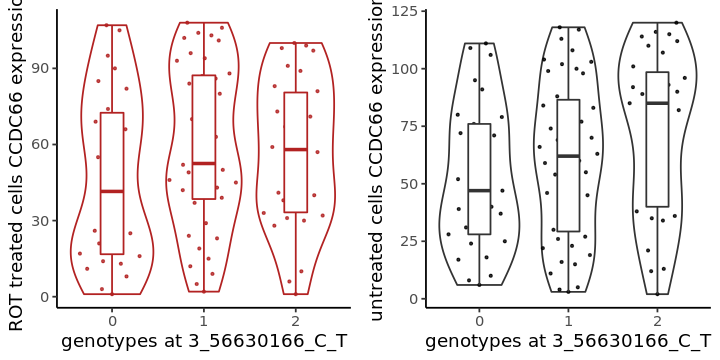

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

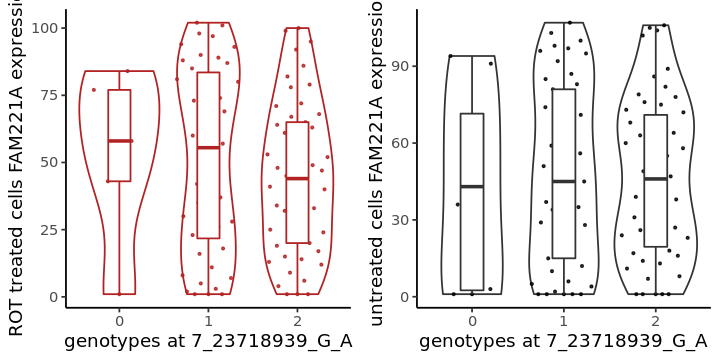

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

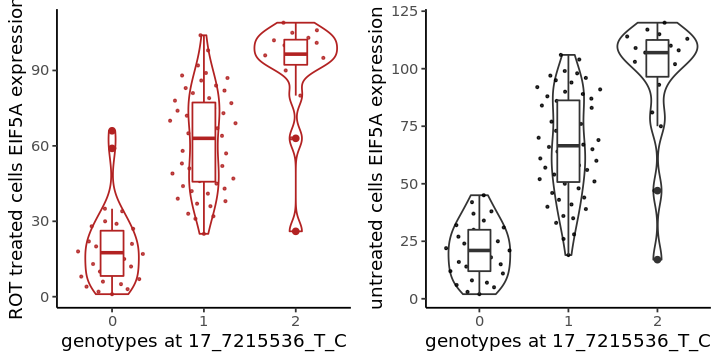

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

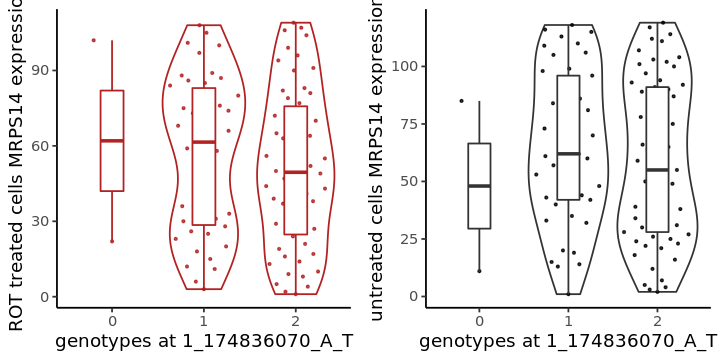

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

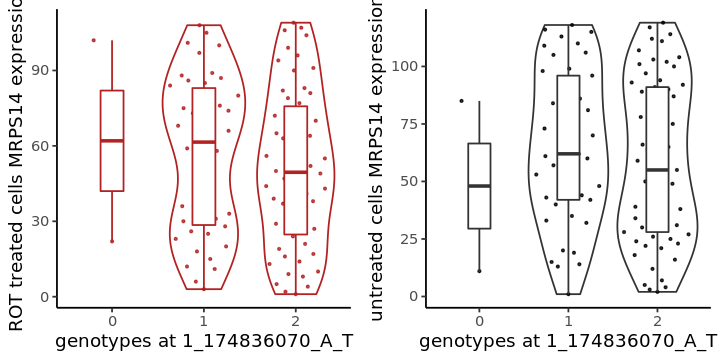

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

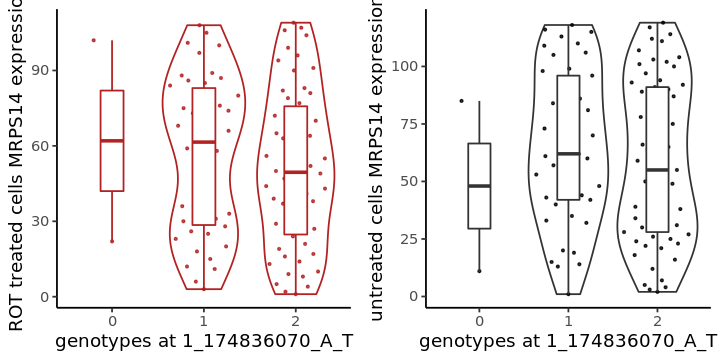

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

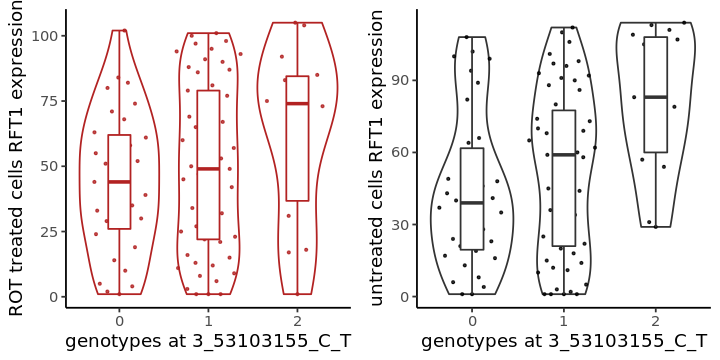

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

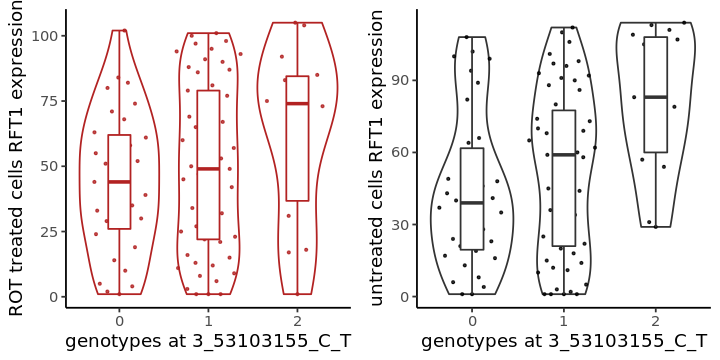

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

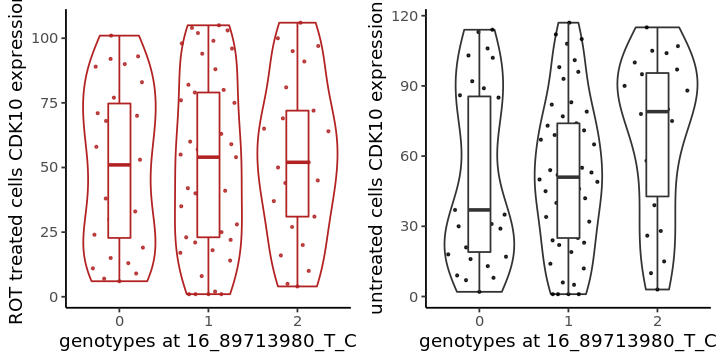

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

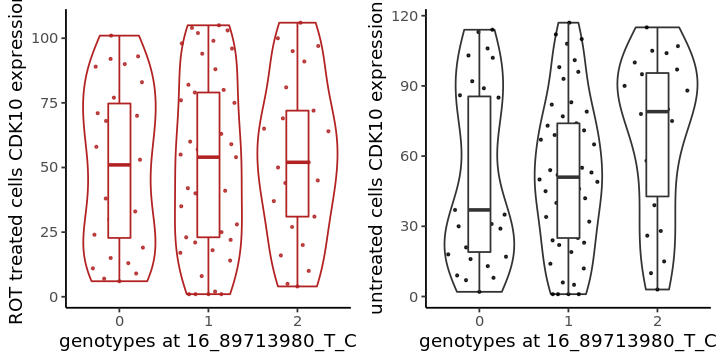

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

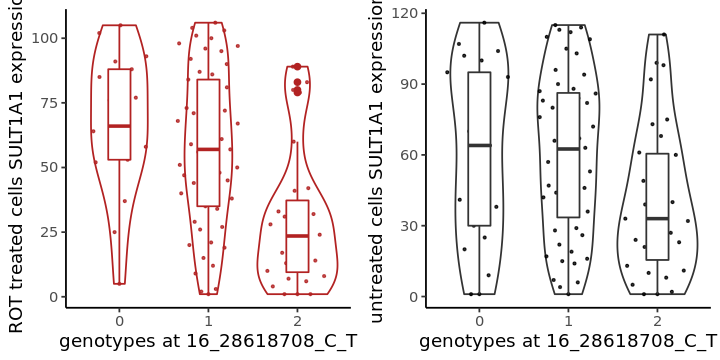

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

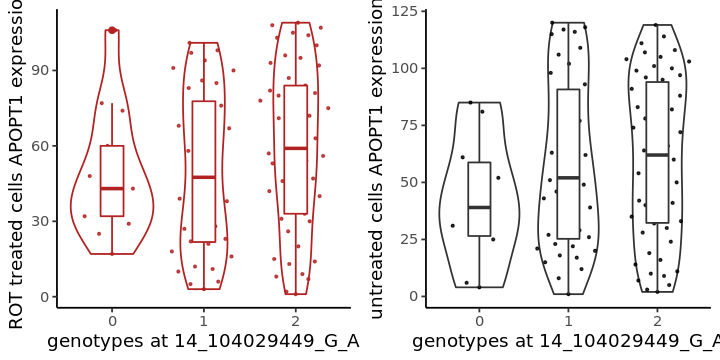

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

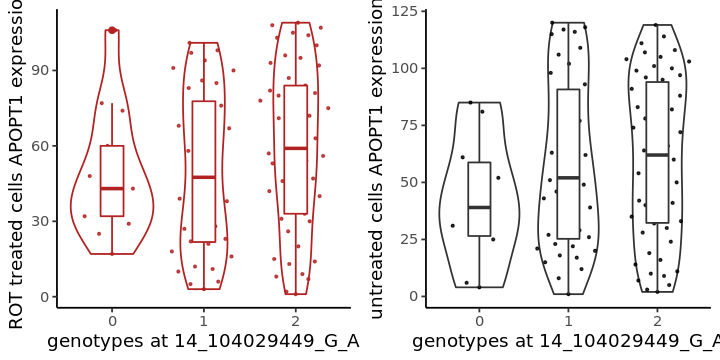

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

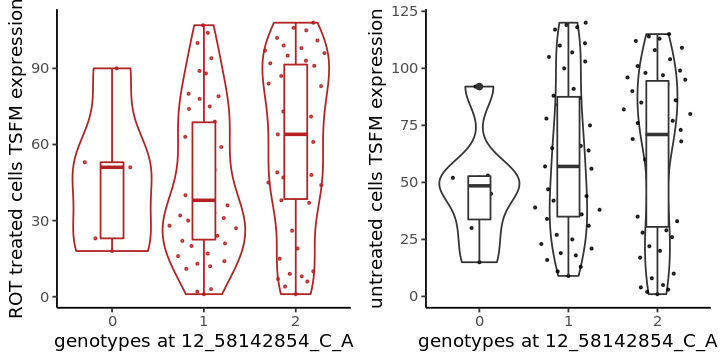

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

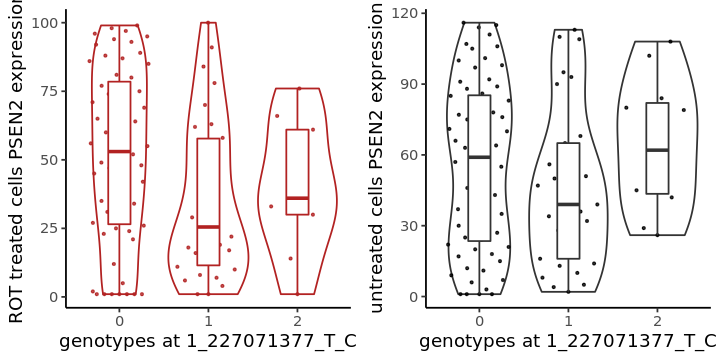

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

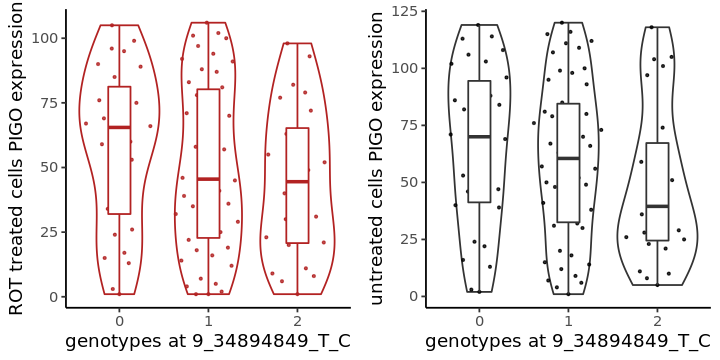

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

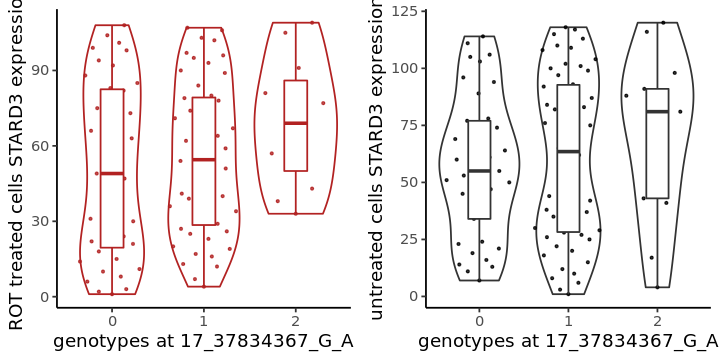

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

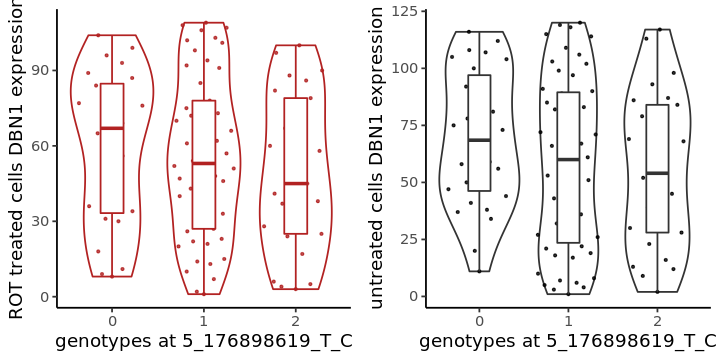

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

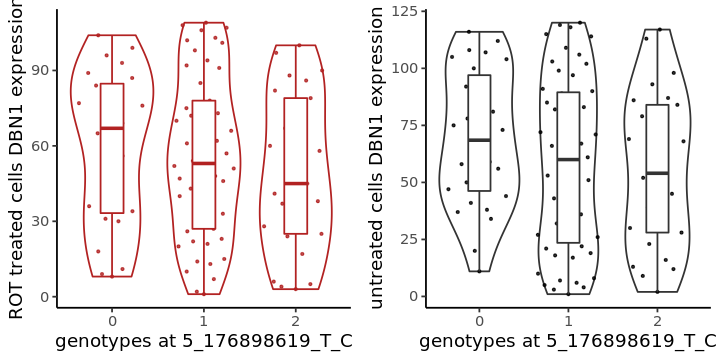

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

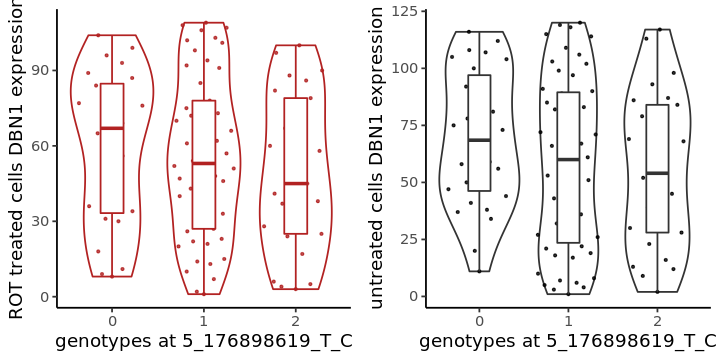

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

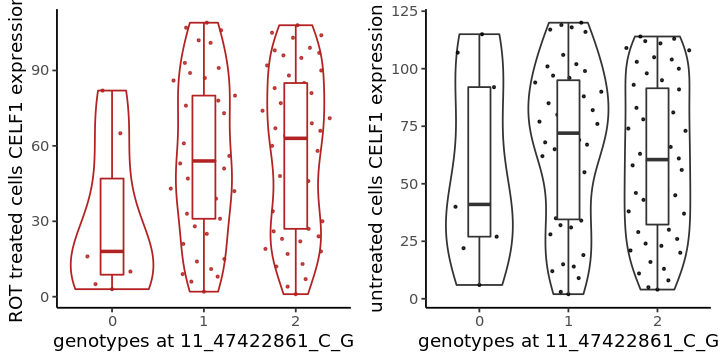

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

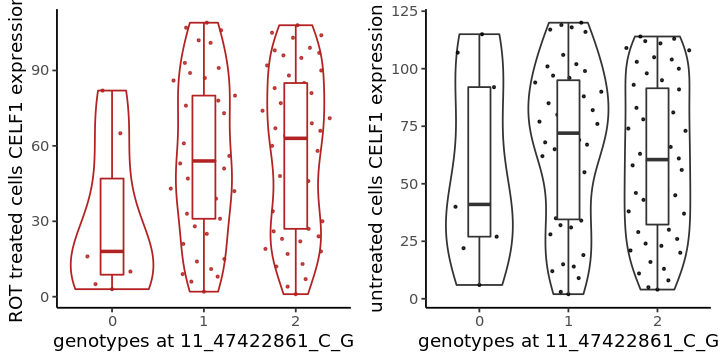

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

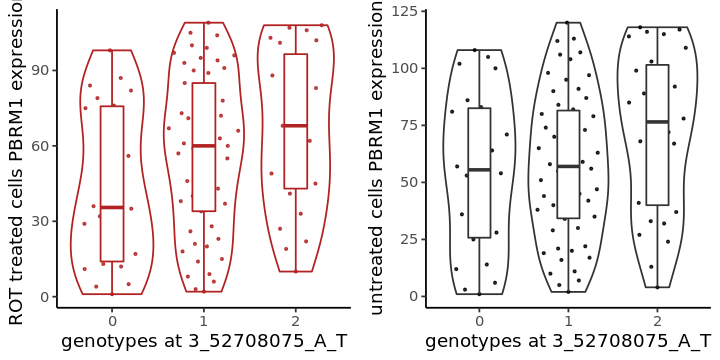

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

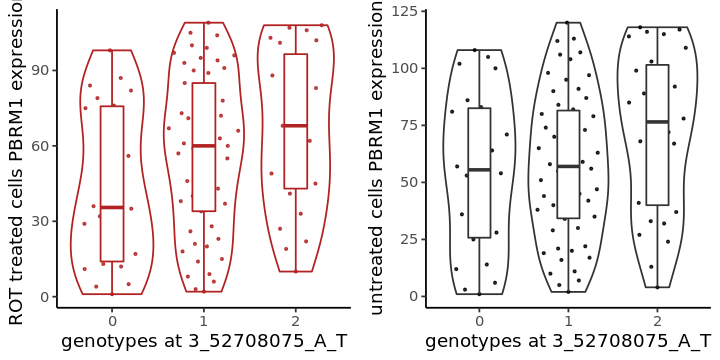

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

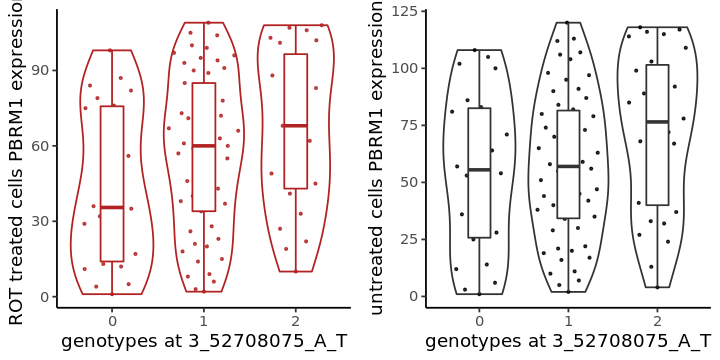

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

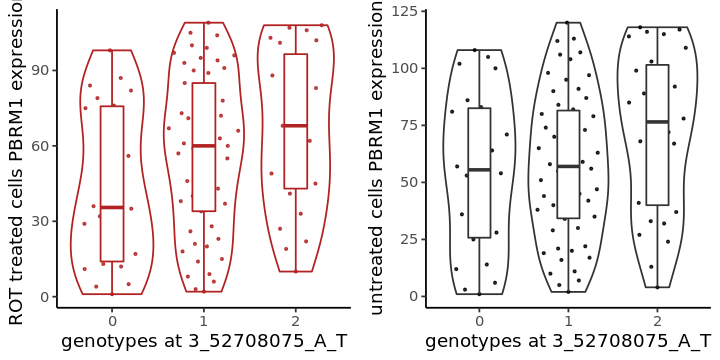

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

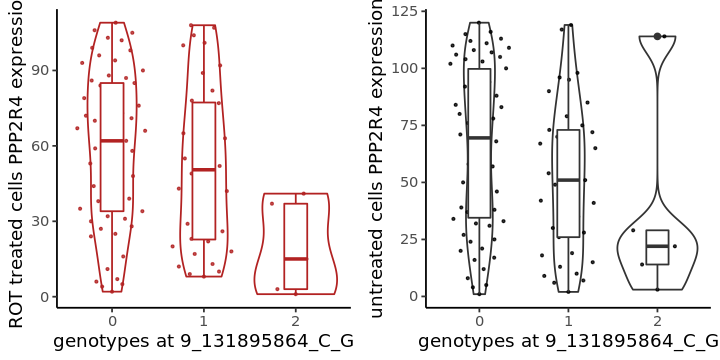

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

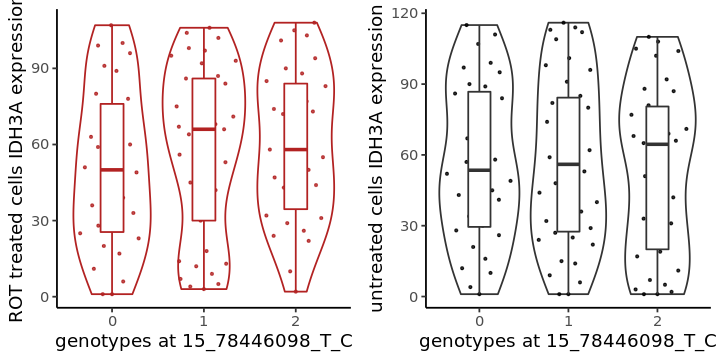

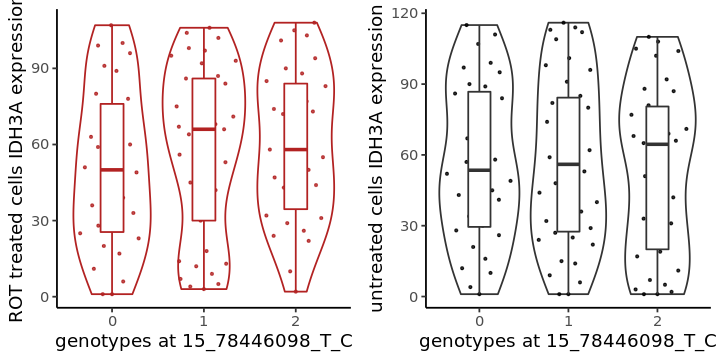

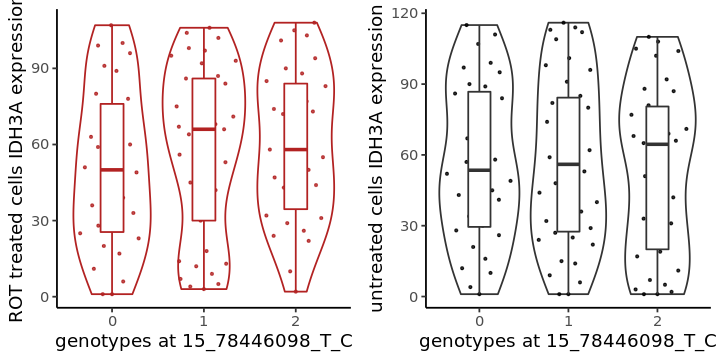

In [194]:
res = res[res[[grep("int",colnames(res))]]==1,]
e = e_Astro
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_treatment(gene,snp))
#     print(i)
}

In [ ]:
# maturation (no ROT cells)

In [202]:
res = int_DA2
res = add_gene_name(res,annos)
res = annotate_int(res,"DA","maturation")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

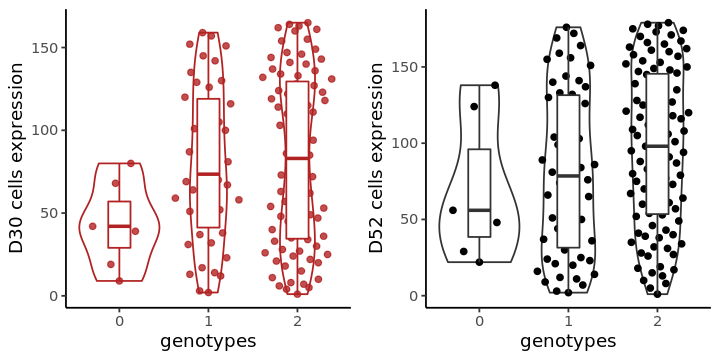

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

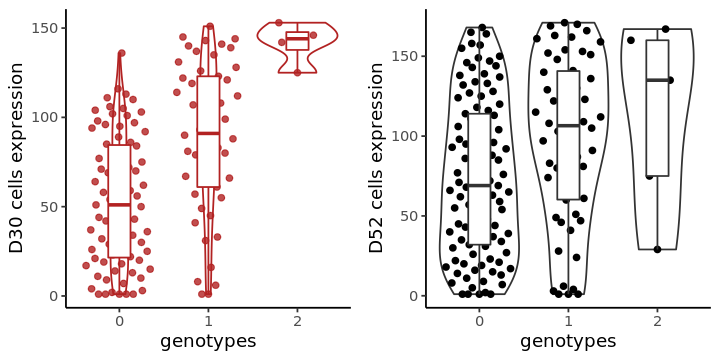

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

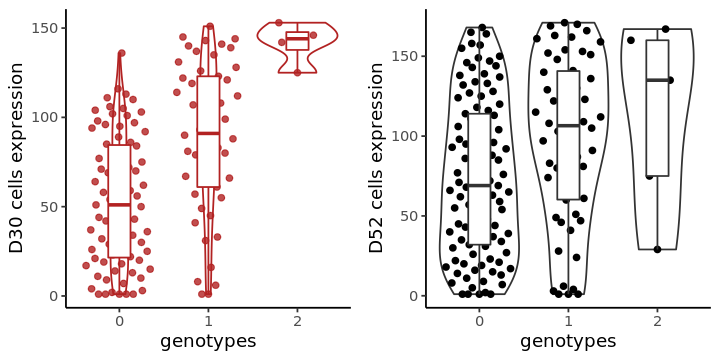

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

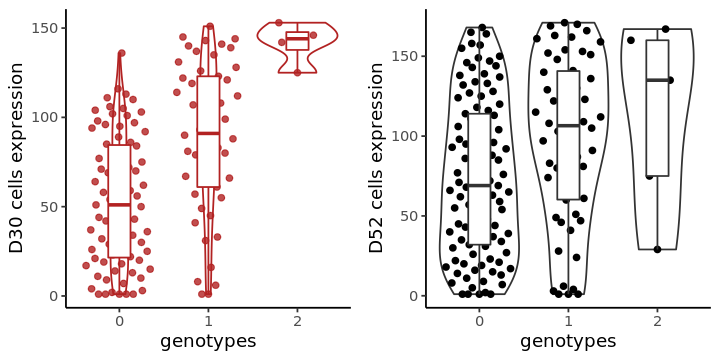

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

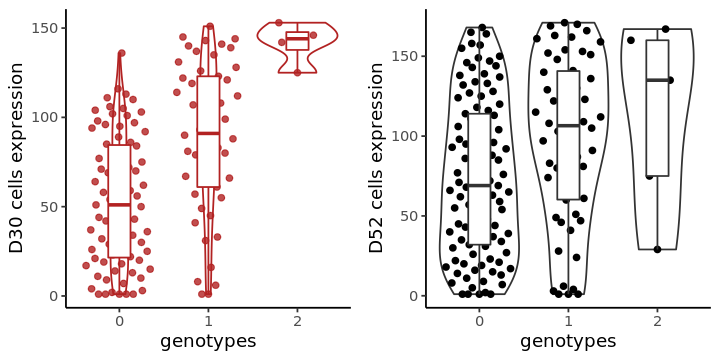

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

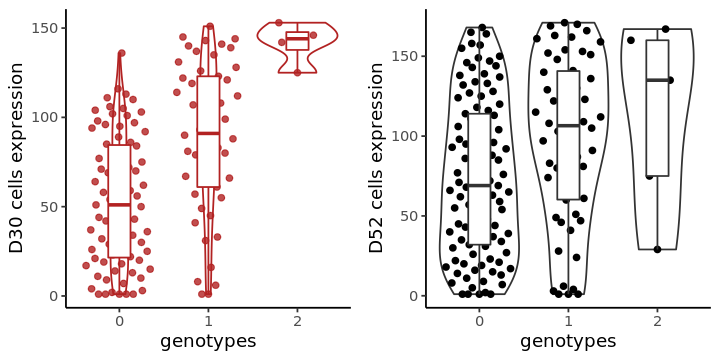

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

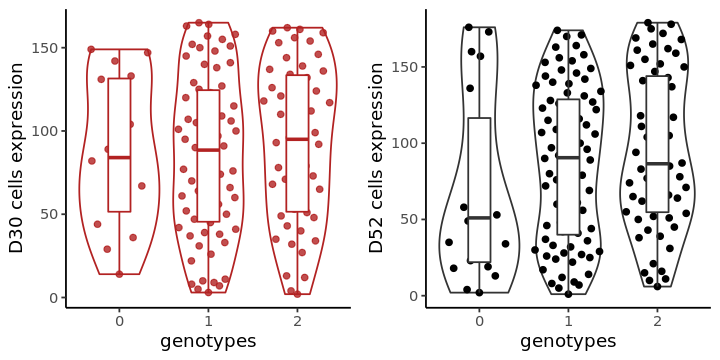

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

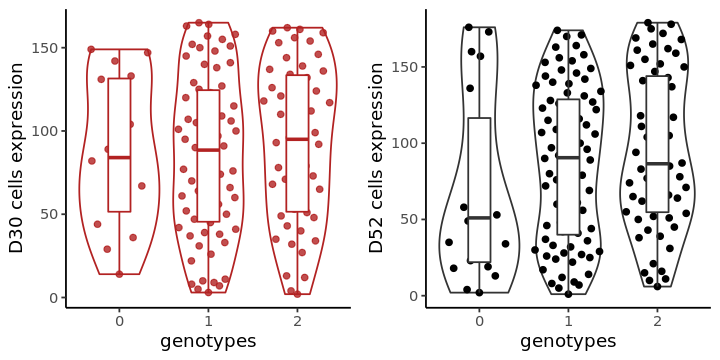

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

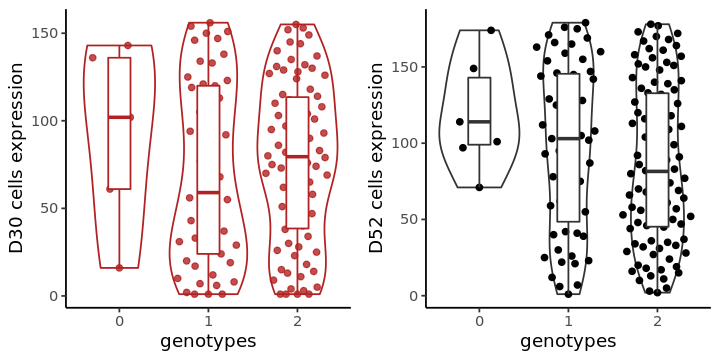

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

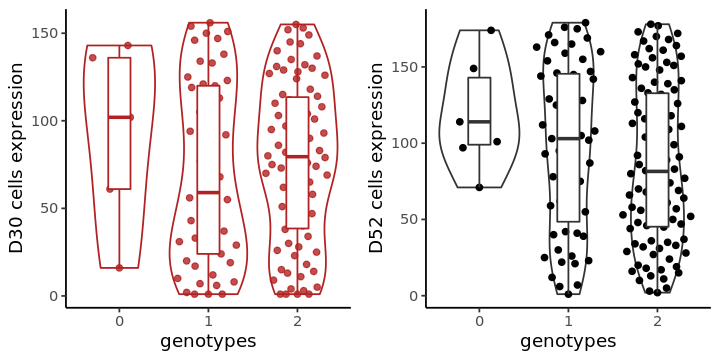

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

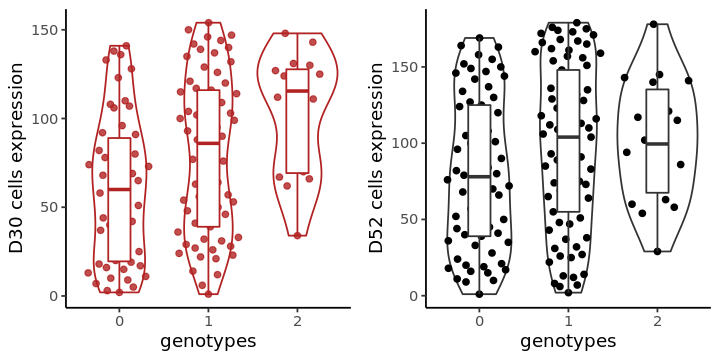

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

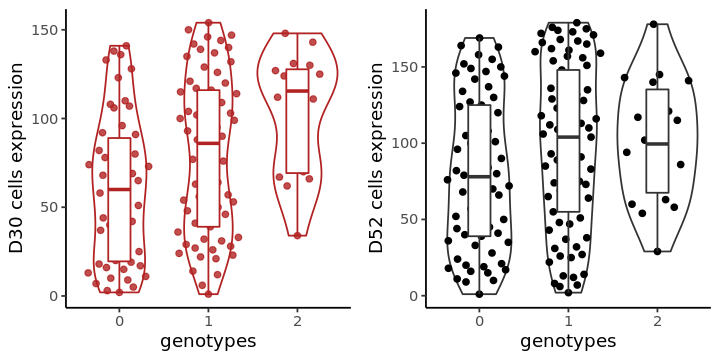

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

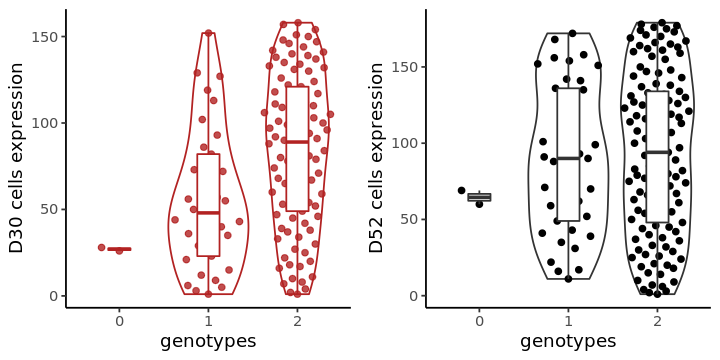

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

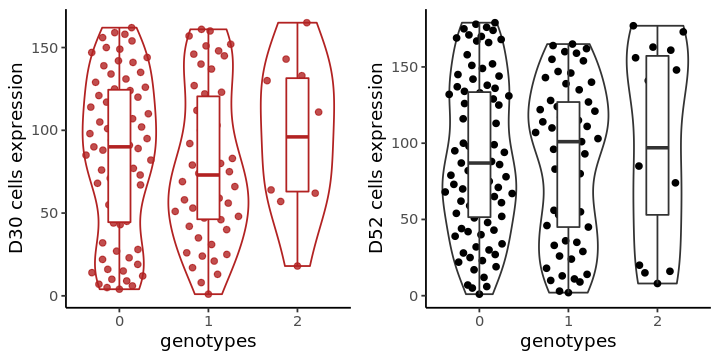

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

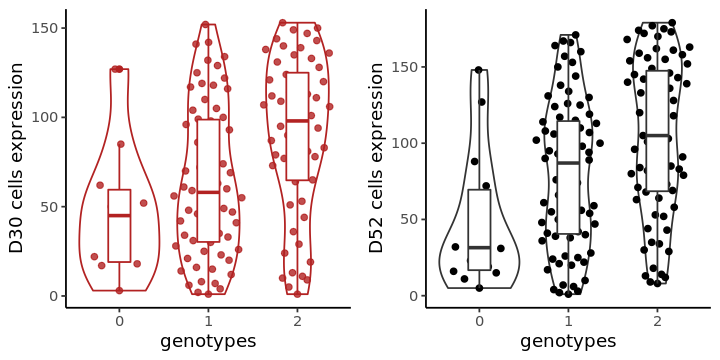

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

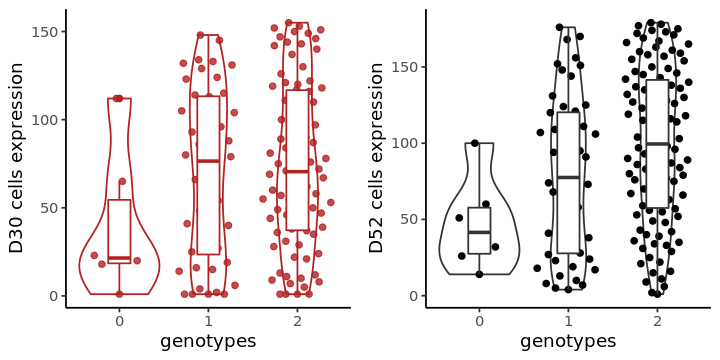

In [ ]:
res = res[res[[grep("int",colnames(res))]]==1,]
e_D30 = read.csv(paste0(mydir,DA_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,DA_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_timepoint(gene,snp))
#     print(i)
}

In [299]:
res = int_Sert2
res = add_gene_name(res,annos)
res = annotate_int(res,"Sert","maturation")
res = add_coloc_results(res,coloc)
res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_maturation_Sert,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
22_42926188_G_T,1.159070e-07,0.9690756,0.18285012,-1,22,42949623,42970388,170,170,⋯,ENSG00000183569_SERHL2,SERHL2,1,SERHL2,N,College or University degree | Qualifications,pool1_17_D52.DA,Brain_Cerebellum,Heart_Left_Ventricle,
22_39064806_A_C,1.447728e-06,0.5104236,0.10593396,-1,22,39052641,39069859,170,170,⋯,ENSG00000100211_CBY1,CBY1,1,CBY1,N-O,Depressed affect,pool1_13_noddd_D30.DA,Brain_Spinal_cord_cervical_c-1,Colon_Sigmoid,
5_176799992_T_C,3.429786e-06,-0.4621321,0.09952781,-1,5,176784838,176799602,170,170,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,Cognitive performance,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,
5_176799992_T_C,3.429786e-06,-0.4621321,0.09952781,-1,5,176784838,176799602,170,170,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,A levels/AS levels or equivalent | Qualifications,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,
11_47835721_A_C,1.386333e-05,-0.5015451,0.11540345,-1,11,47487496,47587121,170,170,⋯,ENSG00000149187_CELF1,CELF1,1,CELF1,N-O,Depressed affect,pool1_17_D52.DA,Brain_Cortex,Minor_Salivary_Gland,
11_47835721_A_C,1.386333e-05,-0.5015451,0.11540345,-1,11,47487496,47587121,170,170,⋯,ENSG00000149187_CELF1,CELF1,1,CELF1,N-O,Nervous feelings,pool1_17_D52.DA,Brain_Hypothalamus,Nerve_Tibial,
9_131895864_C_G,5.237221e-05,0.4050798,0.10014878,-1,9,131873229,131911225,170,170,⋯,ENSG00000119383_PPP2R4,PPP2R4,1,PPP2R4,N-B-O,Cognitive performance,pool1_17_D52.Epen1,Brain_Cerebellar_Hemisphere,Pancreas,
2_220345117_T_G,7.829730e-05,-0.5217574,0.13210544,-1,2,220299568,220363009,170,170,⋯,ENSG00000072195_SPEG,SPEG,1,SPEG,N-B-O,Cognitive performance,pool1_17_D52.Sert,Brain_Cerebellar_Hemisphere,Pituitary,
5_81570394_G_A,1.482395e-04,0.1562880,0.04119345,-1,5,81569177,81574396,170,170,⋯,ENSG00000186468_RPS23,RPS23,1,RPS23,N,Cognitive performance,pool1_13_noddd_D30.DA,Brain_Cortex,Whole_Blood,


Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

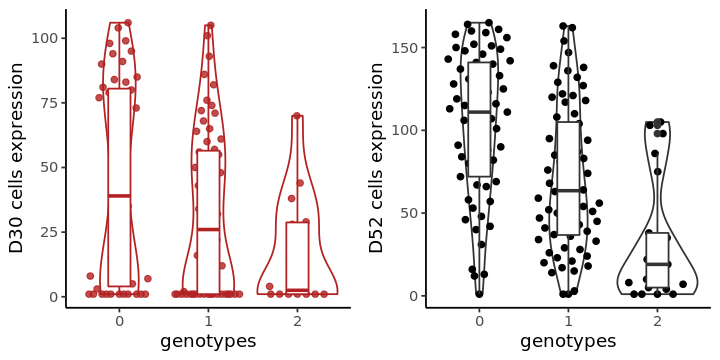

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

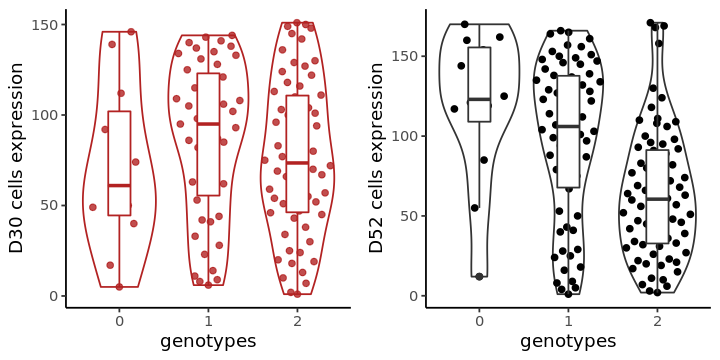

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

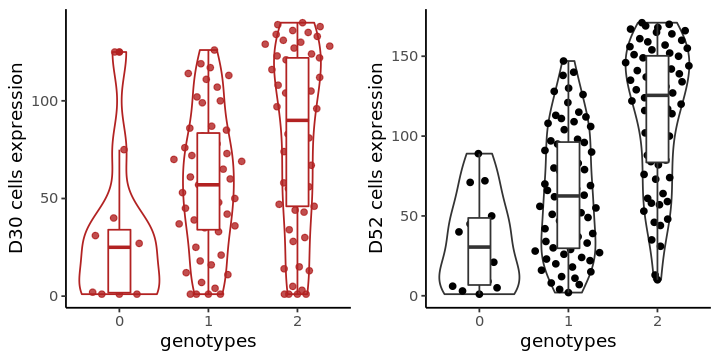

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

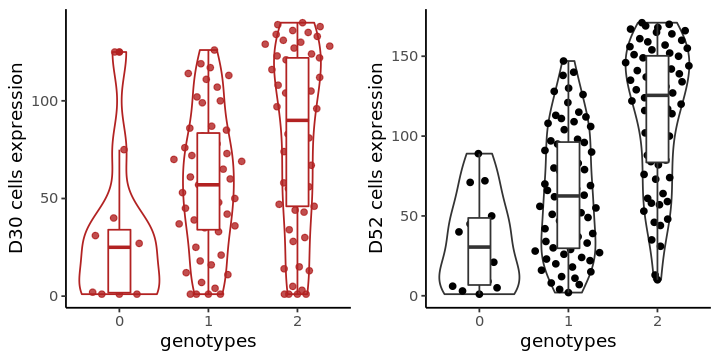

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

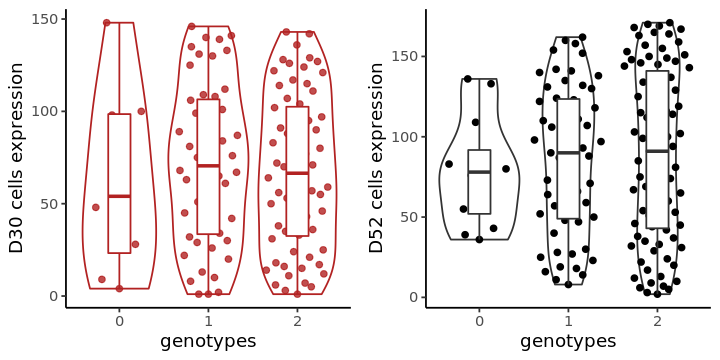

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

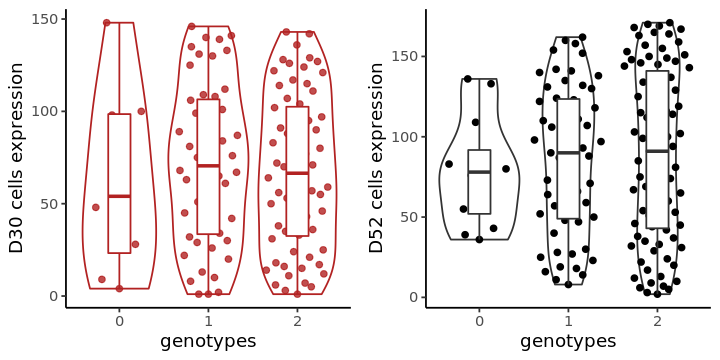

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

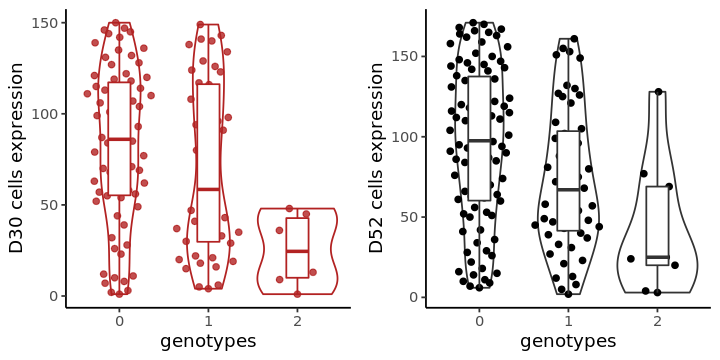

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

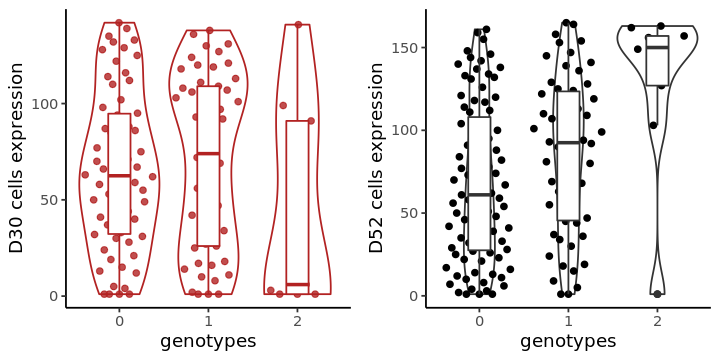

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

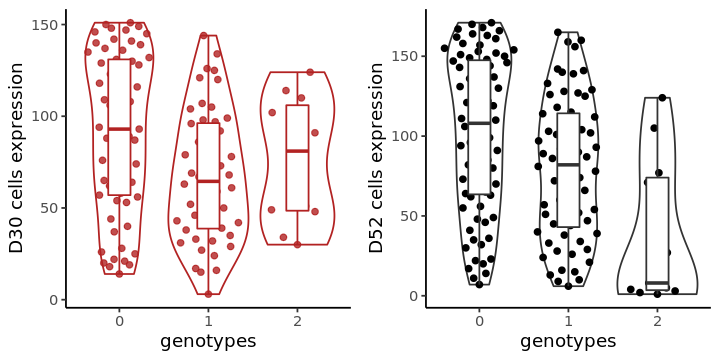

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

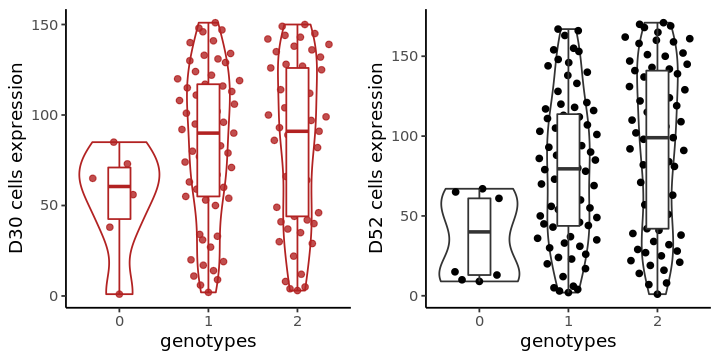

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

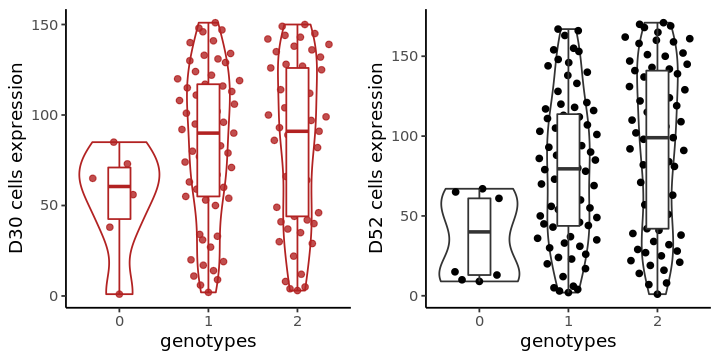

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

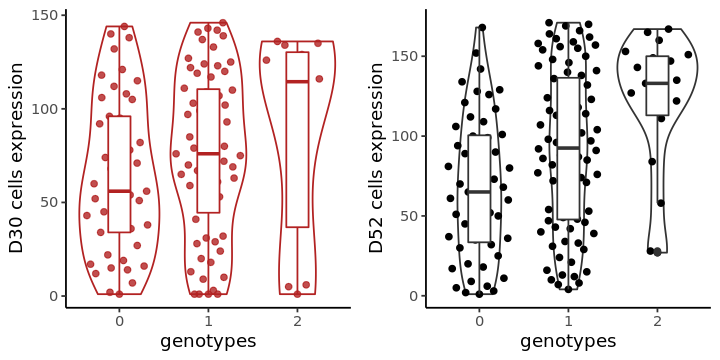

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

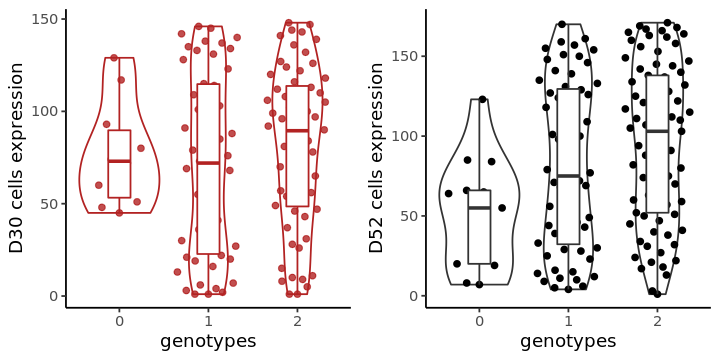

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

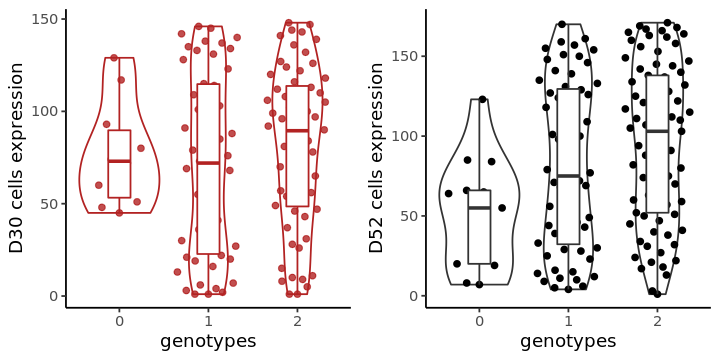

ERROR: Error in names(x) <- value: 'names' attribute [2] must be the same length as the vector [1]


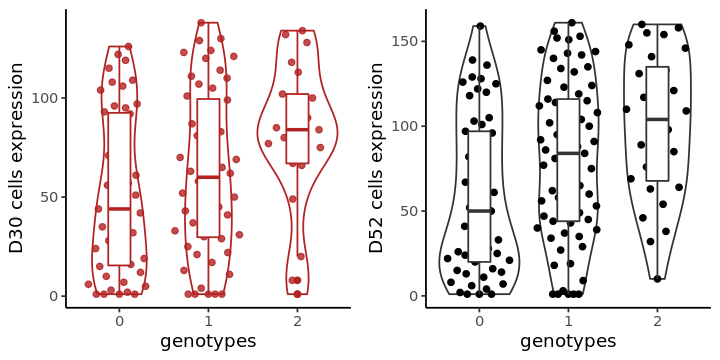

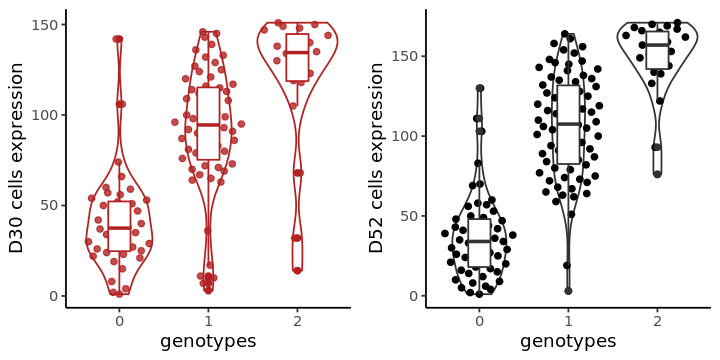

In [205]:
res = res[res[[grep("int",colnames(res))]]==1,]
e_D30 = read.csv(paste0(mydir,Sert_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Sert_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_timepoint(gene,snp))
#     print(i)
}

In [ ]:
res = int_Epen1.2
res = add_gene_name(res,annos)
res = annotate_int(res,"Epen","maturation")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

In [ ]:
res = res[res[[grep("int",colnames(res))]]==1,]
e_D30 = read.csv(paste0(mydir,Epen1_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Epen1_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_timepoint(gene,snp))
#     print(i)
}

In [ ]:
res = int_Astro2
res = add_gene_name(res,annos)
res = annotate_int(res,"Astro","maturation")
res = add_coloc_results(res,coloc)
# res[res[[grep("int",colnames(res))]]==1,]

In [ ]:
res = res[res[[grep("int",colnames(res))]]==1,]
e_D30 = read.csv(paste0(mydir,Astro_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,Astro_D52),sep="\t")
rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id
for (i in 1:nrow(res)){
    snp = res[i,"snp_id"]
    gene = res[i,"Gene"]
    print(Boxplot_timepoint(gene,snp))
#     print(i)
}

In [ ]:
# maturation (including all D52 cells, treated and untreated)

In [149]:
res = int_DA3
res = add_gene_name(res,annos)
res = annotate_int(res,"DA","maturation")
res = add_coloc_results(res,coloc)
res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_maturation_DA,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
5_176799992_T_C,1.358148e-10,-0.5135348,0.07998344,-1,5,176784838,176799602,230,230,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,Cognitive performance,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,
5_176799992_T_C,1.358148e-10,-0.5135348,0.07998344,-1,5,176784838,176799602,230,230,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,A levels/AS levels or equivalent | Qualifications,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,
17_15870401_T_A,9.653043e-06,-0.3100911,0.07008021,-1,17,15879874,15903031,230,230,⋯,ENSG00000214941_ZSWIM7,ZSWIM7,1,ZSWIM7,N-B-O,PD,pool1_17_D52.Astro,Brain_Cerebellar_Hemisphere,Vagina,
17_7207964_A_C,1.910629e-05,-0.2078629,0.04862192,-1,17,7210318,7215774,230,230,⋯,ENSG00000132507_EIF5A,EIF5A,1,EIF5A,N-B-O,A levels/AS levels or equivalent | Qualifications,pool1_17_D52.Sert,Brain_Cerebellum,Spleen,
1_201800582_T_G,3.117053e-05,-0.2430861,0.05836763,-1,1,201857808,201861434,230,230,⋯,ENSG00000198892_SHISA4,SHISA4,1,SHISA4,N,Depressed affect,pool1_13_noddd_D11.FPP,Brain_Cortex,Adipose_Visceral_Omentum,
1_201800582_T_G,3.117053e-05,-0.2430861,0.05836763,-1,1,201857808,201861434,230,230,⋯,ENSG00000198892_SHISA4,SHISA4,1,SHISA4,N-O,Sleeplessness / insomnia,pool1_13_noddd_D11.FPP,Brain_Hypothalamus,Lung,
2_206356524_A_G,4.946589e-05,0.4309694,0.10619885,-1,2,206546714,206662857,230,230,⋯,ENSG00000118257_NRP2,NRP2,1,NRP2,N,Neuroticism,pool1_17_D52.Sert,Brain_Hippocampus,Adipose_Subcutaneous,
3_49518299_A_G,4.823211e-05,-0.2581364,0.06351731,-1,3,49394609,49396033,230,230,⋯,ENSG00000233276_GPX1,GPX1,1,GPX1,N,A levels/AS levels or equivalent | Qualifications,pool1_17_D52.Epen1,Brain_Cerebellar_Hemisphere,Cells_EBV-transformed_lymphocytes,
3_49518299_A_G,4.823211e-05,-0.2581364,0.06351731,-1,3,49394609,49396033,230,230,⋯,ENSG00000233276_GPX1,GPX1,1,GPX1,N-B,Educational attainment,pool1_17_D52.Sert,Brain_Anterior_cingulate_cortex_BA24,Liver,Not really


In [150]:
res = int_Sert3
res = add_gene_name(res,annos)
res = annotate_int(res,"Sert","maturation")
res = add_coloc_results(res,coloc)
res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_maturation_Sert,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
22_42926188_G_T,5.202263e-07,0.8405939,0.16749240,-1,22,42949623,42970388,192,192,⋯,ENSG00000183569_SERHL2,SERHL2,1,SERHL2,N,College or University degree | Qualifications,pool1_17_D52.DA,Brain_Cerebellum,Heart_Left_Ventricle,
17_15875147_G_A,1.239460e-06,-0.3374350,0.06958538,-1,17,15879874,15903031,192,192,⋯,ENSG00000214941_ZSWIM7,ZSWIM7,1,ZSWIM7,N-B-O,PD,pool1_17_D52.Astro,Brain_Cerebellar_Hemisphere,Vagina,
7_7922654_A_G,2.771984e-06,0.7020693,0.14978980,-1,7,7680342,8043689,192,192,⋯,ENSG00000219545_RPA3-AS1,RPA3-AS1,1,RPA3-AS1,N,"Other professional qualifications eg: nursing, teaching | Qualifications",pool1_13_noddd_D11.FPP,Brain_Cortex,Artery_Coronary,
10_104217441_A_G,3.551777e-06,-0.5107481,0.11016947,-1,10,104209594,104211300,192,192,⋯,ENSG00000120055_C10orf95,C10orf95,1,C10orf95,N,SCZ2,pool1_13_noddd_D30.Sert,Brain_Spinal_cord_cervical_c-1,Esophagus_Mucosa,
3_49597230_C_G,4.264989e-06,-0.2925469,0.06362436,-1,3,49394609,49396033,192,192,⋯,ENSG00000233276_GPX1,GPX1,1,GPX1,N,A levels/AS levels or equivalent | Qualifications,pool1_17_D52.Epen1,Brain_Cerebellar_Hemisphere,Cells_EBV-transformed_lymphocytes,
3_49597230_C_G,4.264989e-06,-0.2925469,0.06362436,-1,3,49394609,49396033,192,192,⋯,ENSG00000233276_GPX1,GPX1,1,GPX1,N-B,Educational attainment,pool1_17_D52.Sert,Brain_Anterior_cingulate_cortex_BA24,Liver,Not really
9_131895864_C_G,1.046961e-05,0.4096825,0.09295670,-1,9,131873229,131911225,192,192,⋯,ENSG00000119383_PPP2R4,PPP2R4,1,PPP2R4,N-B-O,Cognitive performance,pool1_17_D52.Epen1,Brain_Cerebellar_Hemisphere,Pancreas,
5_176799992_T_C,1.104946e-05,-0.4263402,0.09699369,-1,5,176784838,176799602,192,192,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,Cognitive performance,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,
5_176799992_T_C,1.104946e-05,-0.4263402,0.09699369,-1,5,176784838,176799602,192,192,⋯,ENSG00000169220_RGS14,RGS14,1,RGS14,N,A levels/AS levels or equivalent | Qualifications,pool1_13_noddd_D30.Epen1,Brain_Caudate_basal_ganglia,Cells_EBV-transformed_lymphocytes,


In [151]:
res = int_Epen1.3
res = add_gene_name(res,annos)
res = annotate_int(res,"Epen1","maturation")
res = add_coloc_results(res,coloc)
res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_maturation_Epen1,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
14_55619611_G_C,2.054971e-10,-0.7431069,0.11689262,-1,14,55614830,55658396,174,174,⋯,ENSG00000126787_DLGAP5,DLGAP5,1,DLGAP5,N-O,Sleeplessness / insomnia,pool1_13_noddd_D30.Epen1,Brain_Amygdala,Skin_Sun_Exposed_Lower_leg,
5_64861271_G_C,2.300188e-10,0.5715796,0.09015693,-1,5,64813593,64858998,174,174,⋯,ENSG00000123219_CENPK,CENPK,1,CENPK,N-B-O,Tense / 'highly strung',pool1_13_noddd_D11.FPP,Brain_Hippocampus,Whole_Blood,
1_155023634_G_A,1.358092e-09,-0.7661501,0.12641971,-1,1,155023042,155035252,174,174,⋯,ENSG00000143537_ADAM15,ADAM15,1,ADAM15,N,PD,pool1_13_noddd_D30.Sert,Brain_Spinal_cord_cervical_c-1,Heart_Atrial_Appendage,
5_176898619_T_C,5.333827e-05,-0.1999382,0.04948358,-1,5,176883609,176901402,174,174,⋯,ENSG00000113758_DBN1,DBN1,1,DBN1,N-O,Cognitive performance,pool1_17_D52.Sert,Brain_Cortex,Whole_Blood,
5_176898619_T_C,5.333827e-05,-0.1999382,0.04948358,-1,5,176883609,176901402,174,174,⋯,ENSG00000113758_DBN1,DBN1,1,DBN1,N-O,College or University degree | Qualifications,pool1_13_noddd_D30.Astro,Brain_Cortex,Liver,
5_176898619_T_C,5.333827e-05,-0.1999382,0.04948358,-1,5,176883609,176901402,174,174,⋯,ENSG00000113758_DBN1,DBN1,1,DBN1,N-O,A levels/AS levels or equivalent | Qualifications,pool1_13_noddd_D30.Astro,Brain_Cortex,Whole_Blood,
17_44344239_A_T,1.114803e-04,0.5419932,0.14026222,-1,17,44107282,44302733,174,174,⋯,ENSG00000120071_KANSL1,KANSL1,1,KANSL1,N,Neuroticism score,pool1_17_D52.Sert,Brain_Substantia_nigra,Uterus,
17_44344239_A_T,1.114803e-04,0.5419932,0.14026222,-1,17,44107282,44302733,174,174,⋯,ENSG00000120071_KANSL1,KANSL1,1,KANSL1,N-O,Educational attainment,pool1_13_noddd_D30.Sert,Brain_Substantia_nigra,Cells_Transformed_fibroblasts,
9_85596321_T_C,1.304276e-04,0.4779795,0.12494075,-1,9,85594500,85678092,174,174,⋯,ENSG00000165105_RASEF,RASEF,1,RASEF,N-O,Worrier / anxious feelings,pool1_17_D52.DA,Brain_Anterior_cingulate_cortex_BA24,Artery_Aorta,


In [152]:
res = int_Astro3
res = add_gene_name(res,annos)
res = annotate_int(res,"Astro","maturation")
res = add_coloc_results(res,coloc)
res[res[[grep("int",colnames(res))]]==1,]

Warning message:
“Column `feature_id` joining factors with different levels, coercing to character vector”Warning message:
“Column `Gene` joining factors with different levels, coercing to character vector”

snp_id,p_value,beta,beta_se,empirical_feature_p_value,feature_chromosome,feature_start,feature_end,n_samples,n_e_samples,⋯,combined_feature_id,hgnc_symbol,int_maturation_Astro,Gene,Category,GWAS,NeuroSeqCell,BrainTissue,OtherTissue,X
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<int>,<int>,⋯,<fct>,<fct>,<dbl>,<chr>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
14_55619611_G_C,8.517314e-07,-0.7158853,0.14541278,-1,14,55614830,55658396,158,158,⋯,ENSG00000126787_DLGAP5,DLGAP5,1,DLGAP5,N-O,Sleeplessness / insomnia,pool1_13_noddd_D30.Epen1,Brain_Amygdala,Skin_Sun_Exposed_Lower_leg,
16_30134656_T_C,7.382288e-05,-0.4133005,0.10427359,-1,16,30125426,30134827,158,158,⋯,ENSG00000102882_MAPK3,MAPK3,1,MAPK3,N-O,SCZ2,pool1_13_noddd_D30.Astro,Brain_Anterior_cingulate_cortex_BA24,Cells_Transformed_fibroblasts,
15_43810916_G_C,2.120008e-04,0.3863243,0.10429163,-1,15,43661419,43699293,158,158,⋯,ENSG00000137822_TUBGCP4,TUBGCP4,1,TUBGCP4,N-B-O,Tense / 'highly strung',pool1_17_D52.Sert,Brain_Anterior_cingulate_cortex_BA24,Nerve_Tibial,
22_42926188_G_T,2.869916e-04,0.5545689,0.15290998,-1,22,42949623,42970388,158,158,⋯,ENSG00000183569_SERHL2,SERHL2,1,SERHL2,N,College or University degree | Qualifications,pool1_17_D52.DA,Brain_Cerebellum,Heart_Left_Ventricle,
16_68387341_C_T,8.459444e-04,-0.4648468,0.13928799,-1,16,68344877,68392466,158,158,⋯,ENSG00000132600_PRMT7,PRMT7,1,PRMT7,N-B-O,Cognitive performance,pool1_13_noddd_D30.Sert,Brain_Amygdala,Pituitary,
18_20951067_T_C,1.013522e-03,-0.2993381,0.09107430,-1,18,21032787,21066567,158,158,⋯,ENSG00000101782_RIOK3,RIOK3,1,RIOK3,N,Educational attainment,pool1_13_noddd_D30.DA,Brain_Hippocampus,Artery_Tibial,
8_11098996_T_C,1.059711e-03,0.5143994,0.15710813,-1,8,11141925,11185646,158,158,⋯,ENSG00000104643_MTMR9,MTMR9,1,MTMR9,N-B,Nervous feelings,pool1_13_noddd_D11.P_FPP,Brain_Putamen_basal_ganglia,Liver,Not really
8_11098996_T_C,1.059711e-03,0.5143994,0.15710813,-1,8,11141925,11185646,158,158,⋯,ENSG00000104643_MTMR9,MTMR9,1,MTMR9,N-O,Neuroticism,pool1_17_D52.DA,Brain_Cerebellum,Heart_Atrial_Appendage,
8_11098996_T_C,1.059711e-03,0.5143994,0.15710813,-1,8,11141925,11185646,158,158,⋯,ENSG00000104643_MTMR9,MTMR9,1,MTMR9,N-O,Neuroticism,pool1_17_D52.Epen1,Brain_Cerebellum,Thyroid,


In [1]:
# plot interactions
# boxplot

In [314]:
genos = read.table("/hps/nobackup/hipsci/scratch/genotypes/imputed/2017-03-27/Anna_selection_2020/neuroseq_Jan27.dosages.txt")

In [102]:
head(genos)

,HPSI0514i.sohd_2,HPSI0115i.zihe_1,HPSI1014i.eesb_1,HPSI0913i.eika_2,HPSI0114i.lexy_2,HPSI1014i.quls_2,HPSI0514i.yewo_4,HPSI0314i.bubh_3,HPSI0714i.burb_1,HPSI0314i.xugn_2,⋯,HPSI0413i.nudd_1,HPSI0513i.pedc_1,HPSI0513i.dulv_1,HPSI0813i.peoj_1,HPSI0413i.yotv_2,HPSI0513i.dipe_1,HPSI0613i.bawa_1,HPSI0813i.aizi_3,HPSI0613i.hikj_2,HPSI0513i.momt_2
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
13_21085751_A_T,0.902,0.935,0.387,0,0.357,0.005,0.019,0.681,0.605,0.768,⋯,0.025,0.313,0.008,1.027,0.004,0.028,0.896,0.929,0.016,0.944
13_21088717_T_C,0.914,0.947,0.671,0,0.336,0.015,0.001,0.962,0.609,0.783,⋯,0.011,0.312,0.003,1.014,0.000,0.018,0.977,0.940,0.007,0.993
13_21131211_C_A,0.731,0.005,1.112,1,0.996,0.992,1.033,0.999,0.006,1.006,⋯,1.994,1.000,0.003,0.002,0.966,1.027,0.998,0.000,0.996,0.005
13_21151047_T_C,1.000,1.000,2.000,1,1.000,1.000,0.999,0.000,0.000,0.000,⋯,0.000,0.000,0.000,0.000,0.956,0.000,0.002,0.000,1.000,0.000
13_21200260_C_T,1.001,1.468,1.010,1,1.951,1.578,1.077,2.000,1.999,2.000,⋯,2.000,1.982,2.000,2.000,1.007,2.000,2.000,2.000,1.004,2.000
13_21258328_T_C,1.000,0.988,1.000,1,1.000,1.000,0.003,1.000,2.000,1.000,⋯,0.003,1.000,2.000,2.000,1.000,0.995,0.981,2.000,1.000,2.000


In [103]:
# treatment

In [ ]:
mydir = '/nfs/leia/research/stegle/dseaton/hipsci/singlecell_neuroseq/data/data_processed/'

In [ ]:
# DA 
DA = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.DA.groupedby.donor_id-celltype-treatment.mean.tsv'
# Sert 
Sert = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.Sert.groupedby.donor_id-celltype-treatment.mean.tsv'
# Epen1 
Epen1 = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.Epen1.groupedby.donor_id-celltype-treatment.mean.tsv'
# Astro 
Astro = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.Astro.groupedby.donor_id-celltype-treatment.mean.tsv'

In [106]:
e_DA = read.csv(paste0(mydir,DA),sep="\t")
# e_DA[1:5,1:10]

In [107]:
e_Sert = read.csv(paste0(mydir,Sert),sep="\t")
e_Epen1 = read.csv(paste0(mydir,Epen1),sep="\t")
e_Astro = read.csv(paste0(mydir,Astro),sep="\t")

In [127]:
# e = e_DA
# e = e_Sert
# e = e_Epen1
# e = e_Astro
e_ROT = e[e$treatment == "ROT",]
rownames(e_ROT) = e_ROT$donor_id
e_noROT = e[e$treatment == "NONE",]
rownames(e_noROT) = e_noROT$donor_id

In [128]:
e_ROT[1:5,1:10]

,donor_id,celltype,treatment,n_cells,AL627309.1,AP006222.2,RP11.206L10.3,RP11.206L10.9,LINC00115,FAM41C
,<fct>,<fct>,<fct>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HPSI0114i-bezi_3,HPSI0114i-bezi_3,Epen1,ROT,40,0.008519979,0.4374509,0.000000000,0.013065382,0.01737731,0.015050118
HPSI0114i-eipl_1,HPSI0114i-eipl_1,Epen1,ROT,1972,0.011500618,0.3406319,0.016847575,0.004879923,0.02446014,0.013520923
HPSI0114i-fikt_3,HPSI0114i-fikt_3,Epen1,ROT,30,0.000000000,0.1374676,0.000000000,0.010500252,0.00000000,0.009721112
HPSI0114i-kolf_2,HPSI0114i-kolf_2,Epen1,ROT,111,0.008403911,0.5538098,0.002005749,0.020699091,0.02539819,0.035337172
HPSI0114i-lexy_2,HPSI0114i-lexy_2,Epen1,ROT,28,0.000000000,0.2620062,0.000000000,0.000000000,0.00000000,0.000000000


In [129]:
e1 = e_ROT[,colnames(e_ROT) == gene]
# e1
# gene expression (untreated cells)
e2 = e_noROT[,colnames(e_noROT) == gene]
# make dataframes
df_e1 = as.data.frame(cbind(e1,rownames(e_ROT))) 
df_e2 = as.data.frame(cbind(e2,rownames(e_noROT))) 
colnames(df_e1) <- c("exprs","samples")
colnames(df_e2) <- c("exprs","samples")
nrow(df_e1)

[1] 165

In [312]:
Boxplot_treatment <- function(gene, snp, genos, e_ROT, e_noROT){
    # genotypes
    geno = genos[rownames(genos) == snp,]
    # gene expression (treated cells)
    e1 = e_ROT[,colnames(e_ROT) == gene]
    # gene expression (untreated cells)
    e2 = e_noROT[,colnames(e_noROT) == gene]
    # make dataframes
    df_e1 = as.data.frame(cbind(e1,rownames(e_ROT))) 
    df_e2 = as.data.frame(cbind(e2,rownames(e_noROT))) 
    df_g = as.data.frame(cbind(t(geno),colnames(geno))) 
    #
    colnames(df_e1) <- c("exprs","samples")
    colnames(df_e2) <- c("exprs","samples")
    colnames(df_g) <- c("dosages","samples")
    df_g$samples <- gsub("\\.","-",df_g$samples)
    #
    df1 <- inner_join(df_e1,df_g, by = "samples")
    df1 <- dplyr::mutate(df1, genotypes = round(as.numeric(as.character(dosages))))
    df2 <- inner_join(df_e2,df_g, by = "samples")
    df2 <- dplyr::mutate(df2, genotypes = round(as.numeric(as.character(dosages))))
    # plot           
    p1 <- ggplot(df1, aes(x = as.factor(genotypes), y = as.numeric(exprs))) +
                geom_violin(col = "firebrick") +
                geom_quasirandom(col = "firebrick",alpha = 0.8, size = 0.5) +
                geom_boxplot(width = 0.25, col = "firebrick") + 
                labs(y=paste0("ROT treated cells ",gene," expression"), x = paste0("genotypes at ",snp)) +
                theme_classic()          
    p2 <- ggplot(df2, aes(x = as.factor(genotypes), y = as.numeric(exprs))) +
                geom_violin() +
                geom_quasirandom(alpha = 0.8, size = 0.5) +
                geom_boxplot(width = 0.25) + 
                labs(y=paste0("untreated cells ",gene," expression"), x = paste0("genotypes at ",snp)) +
                theme_classic()

    options(repr.plot.width=6, repr.plot.height=3)
    cowplot::plot_grid(p1, p2, align = "h", ncol = 2)    
}

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

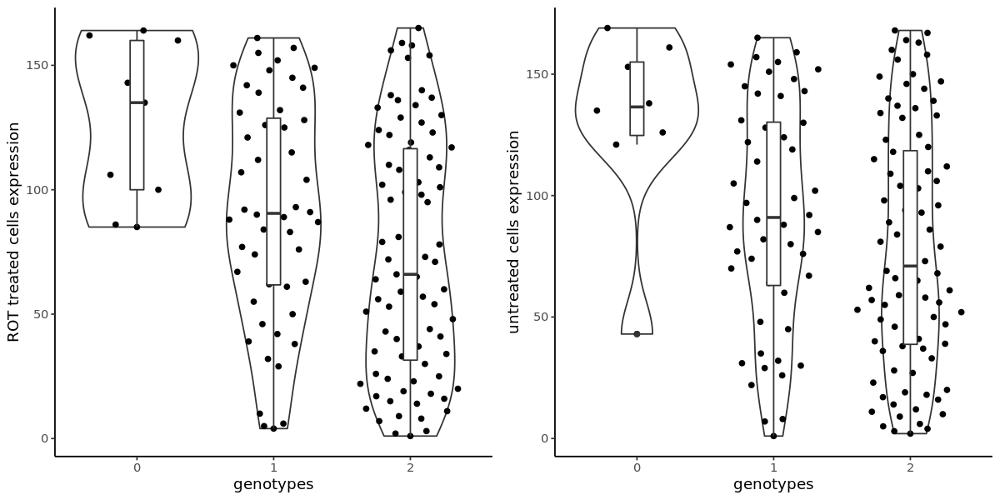

In [131]:
gene = "MRPS14" 
snp = "1_174995659_T_C" # DA D30
Boxplot_treatment(gene,snp)

In [112]:
# timepoint (maturation stage)

In [113]:
## DA
DA_D30 = 'pool1_13_noddd_D30/pool1_13_noddd_D30.scanpy.w_metadata.w_celltype.scanpy.celltype.DA.groupedby.donor_id-celltype.mean.tsv'
DA_D52 = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.DA.groupedby.donor_id-celltype.mean.tsv'

In [ ]:
## Sert
Sert_D30 = 'pool1_13_noddd_D30/pool1_13_noddd_D30.scanpy.w_metadata.w_celltype.scanpy.celltype.Sert.groupedby.donor_id-celltype.mean.tsv'
Sert_D52 = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.Sert.groupedby.donor_id-celltype.mean.tsv'

In [201]:
## Epen1
Epen1_D30 = 'pool1_13_noddd_D30/pool1_13_noddd_D30.scanpy.w_metadata.w_celltype.scanpy.celltype.Epen1.groupedby.donor_id-celltype.mean.tsv'
Epen1_D52 = 'pool1_17_D52/pool1_17_D52.scanpy.w_metadata.w_celltype.scanpy.celltype.Epen1.groupedby.donor_id-celltype.mean.tsv'

In [114]:
e_D30 = read.csv(paste0(mydir,DA_D30),sep="\t")
e_D52 = read.csv(paste0(mydir,DA_D52),sep="\t")

rownames(e_D30) = e_D30$donor_id
rownames(e_D52) = e_D52$donor_id

In [116]:
# gene expression (D30 cells)
e1 = e_D30[,colnames(e_D30) == gene]
# gene expression (D52 cells)
e2 = e_D52[,colnames(e_D52) == gene]
# make dataframes
df_e1 = as.data.frame(cbind(e1,rownames(e_D30))) 
df_e2 = as.data.frame(cbind(e2,rownames(e_D52))) 
colnames(df_e1) <- c("exprs","samples")
colnames(df_e2) <- c("exprs","samples")
# head(df_e1)

exprs,samples
<fct>,<fct>
0.227091044187546,HPSI0114i-bezi_3
0.218574732542038,HPSI0114i-eipl_1
0.178272947669029,HPSI0114i-kolf_2
0.248691231012344,HPSI0114i-lexy_2
0.170378997921944,HPSI0114i-posc_1
0.279007971286774,HPSI0114i-wegi_1


In [117]:
geno = genos[rownames(genos) == snp,]
df_g = as.data.frame(cbind(t(geno),colnames(geno)))
colnames(df_g) <- c("dosages","samples")
df_g$samples <- gsub("\\.","-",df_g$samples)
# head(df_g)

,dosages,samples
,<fct>,<chr>
HPSI0514i.sohd_2,1.823,HPSI0514i-sohd_2
HPSI0115i.zihe_1,2,HPSI0115i-zihe_1
HPSI1014i.eesb_1,1,HPSI1014i-eesb_1
HPSI0913i.eika_2,1.9959999,HPSI0913i-eika_2
HPSI0114i.lexy_2,2,HPSI0114i-lexy_2
HPSI1014i.quls_2,1.929,HPSI1014i-quls_2


In [118]:
df1 <- inner_join(df_e1,df_g, by = "samples")
head(df1)
df1 <- dplyr::mutate(df1, genotypes = round(as.numeric(as.character(dosages))))
head(df1)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

exprs,samples,dosages
<fct>,<chr>,<fct>
0.227091044187546,HPSI0114i-bezi_3,1.003
0.218574732542038,HPSI0114i-eipl_1,2
0.178272947669029,HPSI0114i-kolf_2,0.001
0.248691231012344,HPSI0114i-lexy_2,2
0.170378997921944,HPSI0114i-posc_1,1.9039999
0.279007971286774,HPSI0114i-wegi_1,1.9990001


exprs,samples,dosages,genotypes
<fct>,<chr>,<fct>,<dbl>
0.227091044187546,HPSI0114i-bezi_3,1.003,1
0.218574732542038,HPSI0114i-eipl_1,2,2
0.178272947669029,HPSI0114i-kolf_2,0.001,0
0.248691231012344,HPSI0114i-lexy_2,2,2
0.170378997921944,HPSI0114i-posc_1,1.9039999,2
0.279007971286774,HPSI0114i-wegi_1,1.9990001,2


In [326]:
Boxplot_timepoint <- function(gene, snp, genos, e_D30, e_D52){
    # genotypes
    geno = genos[rownames(genos) == snp,]
    # gene expression (D30 cells)
    e1 = e_D30[,colnames(e_D30) == gene]
    # gene expression (D52 cells)
    e2 = e_D52[,colnames(e_D52) == gene]
    # make dataframes
    df_e1 = as.data.frame(cbind(e1,rownames(e_D30))) 
    df_e2 = as.data.frame(cbind(e2,rownames(e_D52)))  
    df_g = as.data.frame(cbind(t(geno),colnames(geno))) 
    #
    colnames(df_e1) <- c("exprs","samples")
    colnames(df_e2) <- c("exprs","samples")
    colnames(df_g) <- c("dosages","samples")
    df_g$samples <- gsub("\\.","-",df_g$samples)
    #
    df1 <- inner_join(df_e1,df_g, by = "samples")
    df1 <- dplyr::mutate(df1, genotypes = round(as.numeric(as.character(dosages))))
    df2 <- inner_join(df_e2,df_g, by = "samples")
    df2 <- dplyr::mutate(df2, genotypes = round(as.numeric(as.character(dosages))))
    # plot  
    m = min(min(as.numeric(df1$exprs)),min(as.numeric(df2$exprs)))
    M = max(max(as.numeric(df1$exprs)),max(as.numeric(df2$exprs)))
    p1 <- ggplot(df1, aes(x = as.factor(genotypes), y = as.numeric(exprs))) +
                geom_violin(col = "cornflowerblue") + ylim(c(m,M)) +
                geom_quasirandom(col = "cornflowerblue", alpha = 0.8, size = 0.5) +
                geom_boxplot(width = 0.25, col = "cornflowerblue") + 
                labs(y=paste0("D30 cells expression of ",gene), x = paste0("genotypes at ",snp)) +
                theme_classic()          
    p2 <- ggplot(df2, aes(x = as.factor(genotypes), y = as.numeric(exprs))) +
                geom_violin(col = "darkblue") + ylim(c(m,M)) +
                geom_quasirandom(col = "darkblue", alpha = 0.8, size = 0.5) +
                geom_boxplot(width = 0.25, col = "darkblue") + 
                labs(y=paste0("D52 cells expression of ",gene), x = paste0("genotypes at ",snp)) +
                theme_classic()

    options(repr.plot.width=6, repr.plot.height=3)
    cowplot::plot_grid(p1, p2, align = "h", ncol = 2)    
}

In [51]:
annos[annos$feature_id == "ENSG00000165475",]

,feature_id,chromosome,start,end,hgnc_symbol,combined_feature_id,ensembl_gene_id
,<fct>,<fct>,<int>,<int>,<fct>,<fct>,<fct>
7833,ENSG00000165475,13,20977806,21099996,CRYL1,ENSG00000165475_CRYL1,ENSG00000165475


In [52]:
gene = "CRYL1"
snp = "13_21085751_A_T"

In [61]:
# library(dplyr)
# library(ggplot2)
library(ggbeeswarm)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

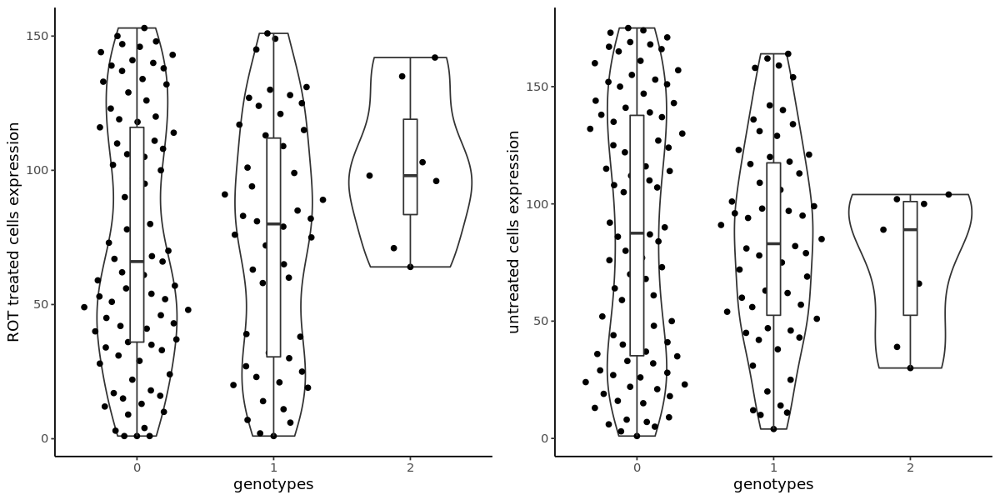

In [97]:
Boxplot_treatment(gene, snp)

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

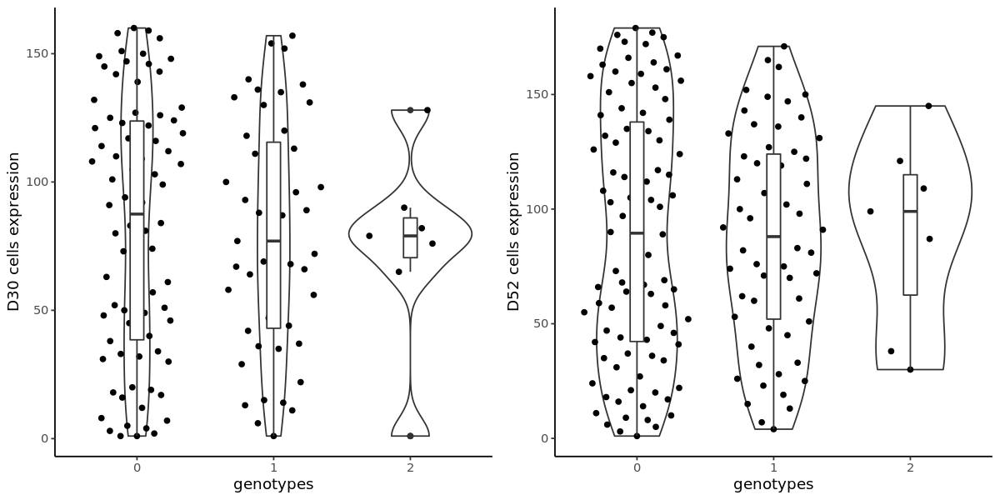

In [98]:
Boxplot_timepoint(gene, snp)

In [132]:
gene = "MRPS14" 
snp = "1_174836070_A_T" # DA D30

Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”Warning message:
“Column `samples` joining factor and character vector, coercing into character vector”

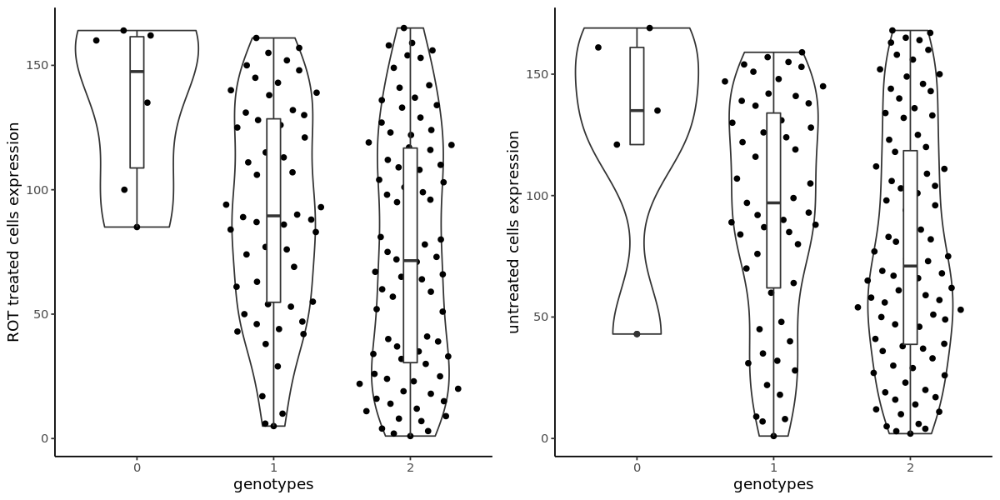

In [133]:
Boxplot_treatment(gene, snp)

In [ ]:
gene = "CCDC66"
snp = "3_56630166_C_T" # Epen1 D30

In [ ]:
gene = "N6AMT2"
# FPP D11 not an eQTL (FDR 10%)

In [ ]:
# 

In [ ]:
gene = "PREX1"
# DA D52 not an eQTL (FDR 10%)

In [ ]:
gene = "VPS41"
snp = "7_38816635_G_A" # Sert D52

In [ ]:
gene = "CCDC66"
snp = "3_56630166_C_T" # Epen1 D30

In [ ]:
gene = "NRP2"
snp = "2_206596663_T_C" # Sert D52

In [ ]:
gene = "FGFR1"
snp = "8_38290424_G_A" # P_FPP D11